In [17]:
!pip install pulp ortoolpy


[notice] A new release of pip is available: 24.0 -> 24.1.1
[notice] To update, run: python3 -m pip install --upgrade pip


In [18]:
import os
import copy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

#---------------------------------------------------------------------------------------------------------------
# MODULES
#---------------------------------------------------------------------------------------------------------------
def geography(left, right, bottom, top):
    resolution = 12
    nx, ny = (right - left)*resolution, (top - bottom)*resolution 
    rgnshape = (ny, nx)
    img_extent = (left, right, bottom, top)
    upperindex = (90-top)*resolution
    lowerindex = (90-bottom)*resolution
    leftindex = (180+left)*resolution
    rightindex = (180+right)*resolution
    return img_extent, rgnshape, upperindex, lowerindex, leftindex, rightindex

def l_coordinate_to_tuple(lcoordinate, a=2160, b=4320):
    lat_l = ((lcoordinate - 1) // b)
    lon_l = (lcoordinate) % b - 1
    return (lat_l, lon_l)

def nxtl2nxtxy(rgnfile, upperindex, leftindex):
    vfunc = np.vectorize(l_coordinate_to_tuple, otypes=[tuple])
    riv_nxtxy = np.empty(rgnfile.shape, dtype=tuple)
    mask = ~np.isnan(rgnfile)
    riv_nxtxy[mask] = vfunc(rgnfile[mask])
    riv_nxtxy_shape = (riv_nxtxy.shape[0], riv_nxtxy.shape[1], 2)
    
    riv_nxtxy_lst = []
    for row in riv_nxtxy:
        for y, x in row:
            modified_y = y - upperindex
            modified_x = x - leftindex
            riv_nxtxy_lst.append((modified_y, modified_x))

    riv_nxtxy_cropped = np.array(riv_nxtxy_lst).reshape(riv_nxtxy_shape)
    riv_nxtxy_cropped = riv_nxtxy_cropped.astype(int)
    return riv_nxtxy_cropped
    
def lonlat2xy(loncnt, latcnt, a=2160, b=4320):
    if -180 <= loncnt <=180:
        lon_middle = int(((loncnt+180)/360)*b )
        lat_middle = int(((90-latcnt)/180)*a ) 
    else:
        lon_middle = 1e20
        lat_middle = 1e20
    return lon_middle, lat_middle
    
def explore_prf(citymask, rivnum, elevation, rivara):
    """
    citymask:  g_mask_cropped,             city_mask
    rivnum:    g_rivnum_cropped_city,      city_mask内のrivnumデータ
    elevation: g_elv_cropped,              elevationデータ
    rivara:    g_rivara_cropped,           rivaraデータ
    """
    unique_values, counts = np.unique(rivnum.compressed(), return_counts=True)
    uid_dict = dict(zip(unique_values, counts))
    max_key = max(uid_dict, key=uid_dict.get)
    if max_key > 1:
        elv_indices = np.argwhere(rivnum == max_key)
        elv_values = [elevation[coord[0], coord[1]] for coord in elv_indices]
        elv_maxarg = np.argmax(elv_values)
        josui_coord = elv_indices[elv_maxarg]
        josui_array = np.zeros(rivnum.shape, dtype='float32')
        josui_array[josui_coord[0], josui_coord[1]] = max_key
        ara_indices = np.argwhere((citymask == 1) & (josui_array != rivnum[josui_coord[0], josui_coord[1]]))
        ara_values = [rivara[coord[0], coord[1]] for coord in ara_indices]
        if ara_values:
            ara_argmax = np.argmax(ara_values)
            gesui_coord = ara_indices[ara_argmax]
        else:
            print(f"ara_indices is empty -> argmin_elv for gesui")
            elv_minarg = np.argmax(elv_values)
            gesui_coord = elv_indices[elv_minarg]
    else:
        elv_indices = np.argwhere(citymask == 1)
        elv_values = [elevation[coord[0], coord[1]] for coord in elv_indices]
        elv_maxarg = np.argmax(elv_values)
        josui_coord = elv_indices[elv_maxarg]
        josui_array = np.zeros(rivnum.shape, dtype='float32')
        josui_array[josui_coord[0], josui_coord[1]] = rivnum[josui_coord[0], josui_coord[1]]
        ara_indices = np.argwhere((citymask == 1) & (josui_array != rivnum[josui_coord[0], josui_coord[1]]))
        ara_values = [rivara[coord[0], coord[1]] for coord in ara_indices]
        if ara_values:
            ara_argmax = np.argmax(ara_values)
            gesui_coord = ara_indices[ara_argmax]
        else:
            print(f"ara_indices is empty -> argmin_elv for gesui")
            elv_minarg = np.argmax(elv_values)
            gesui_coord = elv_indices[elv_minarg]
    gesui_array = np.ma.masked_all(rivnum.shape, dtype='float32')
    gesui_array[gesui_coord[0], gesui_coord[1]] = rivnum[gesui_coord[0], gesui_coord[1]]
    josui_array = np.ma.masked_all(rivnum.shape, dtype='float32')
    josui_array[josui_coord[0], josui_coord[1]] = rivnum[josui_coord[0], josui_coord[1]]
    return josui_array, gesui_array

#---------------------------------------------------------------------------------------------------------------
# Main function
#---------------------------------------------------------------------------------------------------------------

def explore(city_num, remove_grid, innercity_grid, left, right, bottom, top):
    """
    A: After over remove_grid process
    B: After over remove_grid process & over innercity_grid process
    C: After over remove_grid process & removed short mainriver but not related to citymask
    """
    img_extent, rgnshape, upperindex, lowerindex, leftindex, rightindex = geography(left, right, bottom, top)
    
    latgrd = 2160 # sum of latitude grids (y)
    longrd = 4320 # sum of longitude grids (x)

    # root directory
    root_dir = "/mnt/c/Users/tsimk/Downloads/dotfiles/h08/global_city"
    # city mask data
    cmsk_dir = f"{root_dir}/dat/vld_cty_/"
    elvmin_path = f"{root_dir}/dat/elv_min_/elevtn.CAMA.gl5"
    pop_path = f"{root_dir}/dat/pop_tot_/GPW4ag__20100000.gl5"
    # riv data
    rivnum_path = f"{root_dir}/dat/riv_num_/rivnum.CAMA.gl5"
    rivara_path = f"{root_dir}/dat/riv_ara_/rivara.CAMA.gl5"
    rivnxl_path = f"{root_dir}/dat/riv_nxl_/rivnxl.CAMA.gl5"
    rivout_path = f"{root_dir}/dat/riv_out_/W5E5LR__20190000.gl5"
    # fcl_path
    josui_path = f"{root_dir}/dat/fcl_obs_/jyousui_20240425.csv"

    #---------------------------------------------------------------------------------------------------------------
    g_mask = np.fromfile(f'{cmsk_dir}/city_{city_num:08d}.gl5', 'float32').reshape(latgrd, longrd)
    g_mask = np.ma.masked_where(g_mask >= 1E20, g_mask)
    g_mask_cropped = g_mask[upperindex:lowerindex, leftindex:rightindex]
    
    g_pop = np.fromfile(pop_path, 'float32').reshape(latgrd, longrd)
    g_pop = np.ma.masked_where(g_pop >= 1e20, g_pop)
    g_pop_cropped = g_pop[upperindex:lowerindex, leftindex:rightindex]

    g_elv = np.fromfile(elvmin_path, 'float32').reshape(latgrd, longrd)
    g_elv = np.ma.masked_where(g_elv >= 1E20, g_elv)
    g_elv_cropped = g_elv[upperindex:lowerindex, leftindex:rightindex]

    g_rivout = np.fromfile(rivout_path, 'float32').reshape(latgrd, longrd)
    g_rivout = np.ma.masked_where(g_rivout >= 1E20, g_rivout)
    g_rivout_cropped = g_rivout[upperindex:lowerindex, leftindex:rightindex]

    g_rivnum = np.fromfile(rivnum_path, 'float32').reshape(latgrd, longrd)
    g_rivnum = np.ma.masked_where(g_rivnum >= 1E20, g_rivnum)
    g_rivnum_cropped = g_rivnum[upperindex:lowerindex, leftindex:rightindex]
    g_rivnum_cropped = np.ma.masked_where(~np.isfinite(g_rivnum_cropped) | (g_rivnum_cropped == 0), g_rivnum_cropped)

    g_rivara = np.fromfile(rivara_path, 'float32').reshape(latgrd, longrd)
    g_rivara = np.ma.masked_where(g_rivara >= 1E20, g_rivara)
    g_rivara_cropped = g_rivara[upperindex:lowerindex, leftindex:rightindex]
    g_rivara_cropped = np.ma.masked_where(~np.isfinite(g_rivara_cropped) | (g_rivara_cropped == 0), g_rivara_cropped)

    g_rivnxl = np.fromfile(rivnxl_path, 'float32').reshape(latgrd, longrd)
    g_rivnxl = np.ma.masked_where(g_rivnxl >= 1E20, g_rivnxl)
    g_rivnxl_cropped = g_rivnxl[upperindex:lowerindex, leftindex:rightindex]
    g_rivnxl_cropped = np.ma.masked_where(~np.isfinite(g_rivnxl_cropped) | (g_rivnxl_cropped == 0), g_rivnxl_cropped)
    
    #---------------------------------------------------------------------------------------------------------------
    #   (riv_nxlonlat_cropped) riv nxtl -> lonlat coordinate array in rgnshape
    #---------------------------------------------------------------------------------------------------------------
    riv_nxlonlat_cropped = nxtl2nxtxy(g_rivnxl_cropped, upperindex, leftindex)

    #---------------------------------------------------------------------------------------------------------------
    #   (g_rivnum_cropped_city) Basin data only where city mask exists 
    #---------------------------------------------------------------------------------------------------------------
    g_rivnum_cropped_city = np.where(g_mask_cropped == 1, g_rivnum_cropped, np.nan)
    g_rivnum_cropped_city = np.ma.masked_where(~np.isfinite(g_rivnum_cropped_city) | (g_rivnum_cropped_city == 0), g_rivnum_cropped_city)
    
    #---------------------------------------------------------------------------------------------------------------
    #   (g_rivnum_cropped_city) takahashi's fcl_data 
    #---------------------------------------------------------------------------------------------------------------
    josui_csv = pd.read_csv(josui_path)
    fcl_josui = np.zeros((latgrd, longrd))
    for i in range(len(josui_csv['lon'])):
        lon_middle, lat_middle = lonlat2xy(josui_csv['lon'][i], josui_csv['lat'][i])
        if lon_middle >= longrd or lat_middle >= latgrd:
            continue
        else:
            fcl_josui[lat_middle, lon_middle] = 1
    fcl_josui = np.ma.masked_where(fcl_josui >= 1E20, fcl_josui)
    fcl_josui = fcl_josui[upperindex:lowerindex, leftindex:rightindex]
    fcl_josui = np.ma.masked_where(fcl_josui==0, fcl_josui)

    #---------------------------------------------------------------------------------------------------------------
    #   (g_ara_num_cropped) 3D array consists of g_rivara_cropped + g_rivnum_cropped 
    #---------------------------------------------------------------------------------------------------------------
    dtype = [('rivara', 'float32'), ('rivnum', 'float32')]
    g_ara_num_cropped = np.empty(g_rivara_cropped.shape, dtype=dtype)
    g_ara_num_cropped['rivara'] = g_rivara_cropped
    g_ara_num_cropped['rivnum'] = g_rivnum_cropped
    
    #---------------------------------------------------------------------------------------------------------------
    #   (value_counts_dict_org) unique riv_num in original rivnum_cropped_masked 
    #---------------------------------------------------------------------------------------------------------------
    g_rivnum_cropped_masked = np.ma.masked_array(g_rivnum_cropped, np.isnan(g_rivnum_cropped))
    unique_values_org, counts_org = np.unique(g_rivnum_cropped_masked.compressed(), return_counts=True)
    value_counts_dict_org = dict(zip(unique_values_org, counts_org))

    #---------------------------------------------------------------------------------------------------------------
    #   (rivmou_estimated) rivmou in cropped area 
    #---------------------------------------------------------------------------------------------------------------
    rivmou_estimated = np.ma.masked_all(g_ara_num_cropped.shape, dtype='float32')
    for rivnum_id in value_counts_dict_org.keys():
        matching_positions = np.where(g_ara_num_cropped['rivnum'] == rivnum_id)
        max_rivara_position = np.argmax(g_ara_num_cropped['rivara'][matching_positions])
        rivmou_estimated[matching_positions[0][max_rivara_position], matching_positions[1][max_rivara_position]] = rivnum_id

    #---------------------------------------------------------------------------------------------------------------
    #  　(Rivnum_A_array) Basin over remove_grid 
    #---------------------------------------------------------------------------------------------------------------
    sorted_dict_by_value_descending = dict(sorted(value_counts_dict_org.items(), key=lambda item: item[1], reverse=True))
    filtered_dict_A = {key: value for key, value in sorted_dict_by_value_descending.items() if value >= remove_grid}
    Rivnum_A_array = np.ma.masked_all(g_rivnum_cropped_masked.shape, dtype='float32')
    for rivnum_id in filtered_dict_A.keys():
        matching_positions = np.where(g_rivnum_cropped_masked.data == rivnum_id)
        Rivnum_A_array[matching_positions] = rivnum_id
    Rivnum_A_array = np.ma.masked_where(~np.isfinite(Rivnum_A_array) | (Rivnum_A_array == 0), Rivnum_A_array)

    #---------------------------------------------------------------------------------------------------------------
    #   (Rivnum_A_array_citymasked) Basin over remove_grid within city mask 
    #---------------------------------------------------------------------------------------------------------------
    invalid_mask = np.isnan(Rivnum_A_array) | (Rivnum_A_array == 0)
    Rivnum_A_array_citymasked = np.ma.masked_where((g_mask_cropped != 1) | invalid_mask, Rivnum_A_array)

    #---------------------------------------------------------------------------------------------------------------
    #   (unique_values_A) マスクされていない要素のユニークな値とその出現回数を取得
    #---------------------------------------------------------------------------------------------------------------
    unique_values_A, counts_A = np.unique(Rivnum_A_array_citymasked.compressed(), return_counts=True)
    value_counts_dict_A = dict(zip(unique_values_A, counts_A))

    #---------------------------------------------------------------------------------------------------------------
    #   (rivara_max_array_A) rivaraを使って探索された河口グリッド 
    #---------------------------------------------------------------------------------------------------------------
    rivara_max_array_A = np.ma.masked_all(g_ara_num_cropped.shape, dtype='float32')
    for rivnum_id in value_counts_dict_A.keys():
        matching_positions = np.where(Rivnum_A_array_citymasked == rivnum_id)
        max_rivara_position = np.argmax(g_rivara_cropped[matching_positions])
        rivara_max_array_A[matching_positions[0][max_rivara_position], matching_positions[1][max_rivara_position]] = rivnum_id

    #---------------------------------------------------------------------------------------------------------------
    #   (path_dict_org) 各流域番号をkeyに持ち，cropped最下流グリッドからのそれぞれの主河道の経路座標
    #   (riv_path_array_org) path_dict_orgの各経路が流域番号で格納され，1つのファイルに集約 
    #---------------------------------------------------------------------------------------------------------------
    path_dict_org = {}
    riv_path_array_org = np.ma.masked_all(rivmou_estimated.shape, dtype='float32')
    visited_coords = set()
    for uid in unique_values_org:
        coords_a = np.argwhere(rivmou_estimated == uid)
        riv_path_array_org[coords_a[0][0], coords_a[0][1]] = uid
        if coords_a.size > 0:
            target_coord = tuple(coords_a[0]) 
            path_coords = [target_coord]
            for _ in range(24*24):
                if target_coord in visited_coords:
                    break
                visited_coords.add(target_coord)
                matched_coords = np.argwhere(np.all(target_coord == riv_nxlonlat_cropped, axis=2))
                if len(matched_coords) == 0:
                    break
                unvisited_matched = [tuple(coord) for coord in matched_coords if tuple(coord) not in visited_coords]
                if not unvisited_matched:
                    break
                rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in unvisited_matched]
                max_index = np.argmax(rivara_values)
                best_coord = unvisited_matched[max_index]
                riv_path_array_org[best_coord[0], best_coord[1]] = uid
                target_coord = best_coord 
                path_coords.append(target_coord)
            path_dict_org[uid] = path_coords
            
    #---------------------------------------------------------------------------------------------------------------
    #   (path_dict_A) 各流域番号をkeyに持ち，citymask最下流グリッドからのそれぞれの主河道の経路座標
    #   (riv_path_array_A) path_dict_Aの各経路が流域番号で格納され，1つのファイルに集約 
    #---------------------------------------------------------------------------------------------------------------
    path_dict_A = {}
    riv_path_array_A = np.ma.masked_all(rivara_max_array_A.shape, dtype='float32')
    visited_coords = set()
    for uid in unique_values_A:
        coords_a = np.argwhere(rivara_max_array_A == uid)
        riv_path_array_A[coords_a[0][0], coords_a[0][1]] = uid
        if coords_a.size > 0:
            target_coord = tuple(coords_a[0]) 
            path_coords = [target_coord]
            for _ in range(len(g_mask_cropped)):
                if target_coord in visited_coords:
                    break
                visited_coords.add(target_coord)
                matched_coords = np.argwhere(np.all(target_coord == riv_nxlonlat_cropped, axis=2))
                if len(matched_coords) == 0:
                    break
                unvisited_matched = [tuple(coord) for coord in matched_coords if tuple(coord) not in visited_coords]
                if not unvisited_matched:
                    break
                rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in unvisited_matched]
                max_index = np.argmax(rivara_values)
                best_coord = unvisited_matched[max_index]
                riv_path_array_A[best_coord[0], best_coord[1]] = uid
                target_coord = best_coord 
                path_coords.append(target_coord)
            path_dict_A[uid] = path_coords

    #-------------------------------------------------------------------------------------------------------------------
    #   C: path_dict_orgの中で流域が5グリッド以下または主河道が2以下のもの
    #-------------------------------------------------------------------------------------------------------------------
    path_dict_C = copy.deepcopy(path_dict_org)
    riv_path_array_C = copy.deepcopy(riv_path_array_org)
    Rivnum_C_array = copy.deepcopy(g_rivnum_cropped)
    for uid in unique_values_org:
        path = path_dict_C[uid]
        basin = Rivnum_C_array[Rivnum_C_array==uid]
        if (len(path)) < innercity_grid or (len(basin)) < remove_grid:
            path_dict_C.pop(uid)
            riv_path_array_C[riv_path_array_C==uid] = 0
            Rivnum_C_array[Rivnum_C_array==uid] = 0

    #---------------------------------------------------------------------------------------------------------------
    #   (riv_path_city_A) Rivpath within citymask 
    #   (riv_path_city_B) Rivpath within citymask and over innercity_grid 
    #---------------------------------------------------------------------------------------------------------------
    fill_value = 1e20
    riv_path_array_filled = riv_path_array_A.filled(fill_value)
    riv_path_city_A = np.where(g_mask_cropped==1, riv_path_array_filled, fill_value)
    riv_path_city_B = copy.deepcopy(riv_path_city_A)
    for uid in unique_values_A:
        count = 0
        mask = (riv_path_city_A == uid)
        count = np.sum(mask)
        if count < innercity_grid:
            riv_path_city_B[riv_path_city_B== uid] = fill_value
    riv_path_city_B = np.ma.masked_where(riv_path_city_B >= fill_value, riv_path_city_B)

    #---------------------------------------------------------------------------------------------------------------
    #   (unique_values_B) Update unique river basin number after 2 removing process 
    #---------------------------------------------------------------------------------------------------------------
    unique_values_B_true, _ = np.unique(riv_path_city_B.compressed(), return_counts=True)
    riv_path_city_B_true = copy.deepcopy(riv_path_city_B)
    if unique_values_B_true.size == 0:
        print(f'river over innercity_grid does not exit within city')
        riv_path_city_B_false = copy.deepcopy(riv_path_city_A)
        riv_path_city_B_false = np.ma.masked_where(riv_path_city_B_false >= fill_value, riv_path_city_B_false)
        unique_values_B_false, _ = np.unique(riv_path_city_B_false.compressed(), return_counts=True)

    #---------------------------------------------------------------------------------------------------------------
    #   (Rivnum_B_array) 都市マスク内に存在する流域を全範囲で取得
    #---------------------------------------------------------------------------------------------------------------
    Rivnum_B_array_true = np.ma.masked_all(g_rivnum_cropped_masked.shape, dtype='float32')
    for uid in unique_values_B_true:
        row_indices, col_indices = np.where(Rivnum_A_array == uid)
        Rivnum_B_array_true[row_indices, col_indices] = uid
        
    if unique_values_B_true.size == 0:
        Rivnum_B_array_false = np.ma.masked_all(g_rivnum_cropped_masked.shape, dtype='float32')
        for uid in unique_values_B_false:
            row_indices, col_indices = np.where(Rivnum_A_array == uid)
            Rivnum_B_array_false[row_indices, col_indices] = uid
        
    #---------------------------------------------------------------------------------------------------------------
    #   (Rivnum_B_array_citymasked) Basin over remove_grid within city mask 
    #---------------------------------------------------------------------------------------------------------------
    invalid_mask_true = np.isnan(Rivnum_B_array_true) | (Rivnum_B_array_true == 0)
    Rivnum_B_array_citymasked_true = np.ma.masked_where((g_mask_cropped != 1) | invalid_mask_true, Rivnum_B_array_true)
    
    if unique_values_B_true.size == 0:
        invalid_mask_false = np.isnan(Rivnum_B_array_false) | (Rivnum_B_array_false == 0)
        Rivnum_B_array_citymasked_false = np.ma.masked_where((g_mask_cropped != 1) | invalid_mask_false, Rivnum_B_array_false)

    #---------------------------------------------------------------------------------------------------------------
    #   (rivara_max_array_B) Updated river mouse grid 
    #---------------------------------------------------------------------------------------------------------------
    rivara_max_array_B_true = np.ma.masked_all(g_ara_num_cropped.shape, dtype='float32')
    for rivnum_id in unique_values_B_true:
        matching_positions = np.where(Rivnum_A_array_citymasked == rivnum_id)
        max_rivara_position = np.argmax(g_rivara_cropped[matching_positions])
        rivara_max_array_B_true[matching_positions[0][max_rivara_position], matching_positions[1][max_rivara_position]] = rivnum_id
        
    if unique_values_B_true.size == 0:
        rivara_max_array_B_false = np.ma.masked_all(g_ara_num_cropped.shape, dtype='float32')
        for rivnum_id in unique_values_B_false:
            matching_positions = np.where(Rivnum_A_array_citymasked == rivnum_id)
            max_rivara_position = np.argmax(g_rivara_cropped[matching_positions])
            rivara_max_array_B_false[matching_positions[0][max_rivara_position], matching_positions[1][max_rivara_position]] = rivnum_id

    #---------------------------------------------------------------------------------------------------------------
    #   (riv_path_array_B) Update riv_path_array with full length out of city mask 
    #---------------------------------------------------------------------------------------------------------------
    path_dict_B_true = {}
    riv_path_array_B_true = np.ma.masked_all(rivara_max_array_B_true.shape, dtype='float32')
    visited_coords = set()
    for uid in unique_values_B_true:
        coords_a = np.argwhere(rivara_max_array_B_true == uid)
        riv_path_array_B_true[coords_a[0][0], coords_a[0][1]] = uid
        if coords_a.size > 0:
            target_coord = tuple(coords_a[0]) 
            path_coords = [target_coord]
            for _ in range(len(g_mask_cropped)):
                if target_coord in visited_coords:
                    break
                visited_coords.add(target_coord)
                matched_coords = np.argwhere(np.all(target_coord == riv_nxlonlat_cropped, axis=2))
                if len(matched_coords) == 0:
                    break
                unvisited_matched = [tuple(coord) for coord in matched_coords if tuple(coord) not in visited_coords]
                if not unvisited_matched:
                    break
                rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in unvisited_matched]
                max_index = np.argmax(rivara_values)
                best_coord = unvisited_matched[max_index]
                riv_path_array_B_true[best_coord[0], best_coord[1]] = uid
                target_coord = best_coord 
                path_coords.append(target_coord)
            path_dict_B_true[uid] = path_coords
            
    if unique_values_B_true.size == 0:
        path_dict_B_false = {}
        riv_path_array_B_false = np.ma.masked_all(rivara_max_array_B_false.shape, dtype='float32')
        visited_coords = set()
        for uid in unique_values_B_false:
            coords_a = np.argwhere(rivara_max_array_B_false == uid)
            riv_path_array_B_false[coords_a[0][0], coords_a[0][1]] = uid
            if coords_a.size > 0:
                target_coord = tuple(coords_a[0]) 
                path_coords = [target_coord]
                for _ in range(len(g_mask_cropped)):
                    if target_coord in visited_coords:
                        break
                    visited_coords.add(target_coord)
                    matched_coords = np.argwhere(np.all(target_coord == riv_nxlonlat_cropped, axis=2))
                    if len(matched_coords) == 0:
                        break
                    unvisited_matched = [tuple(coord) for coord in matched_coords if tuple(coord) not in visited_coords]
                    if not unvisited_matched:
                        break
                    rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in unvisited_matched]
                    max_index = np.argmax(rivara_values)
                    best_coord = unvisited_matched[max_index]
                    riv_path_array_B_false[best_coord[0], best_coord[1]] = uid
                    target_coord = best_coord 
                    path_coords.append(target_coord)
                path_dict_B_false[uid] = path_coords
            
    #---------------------------------------------------------------------------------------------------------------
    #   (josui_lst) Explore josui grids 
    #---------------------------------------------------------------------------------------------------------------
    josui_lst_true = []
    for key_num in unique_values_B_true:
        indices = np.argwhere(riv_path_city_B_true == key_num)
        rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in indices]
        min_arg = np.argmin(rivara_values)
        josui = indices[min_arg]
        josui_lst_true.append(josui)
        
    if unique_values_B_true.size == 0:
        josui_lst_false = []
        for key_num in unique_values_B_false:
            indices = np.argwhere(riv_path_city_B_false == key_num)
            rivara_values = [g_rivara_cropped[coord[0], coord[1]] for coord in indices]
            min_arg = np.argmin(rivara_values)
            josui = indices[min_arg]
            josui_lst_false.append(josui)

    #---------------------------------------------------------------------------------------------------------------
    #   (josui_array) Josui map 
    #---------------------------------------------------------------------------------------------------------------
    josui_array_true = np.ma.masked_all(rivara_max_array_B_true.shape, dtype='float32')
    for matching_position, uid in zip(josui_lst_true, unique_values_B_true):
        josui_array_true[matching_position[0], matching_position[1]] = uid
    if unique_values_B_true.size == 0:
        josui_array_false = np.ma.masked_all(rivara_max_array_B_false.shape, dtype='float32')
        for matching_position, uid in zip(josui_lst_false, unique_values_B_false):
            josui_array_false[matching_position[0], matching_position[1]] = uid

    #---------------------------------------------------------------------------------------------------------------
    #   (gesui_array) gesui map 24 x 24 
    #---------------------------------------------------------------------------------------------------------------
    gesui_array_true = copy.deepcopy(rivara_max_array_B_true)
    if unique_values_B_true.size == 0:
        gesui_array_false = copy.deepcopy(rivara_max_array_B_false)
    
    #---------------------------------------------------------------------------------------------------------------
    #   Check whether no prf
    #---------------------------------------------------------------------------------------------------------------
    no_prf_flag = False
    josui_array_true = np.ma.filled(josui_array_true, fill_value=0)
    prf_coords = np.where(josui_array_true>0)
    if len(prf_coords[0]) == 0:
        print(f"no purification, eplore_prf is activated")
        no_prf_flag = True
        josui_array, gesui_array = explore_prf(g_mask_cropped, g_rivnum_cropped_city, g_elv_cropped, g_rivara_cropped)
        josui_array_false = josui_array_false
        gesui_array_false = gesui_array_false
    else:
        josui_array = josui_array_true
        gesui_array = gesui_array_true
        josui_array_false = josui_array_true
        gesui_array_false = gesui_array_true

    #---------------------------------------------------------------------------------------------------------------
    #   return result
    #---------------------------------------------------------------------------------------------------------------
    if unique_values_B_true.size == 0:
        Rivnum_B_array = Rivnum_B_array_false
        Rivnum_B_array_citymasked = Rivnum_B_array_citymasked_false
        rivara_max_array_B_false = rivara_max_array_B_false
        riv_path_array_B = riv_path_array_B_false
        path_dict_B = path_dict_B_false
        rivara_max_array_B = rivara_max_array_B_false
        riv_path_city_B = riv_path_city_B_false
    else:
        Rivnum_B_array = Rivnum_B_array_true
        Rivnum_B_array_citymasked = Rivnum_B_array_citymasked_true
        rivara_max_array_B_true = rivara_max_array_B_true
        riv_path_array_B = riv_path_array_B_true
        path_dict_B = path_dict_B_true
        rivara_max_array_B = rivara_max_array_B_true
        riv_path_city_B = riv_path_city_B_true
        
        
    return (
                [img_extent, #0
                 g_mask_cropped, #1
                 g_pop_cropped, #2
                 g_elv_cropped, #3
                 g_rivara_cropped, #4
                 g_rivout_cropped, #5
                 
                 g_rivnum_cropped, #6
                 g_rivnum_cropped_city, #7
                 Rivnum_A_array, #8
                 Rivnum_A_array_citymasked, #9
                 Rivnum_B_array, #10
                 Rivnum_B_array_citymasked, #11
                 
                 rivara_max_array_A, #12
                 rivara_max_array_B, #13
                 
                 riv_path_array_A, #14
                 path_dict_A, #15
                 riv_path_city_A, #16
                 
                 riv_path_array_B, #17
                 path_dict_B, #18
                 riv_path_city_B, #19
                 
                 josui_array, #20
                 gesui_array, #21

                 josui_csv, #22
                 fcl_josui, #23

                 riv_path_array_org, #24
                 path_dict_org, #25

                 Rivnum_C_array, #26
                 riv_path_array_C, #27
                 path_dict_C, #28
                 
                 josui_array_false, #29
                 gesui_array_false, #30
                ]
    )
    
import random
import cartopy.crs as ccrs
import cartopy.feature as cfea
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
from matplotlib.colors import ListedColormap
from matplotlib.colors import CSS4_COLORS
from matplotlib.patches import Rectangle
import cartopy.io.shapereader as shapereader

#---------------------------------------------------------------------------------------------------------------
#  流域4色塗分け問題
#---------------------------------------------------------------------------------------------------------------
import pulp
import pandas as pd
from ortoolpy import model_min, addbinvars, addvals
from pulp import lpSum

def get_unique_non_masked_values(values):
    result = []
    for value in np.unique(values):
        if value is not np.ma.masked and not np.isnan(value):
            result.append(value)
    result = [x for x in result if x != -1.0]
    return result

def get_adjacent(arr, basin_num):
    neighbors = []
    rows, cols = arr.shape
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]
    for row in range(rows):
        for col in range(cols):
            if int(arr[row, col]) == int(basin_num):
                for dr, dc in directions:
                    r, c = row + dr, col + dc
                    if 0 <= r < rows and 0 <= c < cols:
                        if int(arr[r,c]) != int(basin_num):
                            neighbors.append(int(arr[r, c]))
                        
    unique_neighbors = get_unique_non_masked_values(neighbors)
    return unique_neighbors

def four_color_problem(Rivnum_masked_array, color_code):
    basin_lst = get_unique_non_masked_values(Rivnum_masked_array)
    
    # make data
    df = pd.DataFrame([
    (i, int(basin_lst[i]), j) 
    for i in range(len(basin_lst)) 
    for j in range(len(color_code))
    ], columns=['code', 'basin_num', 'color'])
    
    # optimization
    m = model_min()  # 数理モデル(1)
    addbinvars(df)  # 変数表(2)
    for i in range(len(basin_lst)):
        m += lpSum(df[df.code == i].Var) == 1  # 1県1色(3)
        for j in get_adjacent(Rivnum_masked_array, int(basin_lst[i])):
            for k in range(len(color_code)):  # 隣接県を違う色に(4)
                m += lpSum(df[((df.code == i)  | (df.basin_num == int(j))) & (df.color == k)].Var) <= 1
    m.solve(pulp.PULP_CBC_CMD(msg=0))  # 求解(5)
    addvals(df)  # 結果設定(6)
    cols = df[df.Val > 0].color.apply(color_code.__getitem__).reset_index(drop=True)
    return df
    
def pulp_cmap(Rivnum_masked_array, color_code):
    # ユニークな流域の数をカウント
    unique_values = get_unique_non_masked_values(Rivnum_masked_array)
    num_colors = len(unique_values)
    
    df = four_color_problem(Rivnum_masked_array, color_code)
    opt_df = df[df.Val>0]
    color_list = opt_df['color'].tolist()
    colors_list = [color_code[i] for i in color_list]

    # HTMLカラーコードに変化してlisted colormap を作成
    cmap = ListedColormap(colors_list)

    # [辞書作る] key=流域ID, value=0から数えたindex　
    index_dict = {}
    for i, value in enumerate(unique_values):
        index_dict[value] = i

    return num_colors, index_dict, cmap

def get_index(val, index_dict):
    return index_dict.get(val, -1)  # nan or unexpected values are mapped to -1

In [19]:
def test():
#---------------------------------------------------------------------------------------------------------------
#   Initialization
#---------------------------------------------------------------------------------------------------------------
    city_num = 11
    remove_grid = 5 # minimum number of grids in one basin
    innercity_grid = 2 # minimum number of main river grid within city mask
    left, right, bottom, top = 89, 92, 21, 25

#---------------------------------------------------------------------------------------------------------------
#   get variables
#---------------------------------------------------------------------------------------------------------------
    result = explore(city_num, remove_grid, innercity_grid, left, right, bottom, top)
    return result
    
result = test()

river over innercity_grid does not exit within city
no purification, eplore_prf is activated


<GeoAxes: >

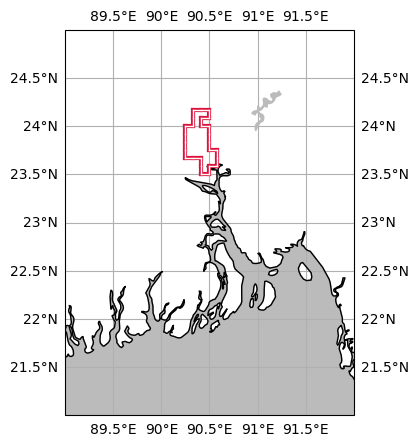

In [4]:
#---------------------------------------------------------------------------------------------------------------
#  city maskの枠だけを表示
#---------------------------------------------------------------------------------------------------------------
def draw_mask_sotowaku(extent, mask_cropped, ax=None, sotowaku_color='#dc143c', linewidth=3):
    """
    zorder = 0: デフォルトの最背面(gridをzorder=0に設定)
    zorder = 1: 赤色の外枠(citymask)
    zorder = 2: 白色の内枠が最前面(citymask)
    """

    # delta
    delta = 360/4320
    x_left = extent[0]
    y_top = extent[3]
    
    # outer
    upper_indices = []
    lower_indices = []
    left_indices = []
    right_indices = []
    rows, cols = mask_cropped.shape
    for i in range(rows):
        for j in range(cols):
            if mask_cropped[i, j] == 1:
                if mask_cropped[i-1, j] == 0:
                    upper_indices.append((i, j))
                if mask_cropped[i+1, j] == 0:
                    lower_indices.append((i, j))
                if mask_cropped[i, j-1] == 0:
                    left_indices.append((i, j))
                if mask_cropped[i, j+1] == 0:
                    right_indices.append((i, j))

    # extent
    projection = ccrs.PlateCarree()

    if ax is None:
        # figure
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        ax.coastlines(zorder=1)
        ax.set_extent(extent)
        ax.gridlines(draw_labels=True, zorder=0)
        ax.add_feature(cfea.OCEAN, color='#BBBBBB')
        ax.add_feature(cfea.LAKES, color='#BBBBBB')
        
    # city mask
    for up in upper_indices:
        x_index = x_left + delta*(up[1])
        y_index = y_top - delta*(up[0])
        ax.plot([x_index, x_index+delta], [y_index, y_index], color=sotowaku_color, transform=projection, linewidth=linewidth, zorder=1) # top
        ax.plot([x_index, x_index+delta], [y_index, y_index], color='white', transform=projection, linewidth=linewidth-2, zorder=2) # top
    for lo in lower_indices:
        x_index = x_left + delta*(lo[1])
        y_index = y_top - delta*(lo[0]+1)
        ax.plot([x_index, x_index+delta], [y_index, y_index], color=sotowaku_color, transform=projection, linewidth=linewidth, zorder=1) # bottom
        ax.plot([x_index, x_index+delta], [y_index, y_index], color='white', transform=projection, linewidth=linewidth-2, zorder=2) # bottom
    for le in left_indices:
        x_index = x_left + delta*(le[1])
        y_index = y_top - delta*(le[0]+1)
        ax.plot([x_index, x_index], [y_index, y_index+delta], color=sotowaku_color, transform=projection, linewidth=linewidth, zorder=1) # left
        ax.plot([x_index, x_index], [y_index, y_index+delta], color='white', transform=projection, linewidth=linewidth-2, zorder=2) # left
    for ri in right_indices:
        x_index = x_left + delta*(ri[1]+1)
        y_index = y_top - delta*(ri[0]+1)
        ax.plot([x_index, x_index], [y_index, y_index+delta], color=sotowaku_color, transform=projection, linewidth=linewidth, zorder=1) # right
        ax.plot([x_index, x_index], [y_index, y_index+delta], color='white', transform=projection, linewidth=linewidth-2, zorder=2) # right

    if ax is None:
        plt.show()
    else:
        return ax

draw_mask_sotowaku(result[0], result[1])

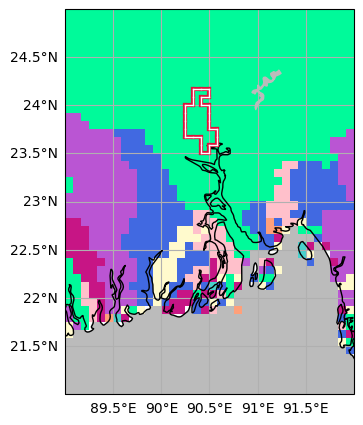

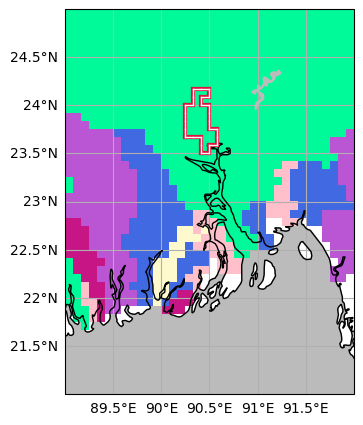

In [5]:
#---------------------------------------------------------------------------------------------------------------
#  Basinの図を作図する
#---------------------------------------------------------------------------------------------------------------
def plot_basin(extent, citymask, data, Rivnum_masked_array, country_name=None, gs_position=None, fig=None):
    # cmap
    color_code = ['#4169e1', '#fffacd', '#c71585', '#00fa9a', '#ba55d3', '#48d1cc', '#ffc0cb', '#ffa07a']
    color_masked = np.ma.masked_where(Rivnum_masked_array >= 1e20, Rivnum_masked_array)
    color_filled = color_masked.filled(-1)
    num_colors, index_dict, cmap = pulp_cmap(color_filled, color_code)

    # data
    data_masked = np.ma.masked_where(data >= 1e20, data)
    data_filled = data_masked.filled(-1)
    indexed_data = np.vectorize(get_index)(data_filled, index_dict)
    indexed_data_masked = np.ma.masked_where(indexed_data<0, indexed_data)
    
    # extent
    projection = ccrs.PlateCarree()

    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        # draw
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=0)
    gl.top_labels = False   
    gl.right_labels = False 
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=1)
    img = ax.imshow(indexed_data_masked,
                    origin='upper',
                    extent=extent,
                    transform=projection,
                    cmap=cmap,
                    vmin=-0.5, vmax=num_colors-0.5)
    stw = draw_mask_sotowaku(extent, citymask, ax=ax) 
    #fig.colorbar(img, ax=ax)

    if country_name is not None:
        shpfilename = shapereader.natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces')
        provinces = shapereader.Reader(shpfilename).records()
        provinces_of_japan = filter(
            lambda province: province.attributes['admin'] == country_name, provinces)
        for province in provinces_of_japan:
            geometry = province.geometry
            ax.add_geometries([geometry], ccrs.PlateCarree(), facecolor='none', linestyle=':', zorder=10)
    
    plt.show()


plot_basin(result[0], result[1], result[6], result[6])
plot_basin(result[0], result[1], result[8], result[6])

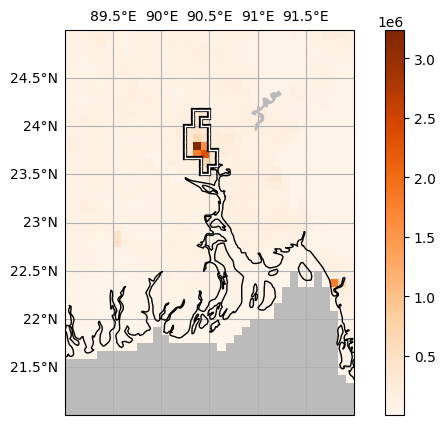

In [6]:
#---------------------------------------------------------------------------------------------------------------
# 人口をプロットする
#---------------------------------------------------------------------------------------------------------------
def plot_population(extent, citymask, g_pop_cropped, country_name=None, gs_position=None, fig=None):
    # draw
    g_pop_cropped = np.ma.masked_where(g_pop_cropped == 0, g_pop_cropped)
    pop_vmin = np.min(g_pop_cropped)
    pop_vmax = np.max(g_pop_cropped)
    #print(f"pop_vmin: {pop_vmin}")
    #print(f"pop_vmax: {pop_vmax}")
    
    # extent
    projection = ccrs.PlateCarree()
    
    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=0)
    #gl.top_labels = False 
    gl.right_labels = False 
    gl.bottom_labels = False
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=1)
    
    img = ax.imshow(g_pop_cropped,
                origin='upper',
                extent=extent,
                transform=projection,
                cmap='Oranges',
                #norm=colors.LogNorm(vmin=1e4, vmax=pop_vmax)
    ) 
    stw = draw_mask_sotowaku(extent, citymask, ax=ax, sotowaku_color='black') 
    
    if country_name is not None:
        shpfilename = shapereader.natural_earth(resolution='10m', category='cultural', name='admin_1_states_provinces')
        provinces = shapereader.Reader(shpfilename).records()
        provinces_of_japan = filter(
            lambda province: province.attributes['admin'] == country_name, provinces)
        for province in provinces_of_japan:
            geometry = province.geometry
            ax.add_geometries([geometry], ccrs.PlateCarree(), facecolor='none', linestyle=':', zorder=10)
            
    fig.colorbar(img, ax=ax, orientation='vertical', shrink=1, pad=0.08)
    #fig.colorbar(img, ax=ax, orientation='horizontal', shrink=0.7, pad=0.05)

plot_population(result[0], result[1], result[2], country_name='Japan')

/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


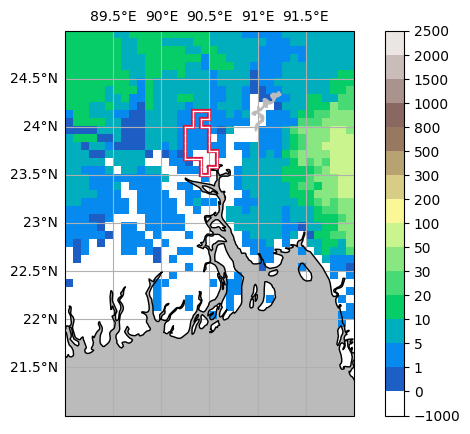

In [7]:
#---------------------------------------------------------------------------------------------------------------
# 標高をプロットする
#---------------------------------------------------------------------------------------------------------------
def plot_elevation(extent, citymask, elevation, gs_position=None, fig=None):
    # draw
    elevation = np.ma.masked_where(elevation == 0, elevation)
    elv_vmin = np.min(elevation)
    elv_vmax = np.max(elevation)
    #print(f"elv_vmin: {elv_vmin}")
    #print(f"elv_vmax: {elv_vmax}")

    terrain = plt.cm.get_cmap('terrain')
    colors = terrain(np.linspace(0, 1, terrain.N))
    colors[0] = (1, 1, 1, 1)
    colors = colors[:-10]
    cmap = mcolors.LinearSegmentedColormap.from_list('terrain_without_white', colors, terrain.N)
    levels = [-1000, 0, 1, 5, 10, 20, 30, 50, 100, 200, 300, 500, 800, 1000, 1500, 2000, 2500]
    norm = mcolors.BoundaryNorm(levels, cmap.N)
    
    # extent
    projection = ccrs.PlateCarree()
    
    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=0)
    #gl.top_labels = False   
    gl.right_labels = False 
    gl.bottom_labels = False
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=1)
    
    img = ax.imshow(elevation,
                origin='upper',
                extent=extent,
                transform=projection,
                cmap=cmap,
                norm=norm,
    ) 
    stw = draw_mask_sotowaku(extent, citymask, ax=ax) 
    #fig.colorbar(img, ax=ax, ticks=levels)
    #cbar = fig.colorbar(img, ax=ax, ticks=levels, orientation='horizontal', shrink=0.7, pad=0.05)
    #cbar.ax.xaxis.set_tick_params(rotation=90)
    fig.colorbar(img, ax=ax, ticks=levels, orientation='vertical', shrink=1, pad=0.08)

plot_elevation(result[0], result[1], result[3])

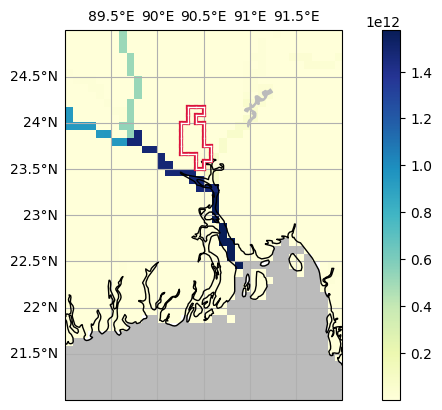

In [8]:
#---------------------------------------------------------------------------------------------------------------
# 集水面積をプロットする
#---------------------------------------------------------------------------------------------------------------
def plot_rivara(extent, citymask, rivara, gs_position=None, fig=None):
    # draw
    rivara = np.ma.masked_where(rivara == 0, rivara)
    dis_vmin = np.min(rivara)
    dis_vmax = np.max(rivara)
    #print(f"dis_vmin: {dis_vmin}")
    #print(f"dis_vmax: {dis_vmax}")
    
    # extent
    projection = ccrs.PlateCarree()
    
    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        fig = plt.figure()
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=0)
    #gl.top_labels = False   
    gl.right_labels = False 
    gl.bottom_labels = False
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=1)
    
    img = ax.imshow(rivara,
                origin='upper',
                extent=extent,
                transform=projection,
                cmap='YlGnBu',
                #norm=mcolors.LogNorm()
    ) 
    stw = draw_mask_sotowaku(extent, citymask, ax=ax) 
    #cbar = fig.colorbar(img, ax=ax, orientation='horizontal', shrink=0.7, pad=0.05)
    fig.colorbar(img, ax=ax, orientation='vertical', shrink=1, pad=0.08)

plot_rivara(result[0], result[1], result[4])

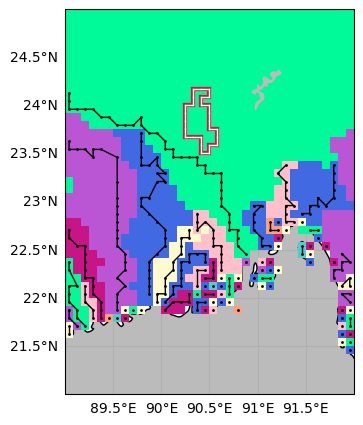

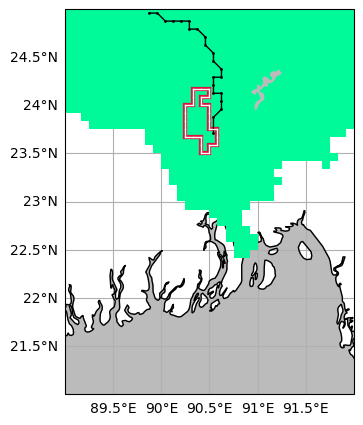

In [9]:
#---------------------------------------------------------------------------------------------------------------
#  BasinとMain riverの図を作図する
#---------------------------------------------------------------------------------------------------------------
def plot_basin_path(extent, citymask, data, Rivnum_masked_array, results_dict=None, width=1, gs_position=None, fig=None):
    # cmap
    color_code = ['#4169e1', '#fffacd', '#c71585', '#00fa9a', '#ba55d3', '#48d1cc', '#ffc0cb', '#ffa07a']
    color_masked = np.ma.masked_where(Rivnum_masked_array >= 1e20, Rivnum_masked_array)
    color_filled = color_masked.filled(-1)
    num_colors, index_dict, cmap = pulp_cmap(color_filled, color_code)

    # data
    data_masked = np.ma.masked_where(data >= 1e20, data)
    data_filled = data_masked.filled(-1)
    indexed_data = np.vectorize(get_index)(data_filled, index_dict)
    indexed_data_masked = np.ma.masked_where(indexed_data<0, indexed_data)
    
    # extent
    projection = ccrs.PlateCarree()

    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=-1)
    gl.top_labels = False   
    gl.right_labels = False 
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=0)
    
    img = ax.imshow(indexed_data_masked,
                    origin='upper',
                    extent=extent,
                    transform=projection,
                    cmap=cmap,
                    vmin=-0.5, vmax=num_colors-0.5)
    
    if results_dict is not None:
        for key, path in results_dict.items():
            lat_coords, lon_coords = zip(*path)
            lat_coords = [extent[3] - ((lat + (1/(width * 2)))*(1/12)) for lat in lat_coords]
            lon_coords = [(lon + (1/(width * 2)))*(1/12) + extent[0] for lon in lon_coords]
            ax.plot(lon_coords, lat_coords, marker='o', markersize=1, color='black', linestyle='-', linewidth=1, transform=projection, zorder=2)
            
    stw = draw_mask_sotowaku(extent, citymask, ax=ax) 
    
    #fig.colorbar(img, ax=ax)

plot_basin_path(result[0], result[1], result[6], result[6], results_dict=result[25])
plot_basin_path(result[0], result[1], result[10], result[6], results_dict=result[18])

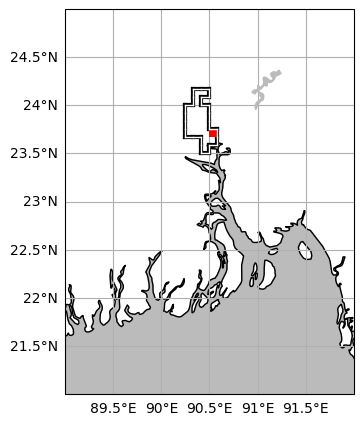

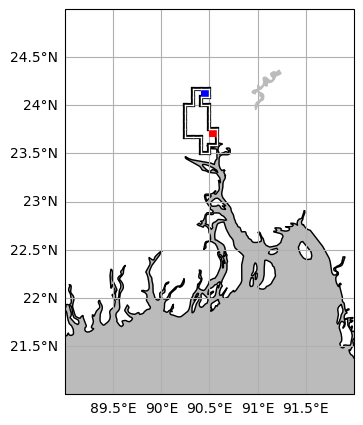

In [10]:
#---------------------------------------------------------------------------------------------------------------
#  上下水道のプロット
#---------------------------------------------------------------------------------------------------------------
def plot_prf_swg(extent, citymask, prf, swg, width=1, results_dict=None, gs_position=None, fig=None):
    # mask
    prf = np.ma.masked_where(prf == 0, prf)
    swg = np.ma.masked_where(swg == 0, swg)

    # cmap
    prf_cmap = colors.ListedColormap(['blue', 'blue'])
    swg_cmap = colors.ListedColormap(['red', 'red'])
    
    # extent
    projection = ccrs.PlateCarree()
    
    if gs_position is not None:
        ax = fig.add_subplot(gs_position, projection=projection)
    else:
        fig = plt.figure(figsize=(5,5))
        ax = plt.subplot(projection=projection)
        
    ax.set_extent(extent, projection)
    gl = ax.gridlines(draw_labels=True, zorder=0)
    gl.top_labels = False   
    gl.right_labels = False 
    ax.add_feature(cfea.OCEAN, color='#BBBBBB')
    ax.add_feature(cfea.LAKES, color='#BBBBBB')
    ax.coastlines(zorder=0)

    p_img = ax.imshow(prf,
                    origin='upper', extent=extent, transform=projection,
                    cmap=prf_cmap,
                    zorder=2
                   )
    s_img = ax.imshow(swg,
                    origin='upper', extent=extent, transform=projection,
                    cmap=swg_cmap,
                    zorder=2
                   )
    
    stw = draw_mask_sotowaku(extent, citymask, ax=ax, sotowaku_color='black') 
    
    if results_dict is not None:
        for key, path in results_dict.items():
            lat_coords, lon_coords = zip(*path)
            lat_coords = [extent[3] - ((lat + (1/(width * 2)))*(1/12)) for lat in lat_coords]
            lon_coords = [(lon + (1/(width * 2)))*(1/12) + extent[0] for lon in lon_coords]
            ax.plot(lon_coords, lat_coords, marker='o', markersize=1, color='black', linestyle='-', linewidth=1, transform=projection, zorder=2)
    

plot_prf_swg(result[0], result[1], result[29], result[30])
plot_prf_swg(result[0], result[1], result[20], result[21])

/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


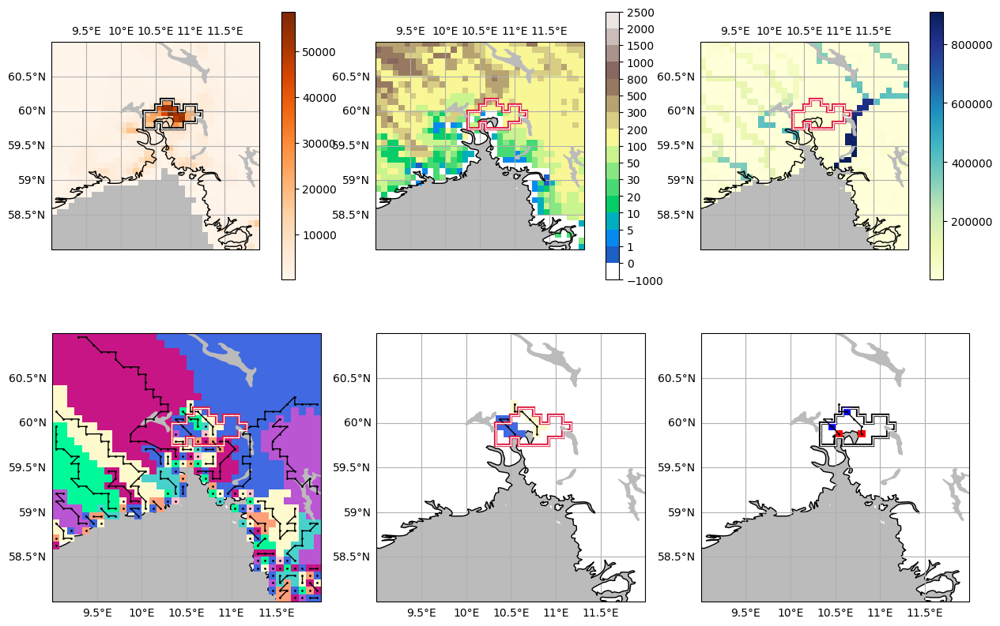

In [11]:
def subfigure(country_name=None):
#---------------------------------------------------------------------------------------------------------------
#   Initialization
#---------------------------------------------------------------------------------------------------------------
    city_num = 506
    remove_grid = 5 # minimum number of grids in one basin
    innercity_grid = 2 # minimum number of main river grid within city mask
    left, right, bottom, top = 9, 12, 58, 61

#---------------------------------------------------------------------------------------------------------------
#   get variables
#---------------------------------------------------------------------------------------------------------------

    result = explore(city_num, remove_grid, innercity_grid, left, right, bottom, top)
    
    
    plt.rcParams['font.size'] = 10
    fig = plt.figure(figsize=(15, 15))
    gs = gridspec.GridSpec(3, 3)

    plot_population(result[0], result[1], result[2], country_name=country_name, gs_position=gs[0,0], fig=fig)
    plot_elevation(result[0], result[1], result[3], gs_position=gs[0,1], fig=fig)
    plot_rivara(result[0], result[1], result[5], gs_position=gs[0,2], fig=fig)
    
    plot_basin_path(result[0], result[1], result[6], result[6], results_dict=result[25], gs_position=gs[1,0], fig=fig)
    plot_basin_path(result[0], result[1], result[10], result[6], results_dict=result[18], gs_position=gs[1,1], fig=fig)
    plot_prf_swg(result[0], result[1], result[20], result[21], results_dict=result[18], gs_position=gs[1,2], fig=fig)
    
    plt.show()
    
subfigure()

/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


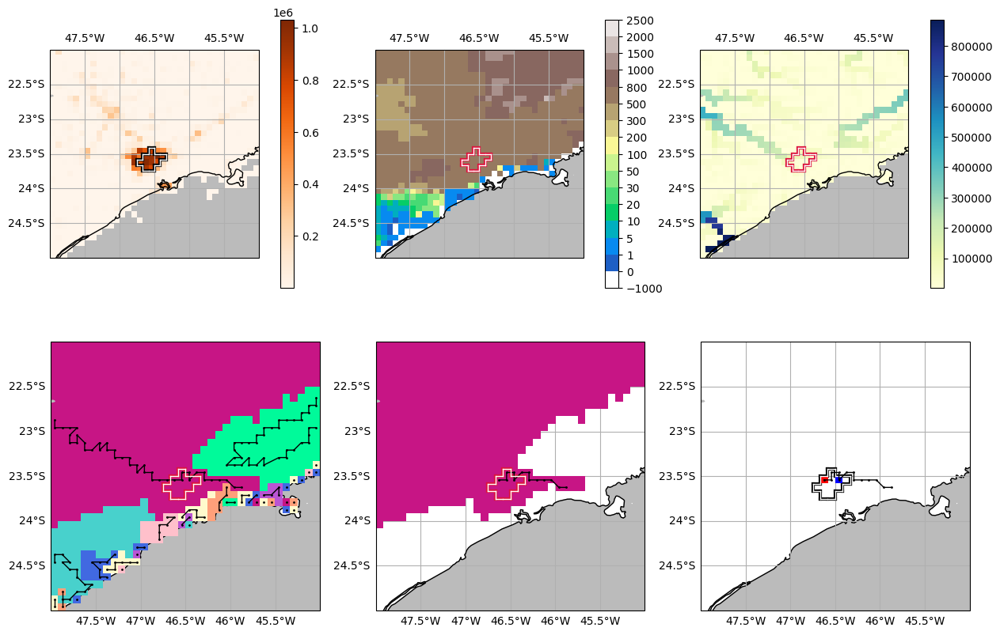

In [12]:
def subfigure(country_name=None):
#---------------------------------------------------------------------------------------------------------------
#   Initialization
#---------------------------------------------------------------------------------------------------------------
    city_num = 5
    remove_grid = 5 # minimum number of grids in one basin
    innercity_grid = 2 # minimum number of main river grid within city mask
    left, right, bottom, top = -48, -45, -25, -22

#---------------------------------------------------------------------------------------------------------------
#   get variables
#---------------------------------------------------------------------------------------------------------------

    result = explore(city_num, remove_grid, innercity_grid, left, right, bottom, top)
    
    
    plt.rcParams['font.size'] = 10
    fig = plt.figure(figsize=(15, 15))
    gs = gridspec.GridSpec(3, 3)

    plot_population(result[0], result[1], result[2], country_name=country_name, gs_position=gs[0,0], fig=fig)
    plot_elevation(result[0], result[1], result[3], gs_position=gs[0,1], fig=fig)
    plot_rivara(result[0], result[1], result[5], gs_position=gs[0,2], fig=fig)
    
    plot_basin_path(result[0], result[1], result[6], result[6], results_dict=result[25], gs_position=gs[1,0], fig=fig)
    plot_basin_path(result[0], result[1], result[10], result[6], results_dict=result[18], gs_position=gs[1,1], fig=fig)
    plot_prf_swg(result[0], result[1], result[20], result[21], results_dict=result[18], gs_position=gs[1,2], fig=fig)
    
    plt.show()
    
subfigure()

São Paulo


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


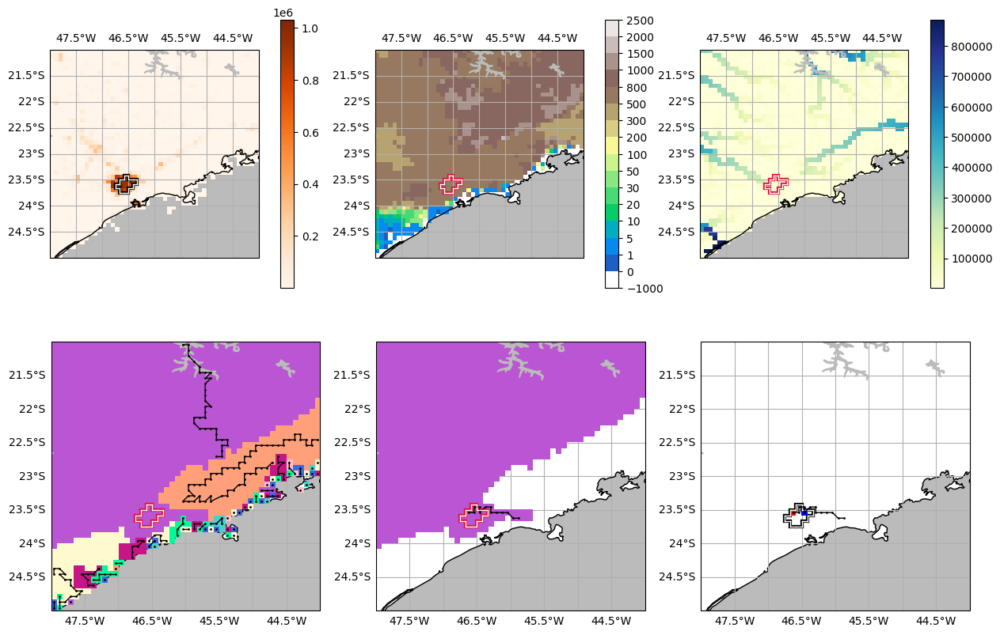

In [13]:
def snapshot(city_num=5, country_name=None):
#---------------------------------------------------------------------------------------------------------------
#   Initialization
#---------------------------------------------------------------------------------------------------------------
    
    root_dir = "/mnt/c/Users/tsimk/Downloads/dotfiles/h08/global_city"
    city_path = f"{root_dir}/dat/cty_lst_/gpw4/WUP2018_300k_2010.txt"
    with open(city_path, "r") as input_file:
        lines = input_file.readlines()

    line = lines[city_num-1] # 対象となる都市の情報行を参照
    parts = line.split('\t') # 各行をスペースで分割
    parts = [item.strip() for item in parts]
    cnt_lat = float(parts[1]) # 都市中心の緯度
    cnt_lon = float(parts[2]) # 都市中心の経度
    city_name = parts[4].replace("\"", "").replace("?", "").replace("/", "") # 都市名

    # widthを使用して外枠の座標を計算
    width=2
    left = int(int(cnt_lon) - width)
    right = int(int(cnt_lon) + width)
    bottom = int(int(cnt_lat) - width)
    top = int(int(cnt_lat) + width)
    print(city_name)
         
    remove_grid = 5 # minimum number of grids in one basin
    innercity_grid = 2 # minimum number of main river grid within city mask

#---------------------------------------------------------------------------------------------------------------
#   get variables
#---------------------------------------------------------------------------------------------------------------

    result = explore(city_num, remove_grid, innercity_grid, left, right, bottom, top)
    
    
    plt.rcParams['font.size'] = 10
    fig = plt.figure(figsize=(15, 15))
    gs = gridspec.GridSpec(3, 3)

    plot_population(result[0], result[1], result[2], country_name=country_name, gs_position=gs[0,0], fig=fig)
    plot_elevation(result[0], result[1], result[3], gs_position=gs[0,1], fig=fig)
    plot_rivara(result[0], result[1], result[5], gs_position=gs[0,2], fig=fig)
    
    plot_basin_path(result[0], result[1], result[6], result[6], results_dict=result[25], gs_position=gs[1,0], fig=fig)
    plot_basin_path(result[0], result[1], result[10], result[6], results_dict=result[18], gs_position=gs[1,1], fig=fig)
    plot_prf_swg(result[0], result[1], result[20], result[21], results_dict=result[18], gs_position=gs[1,2], fig=fig)
    
    plt.show()
    
snapshot(city_num=5)

Tokyo


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


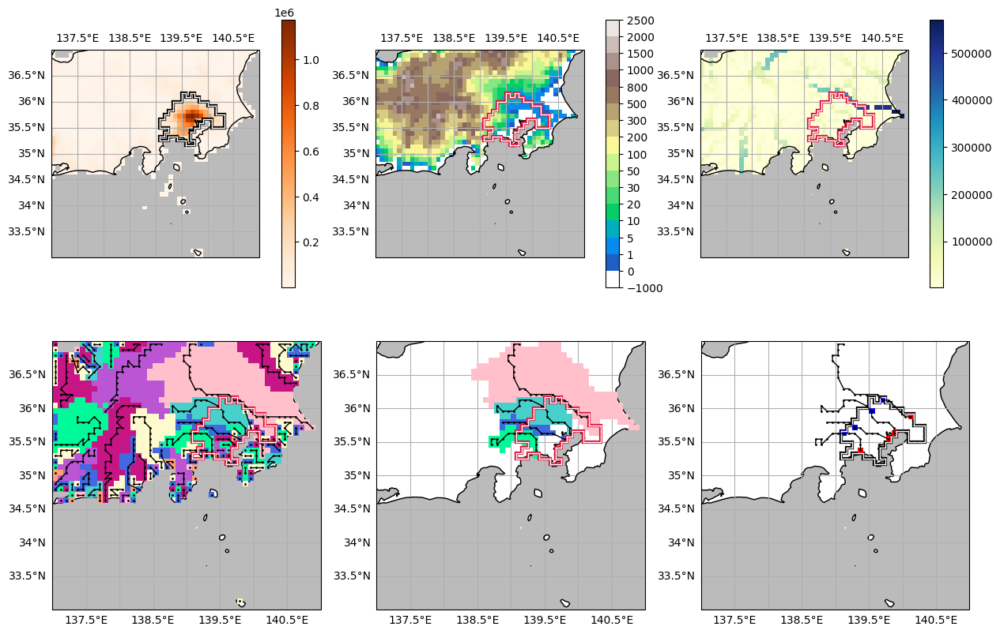

Delhi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


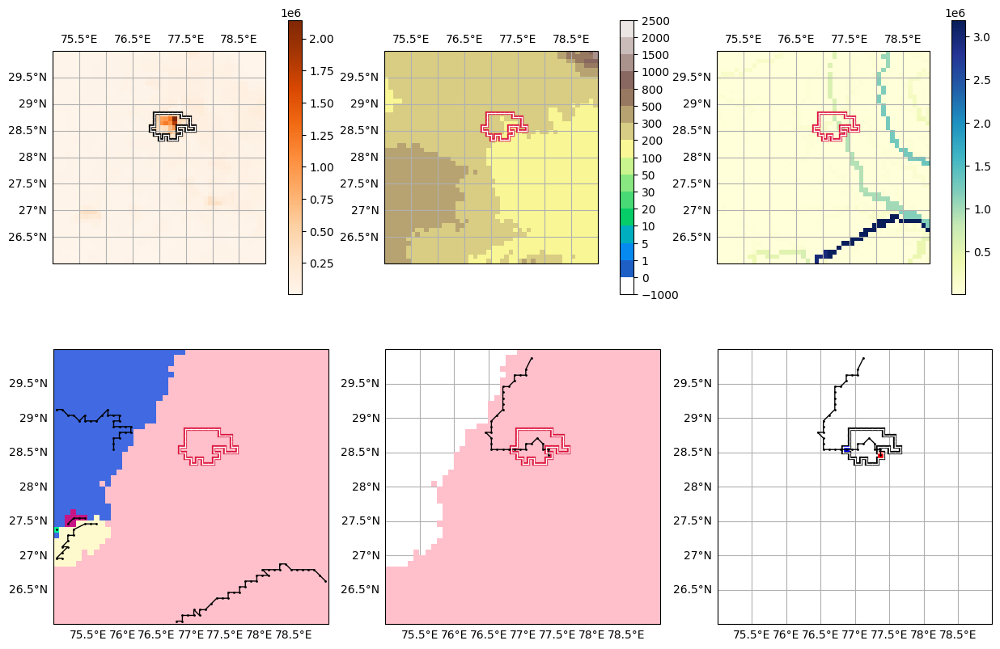

Shanghai


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


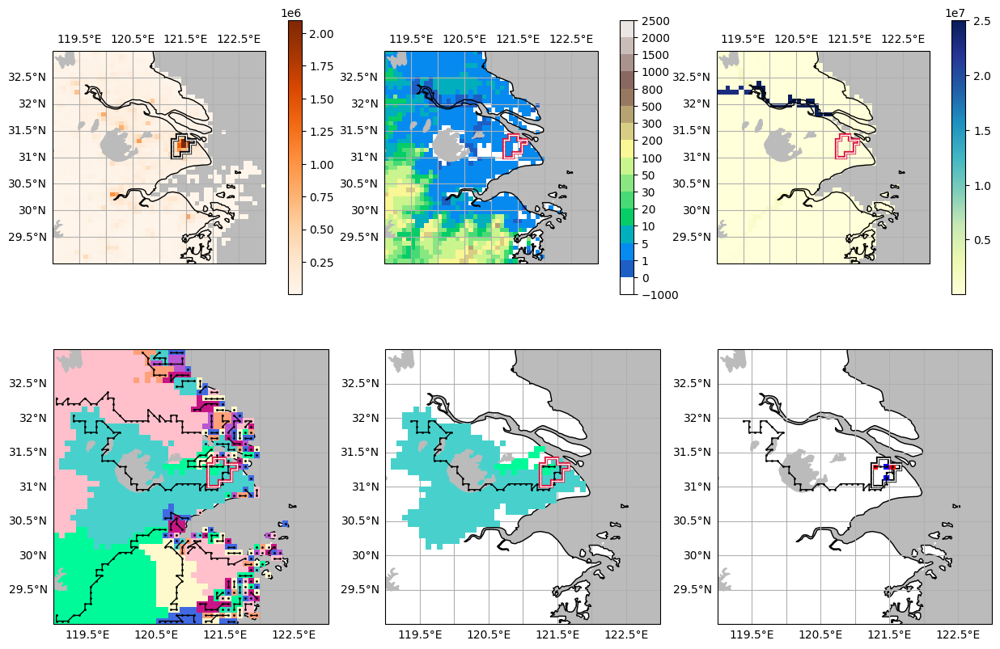

Ciudad de México (Mexico City)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


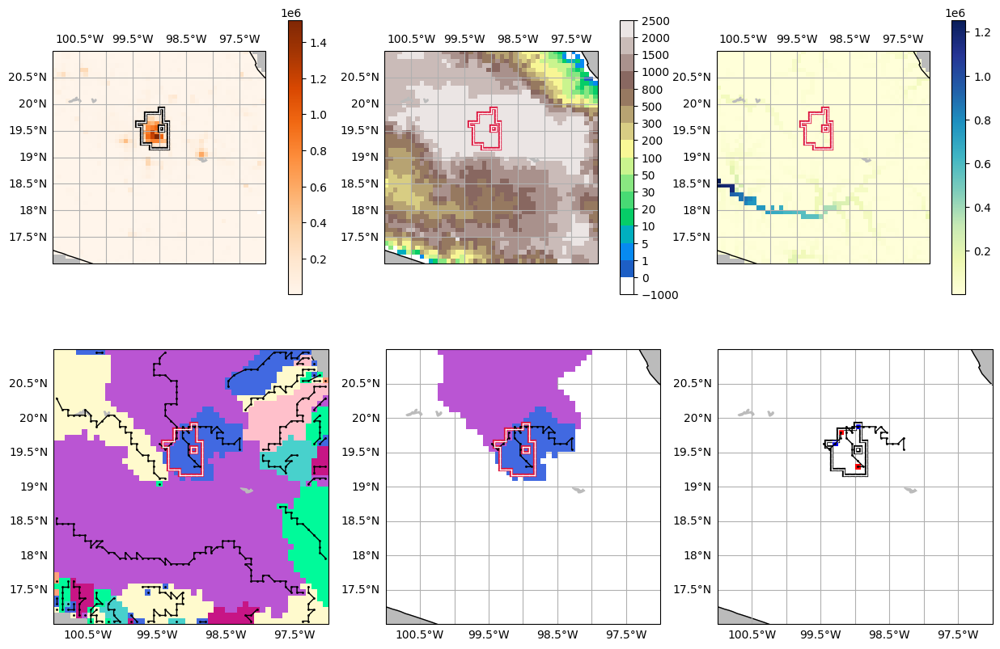

São Paulo


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


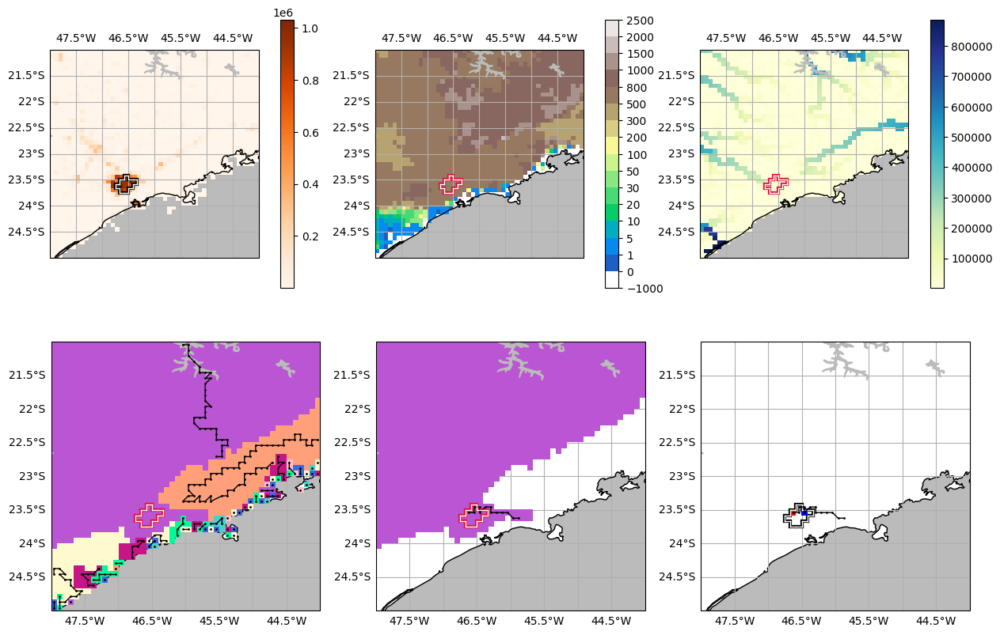

Kinki M.M.A. (Osaka)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


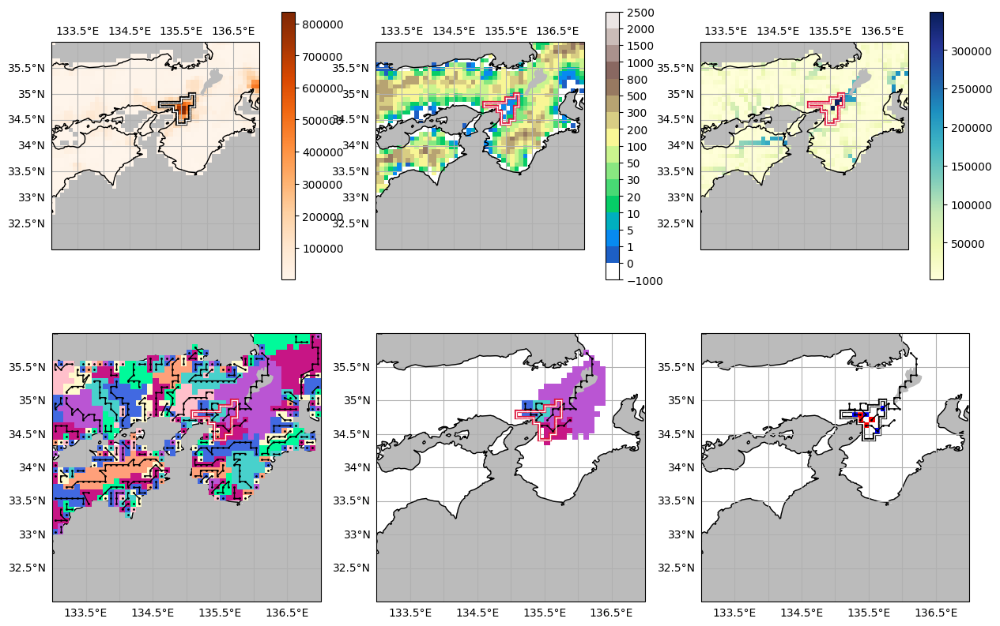

New York-Newark


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


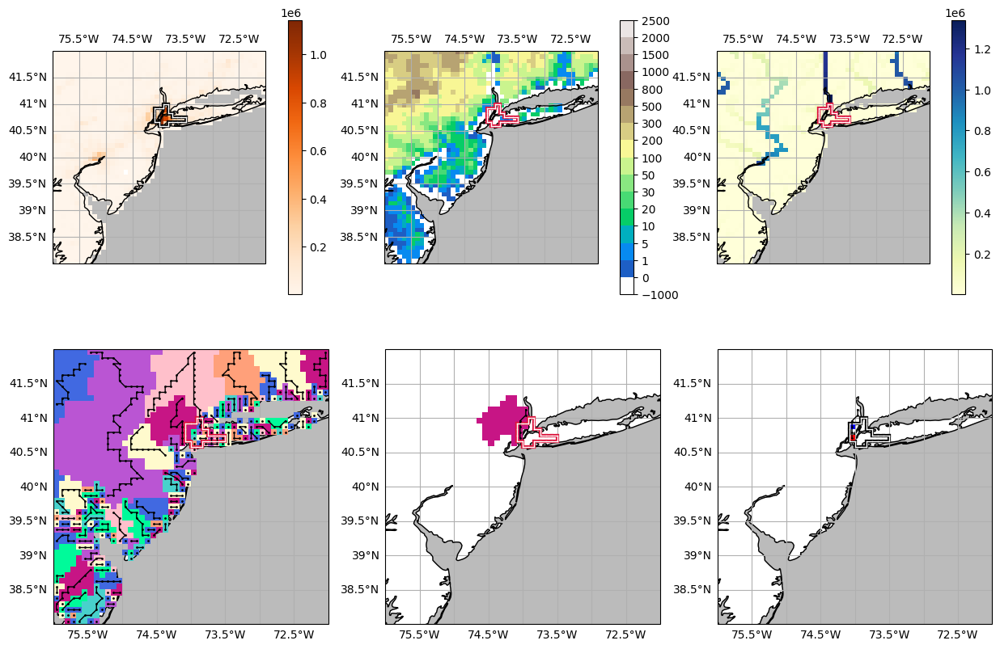

Mumbai (Bombay)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


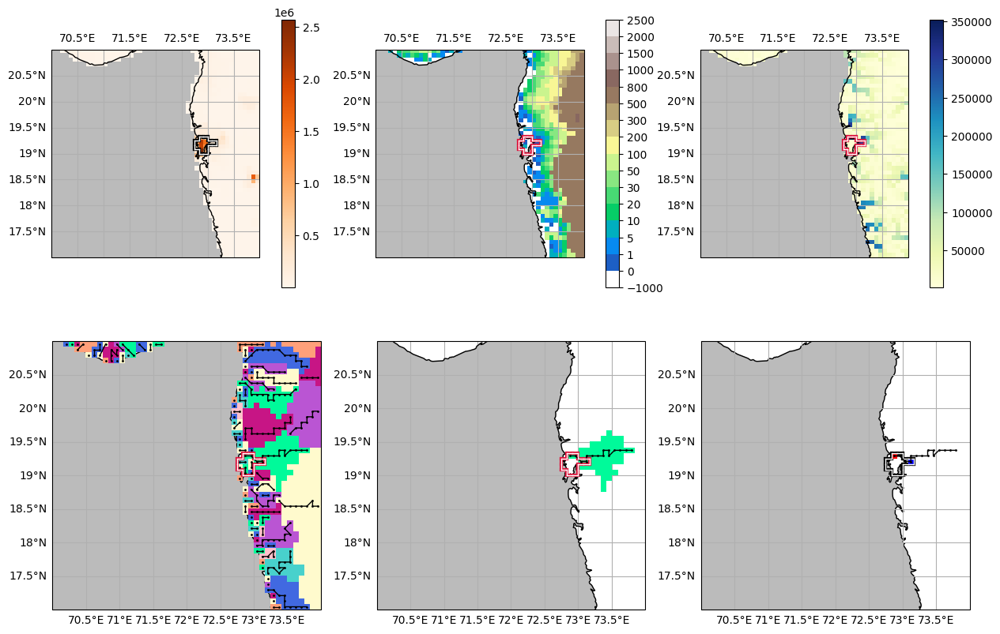

Al-Qahirah (Cairo)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


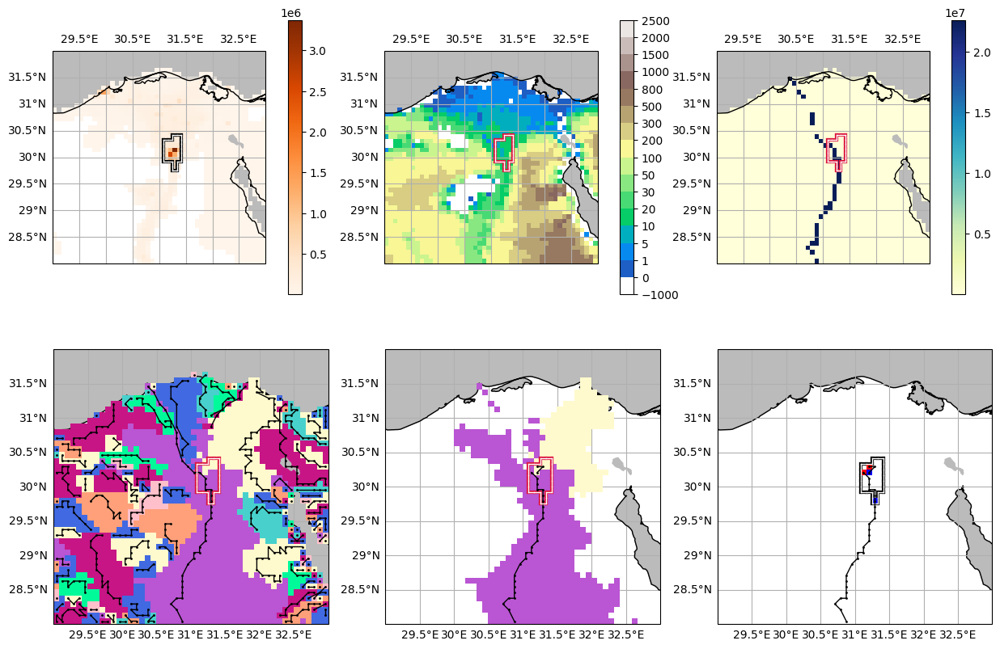

Beijing


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


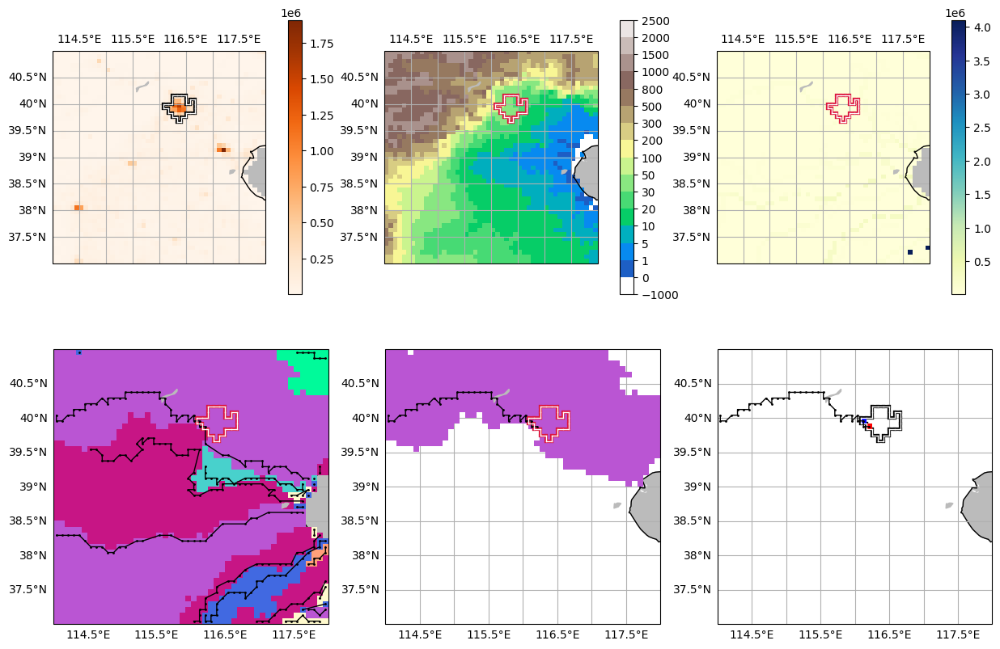

Dhaka
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


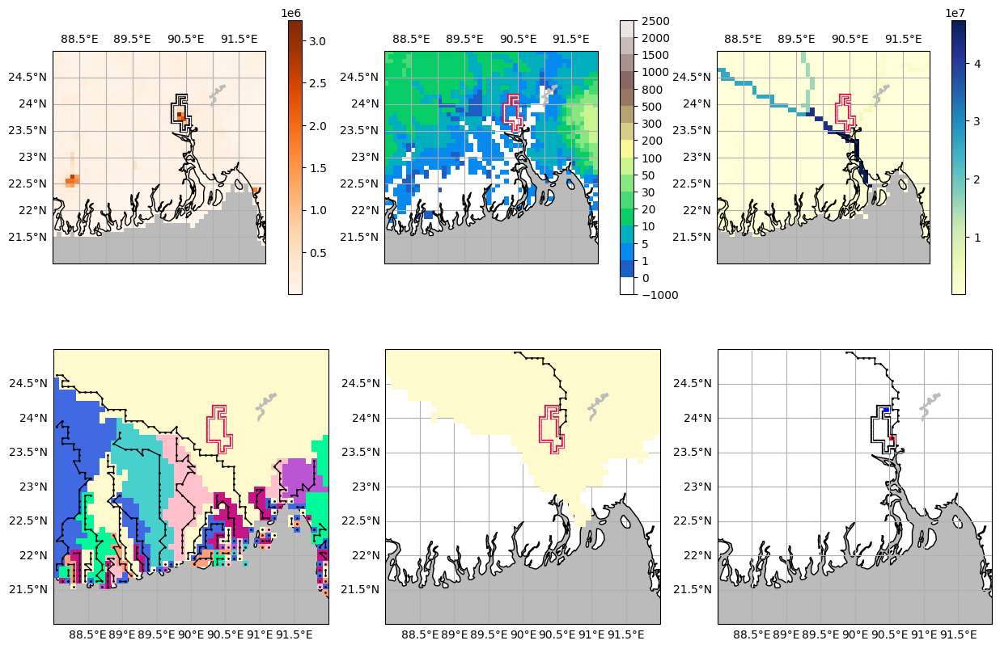

Buenos Aires


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


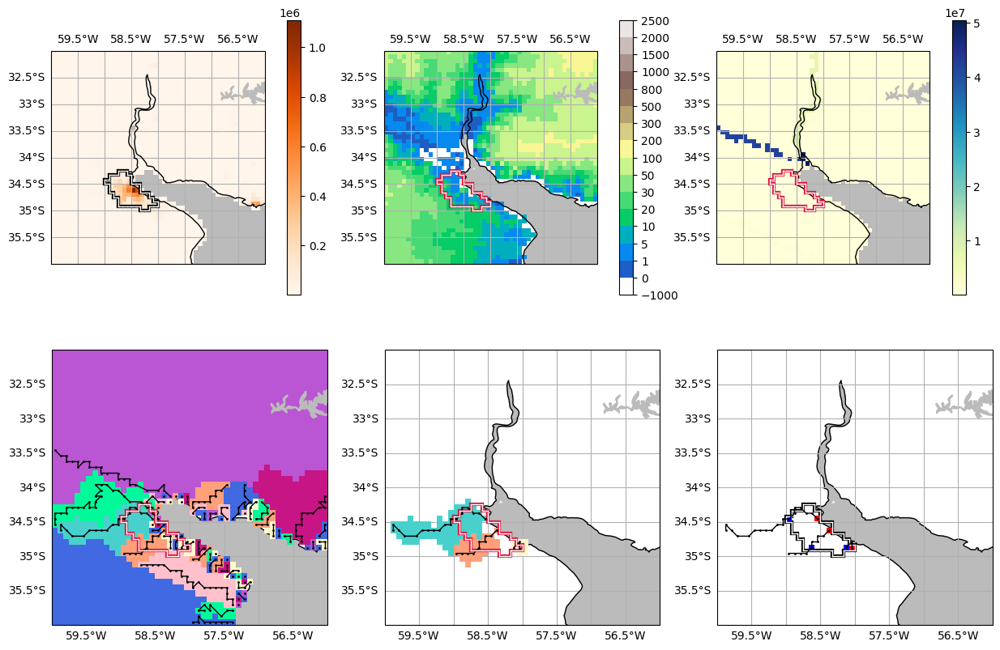

Kolkata (Calcutta)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


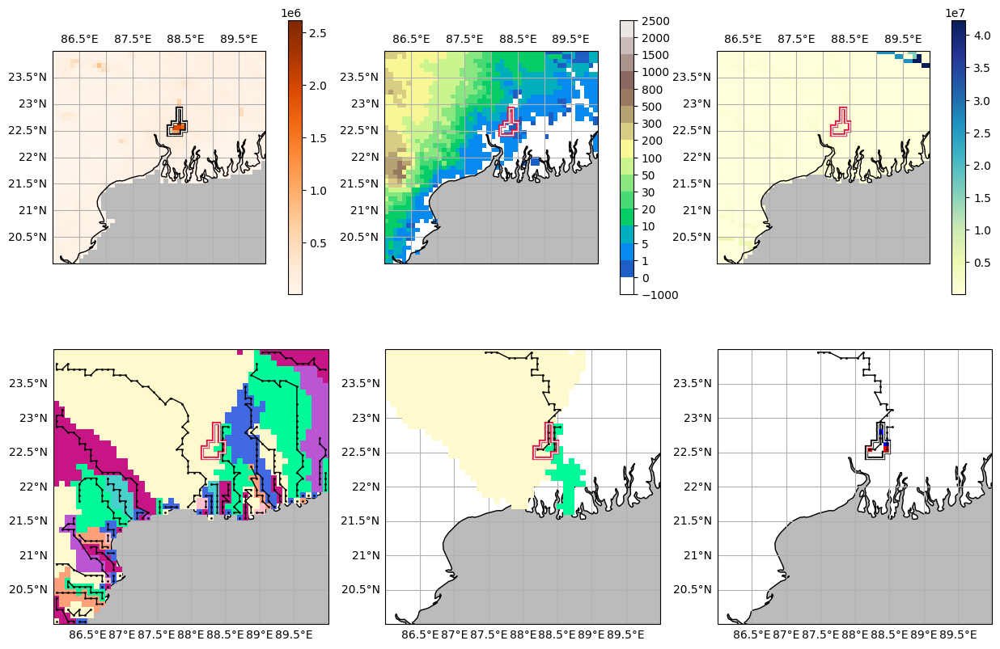

Karachi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


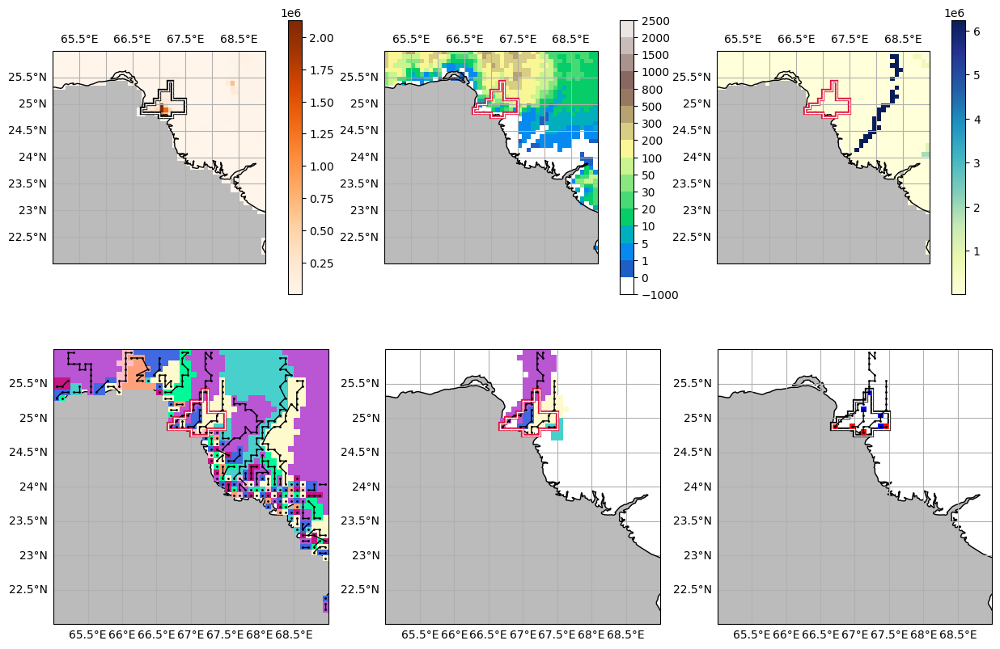

Istanbul


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


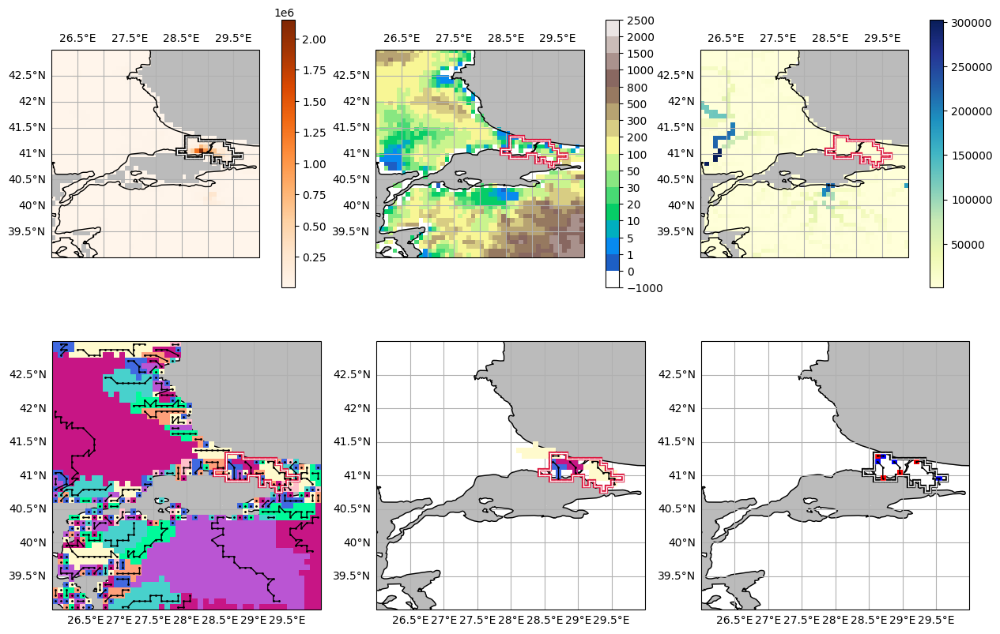

Rio de Janeiro


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


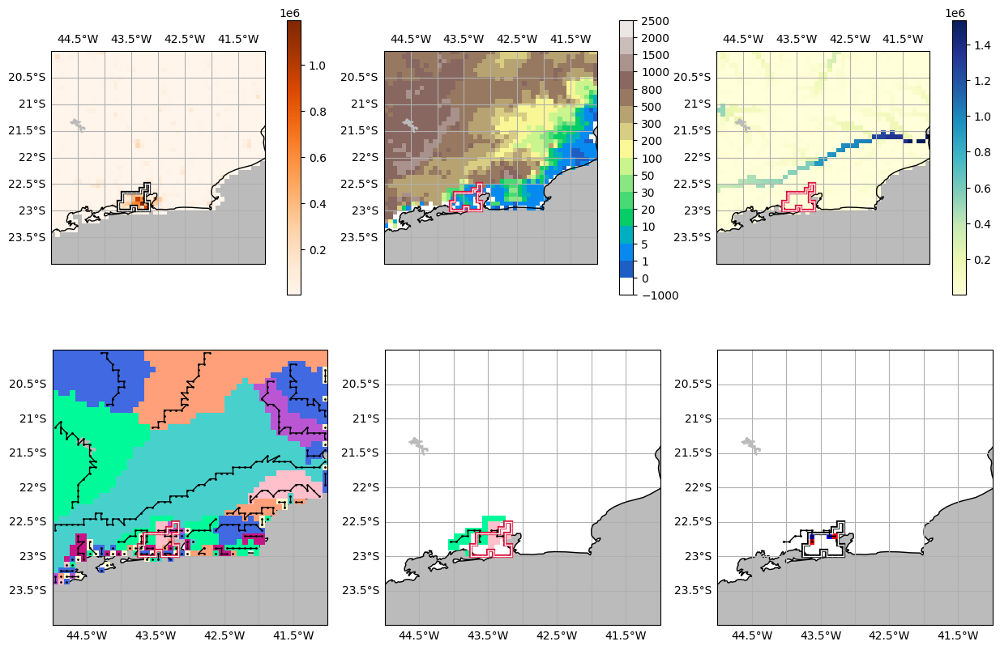

Los Angeles-Long Beach-Santa Ana


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


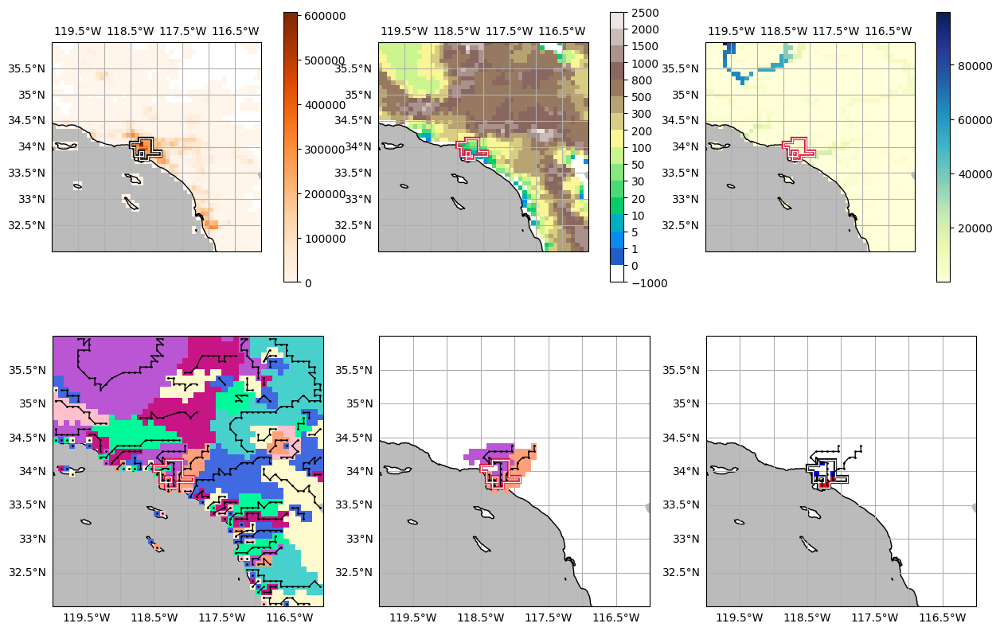

Manila


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


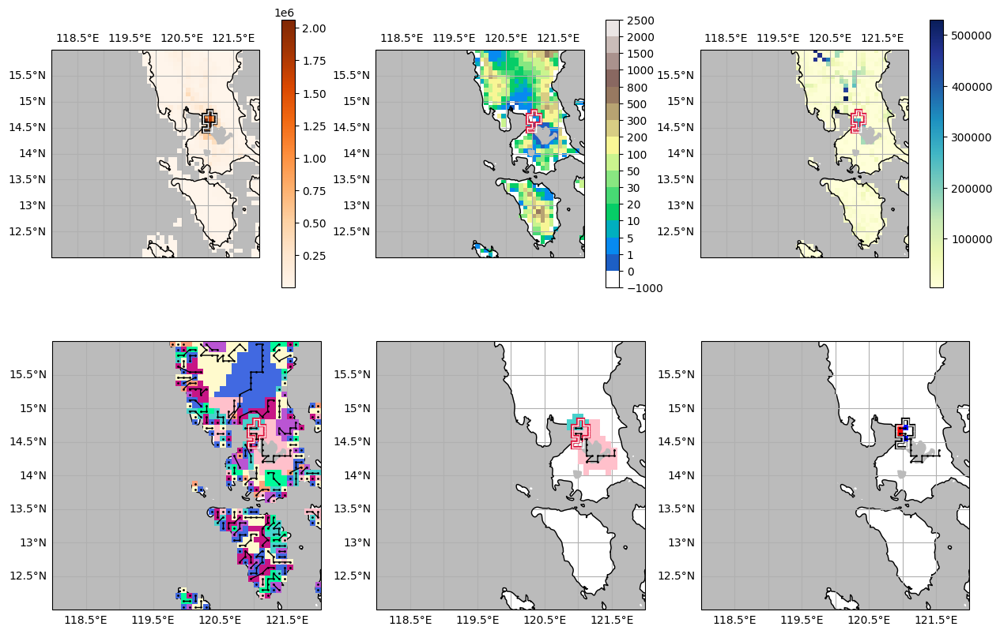

Moskva (Moscow)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


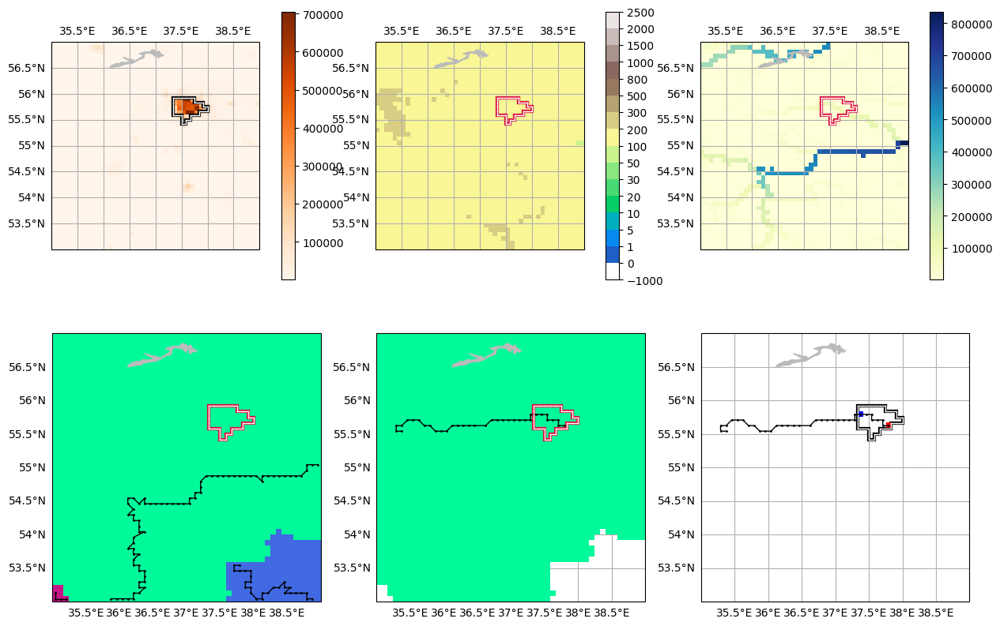

Chongqing


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


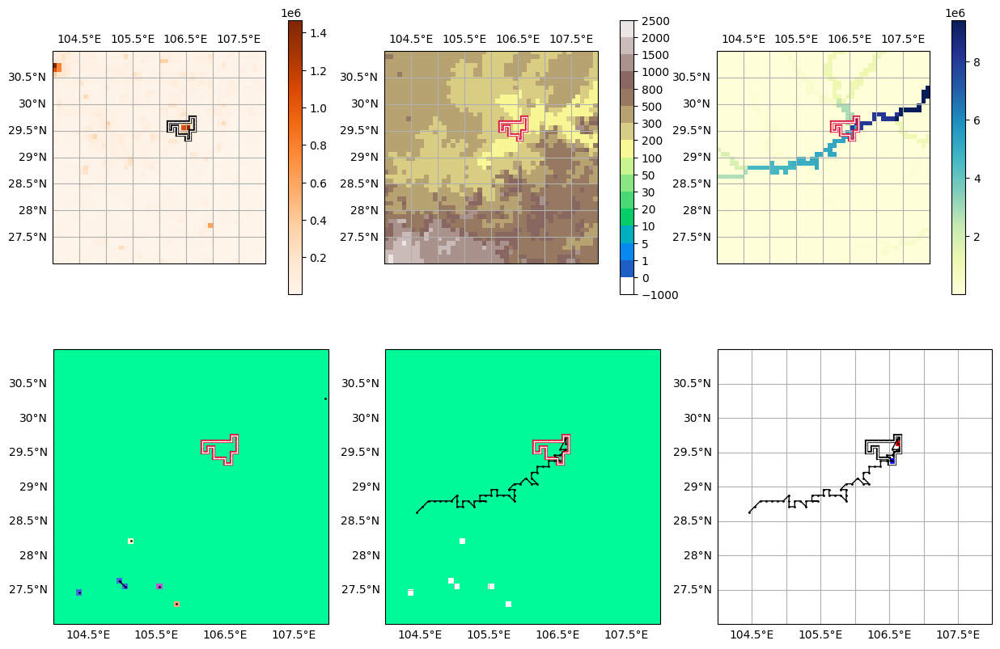

Paris


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


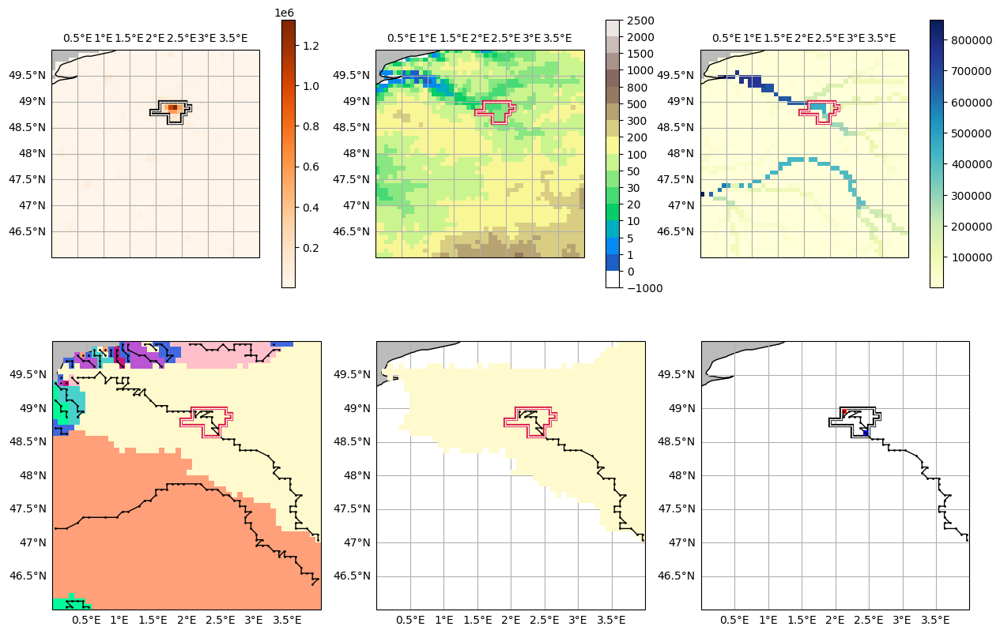

Lagos
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


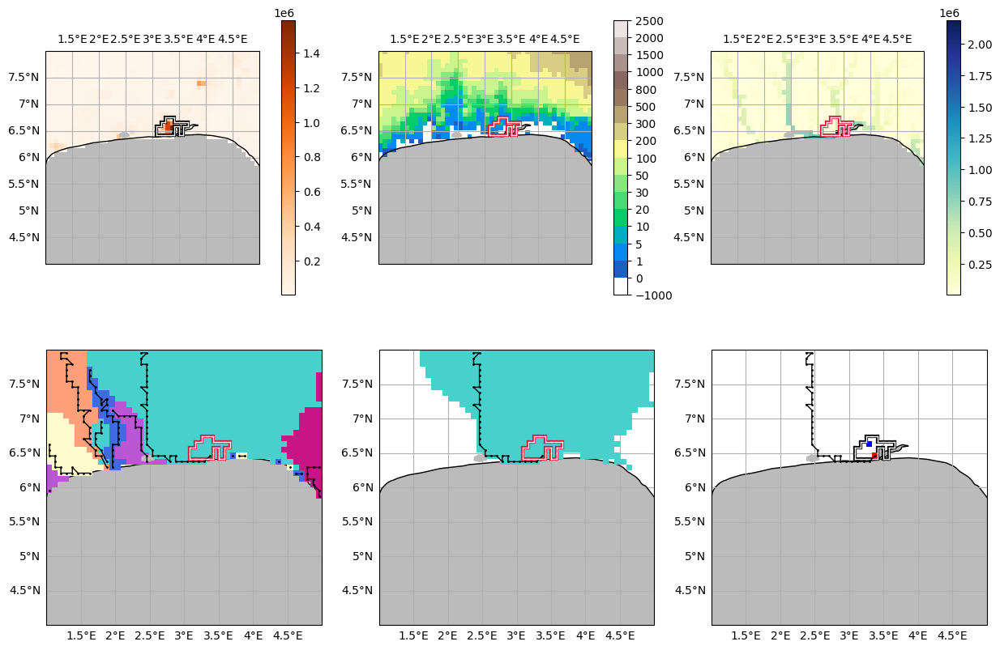

Guangzhou, Guangdong


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


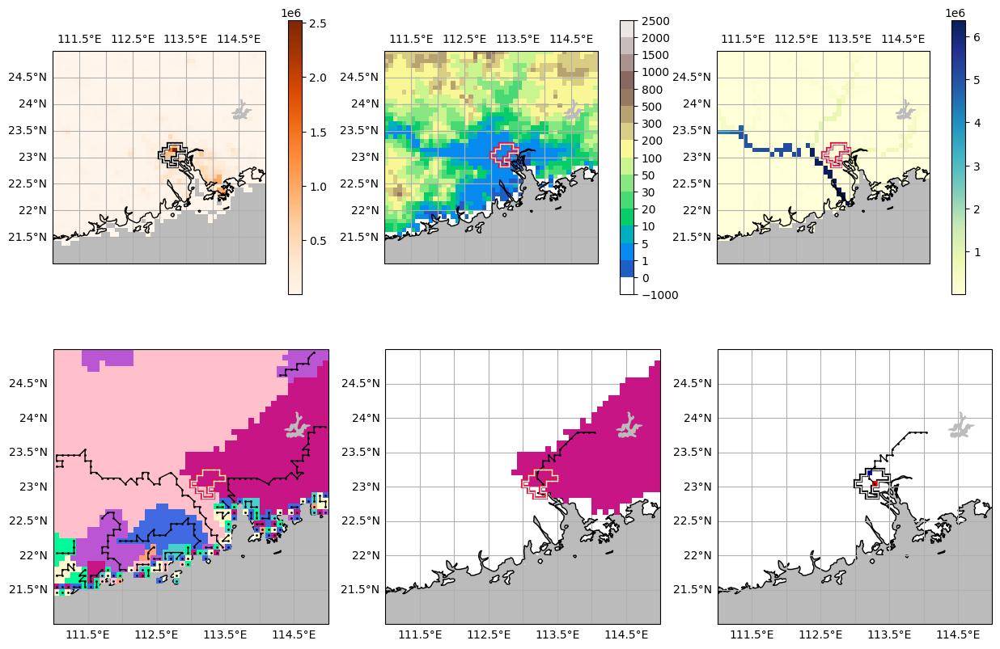

Shenzhen


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


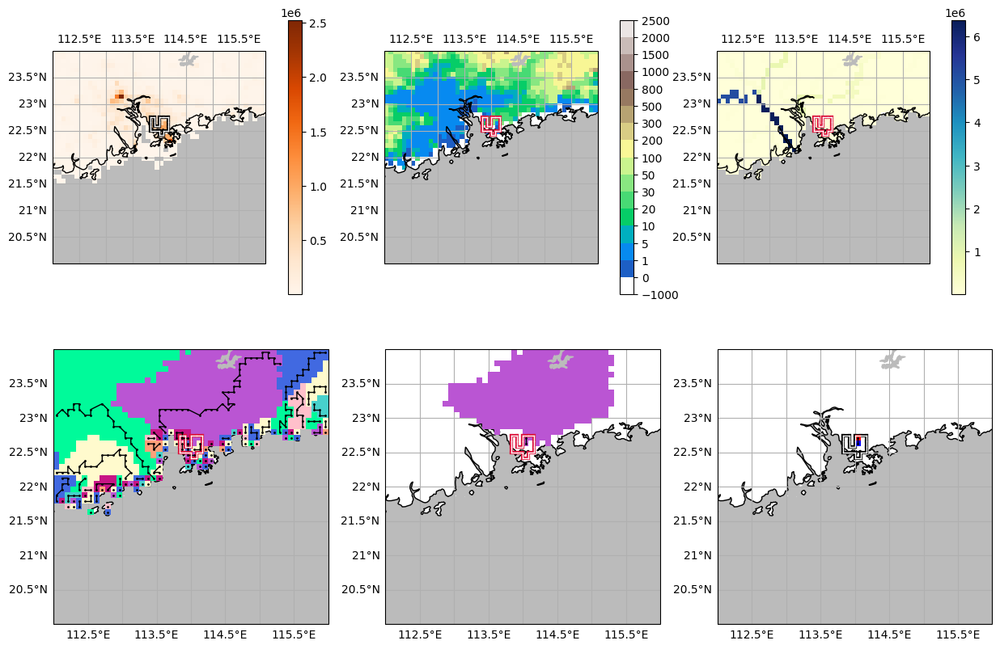

Tianjin


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


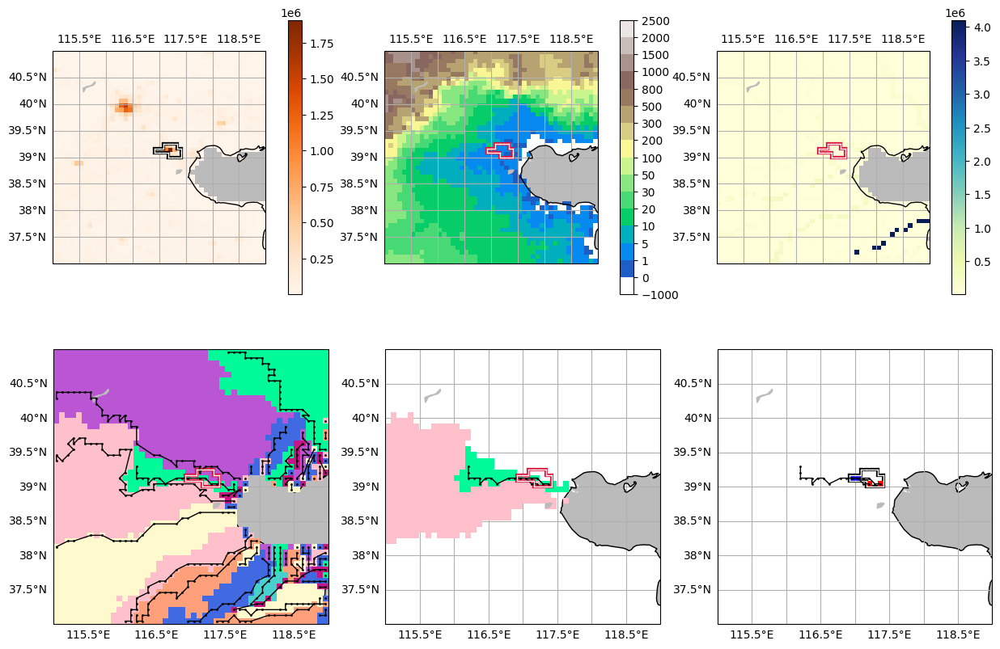

Seoul


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


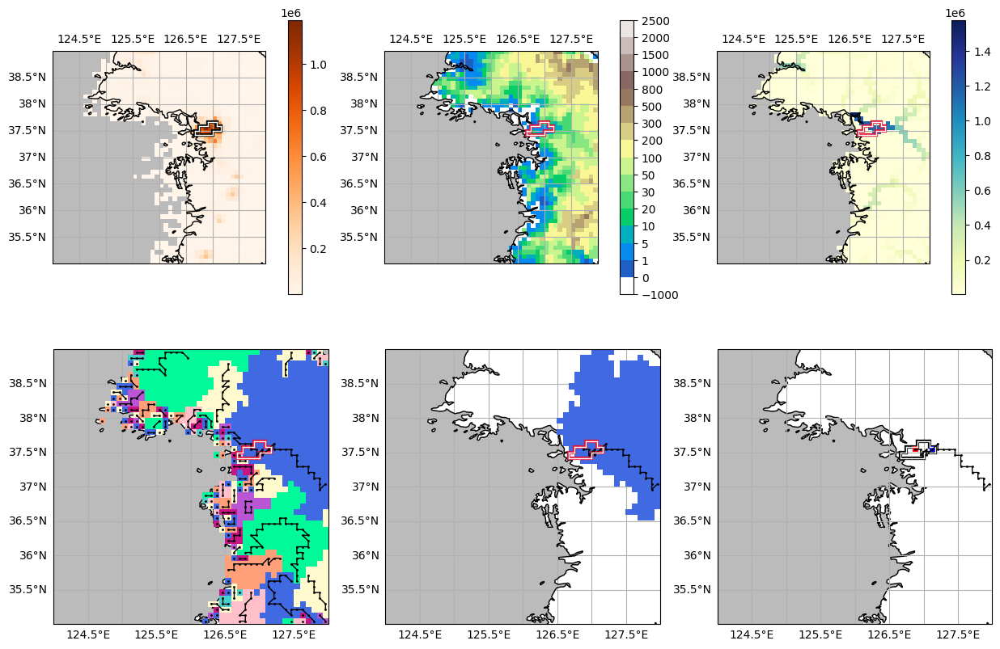

Jakarta


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


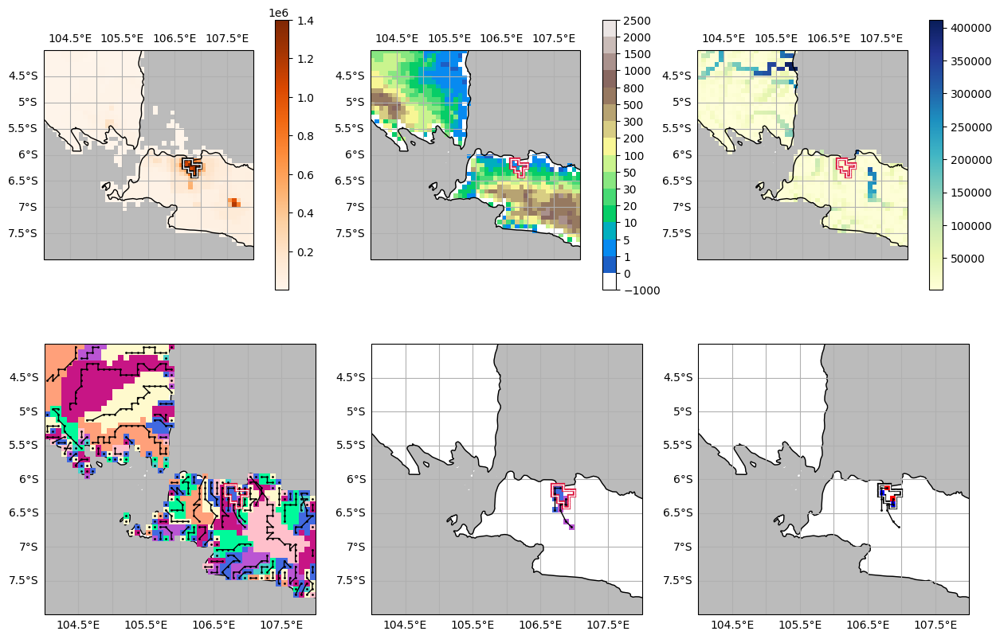

Kinshasa


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


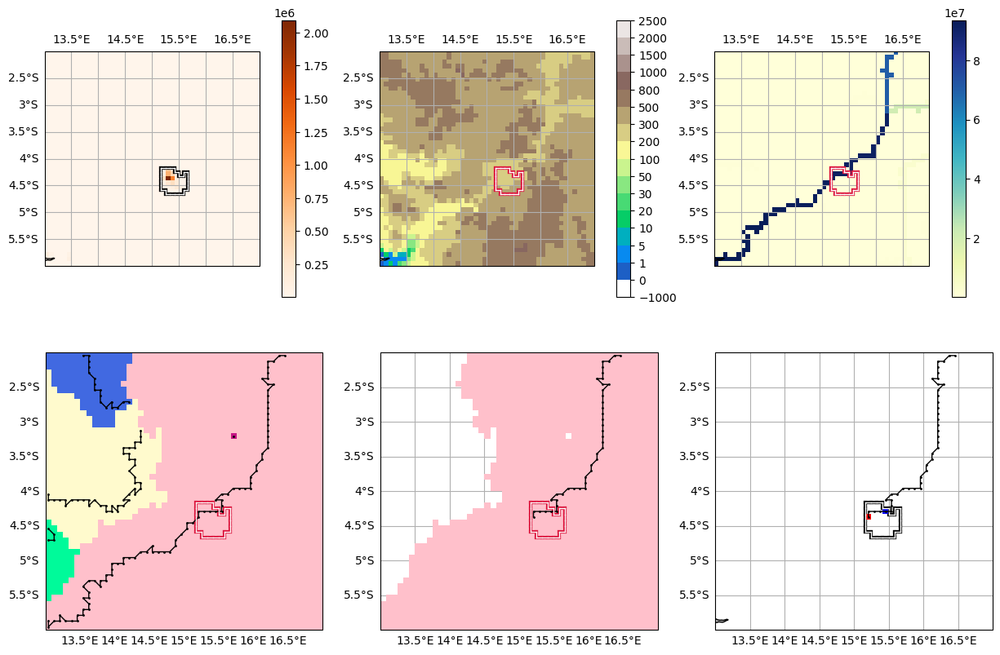

Chukyo M.M.A. (Nagoya)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


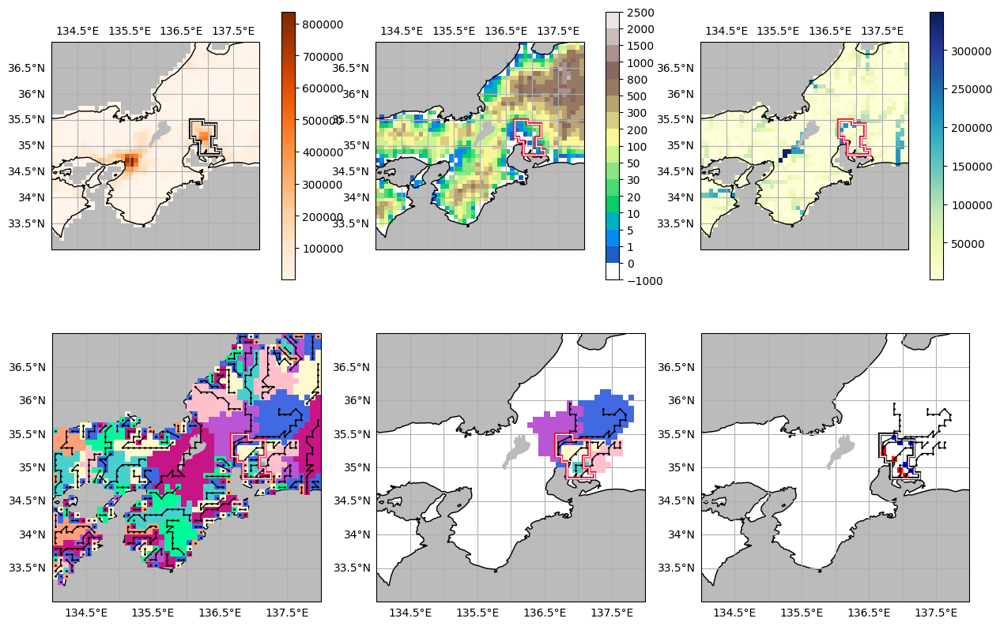

Lima


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


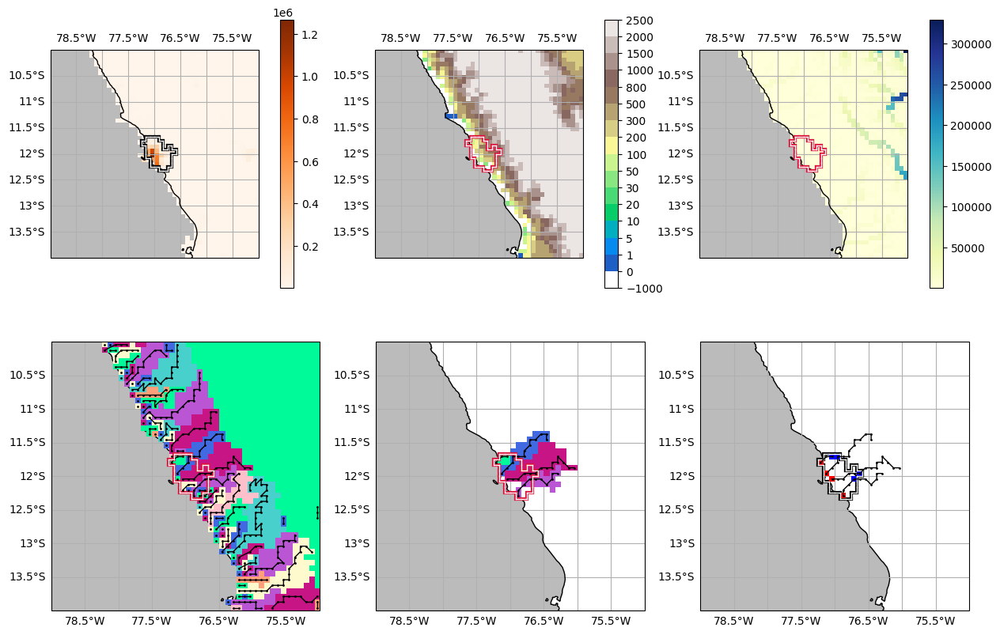

Chicago


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


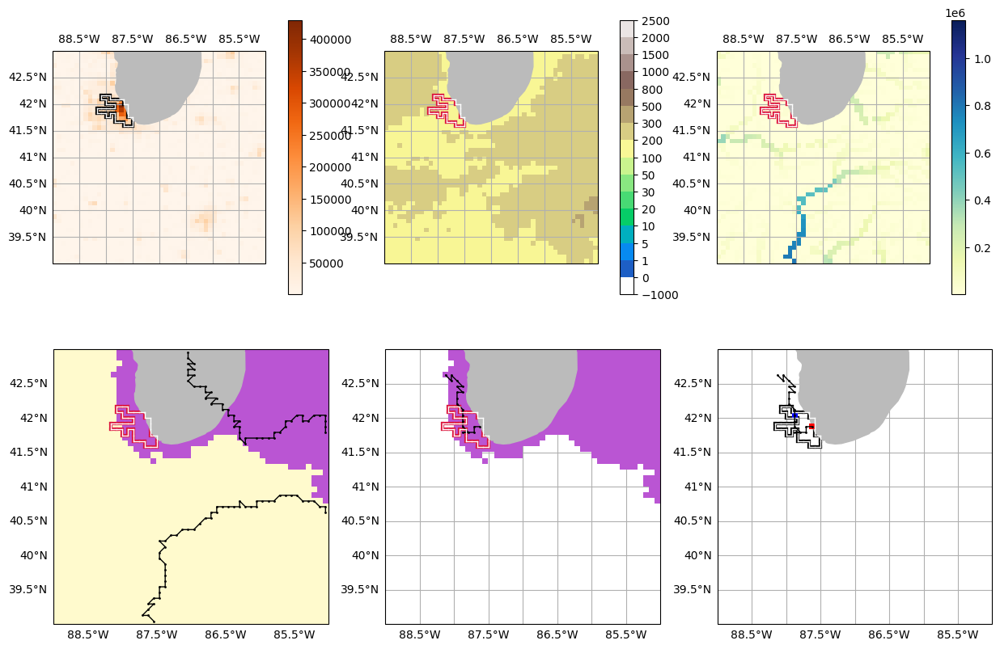

Chennai (Madras)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


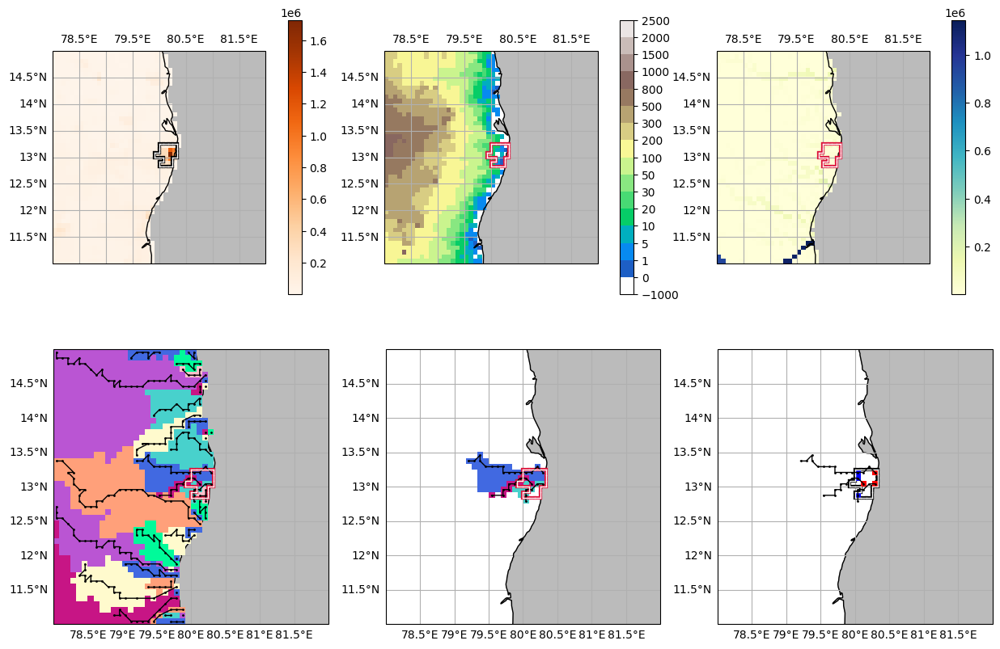

Lahore


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


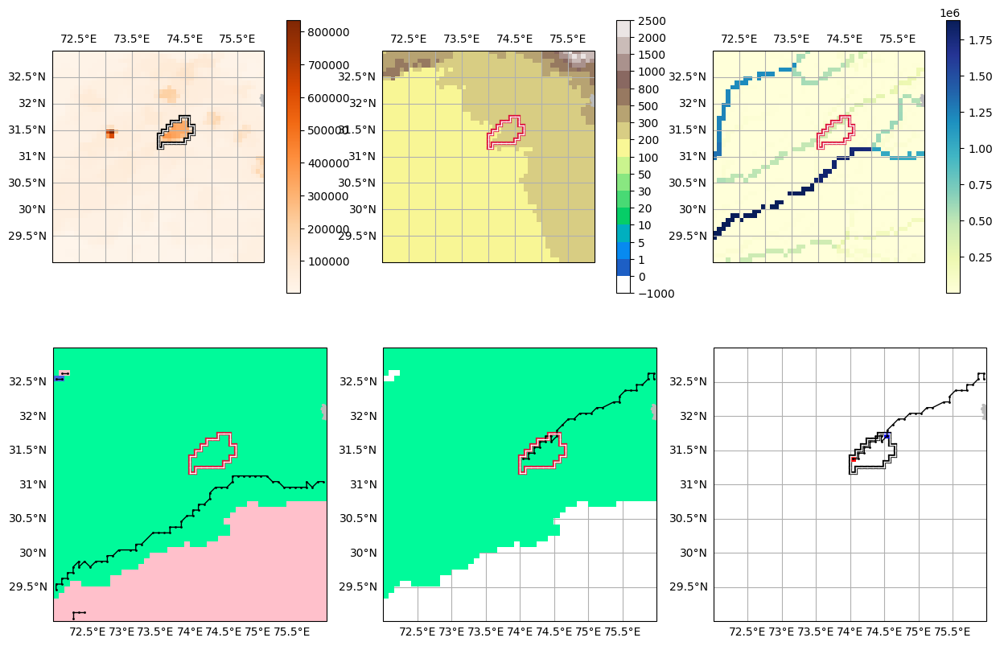

Bogotá


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


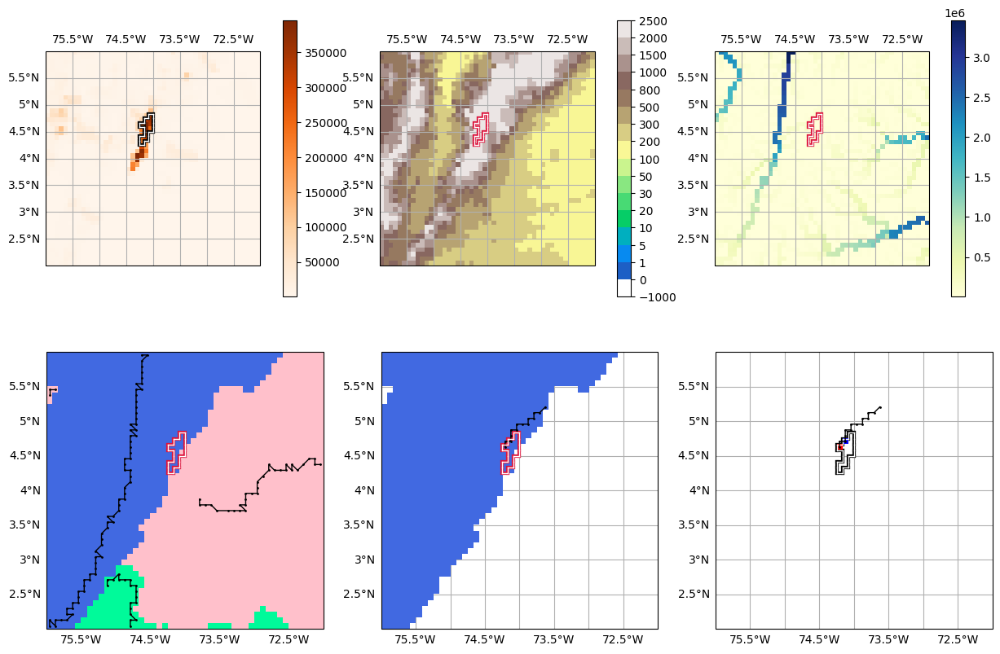

Bangalore


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


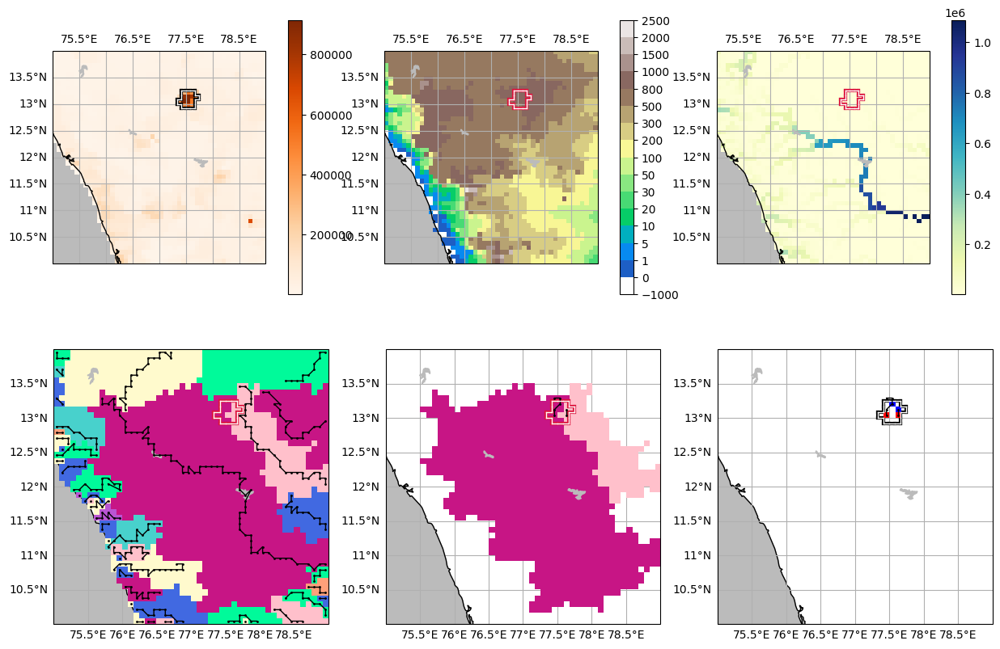

Krung Thep (Bangkok)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


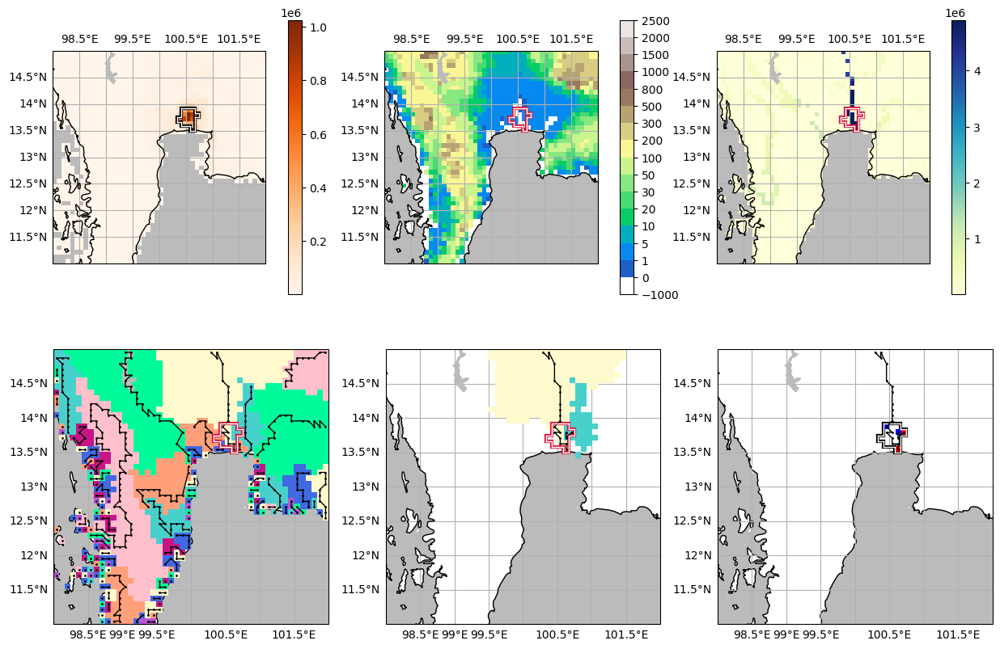

Tehran


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


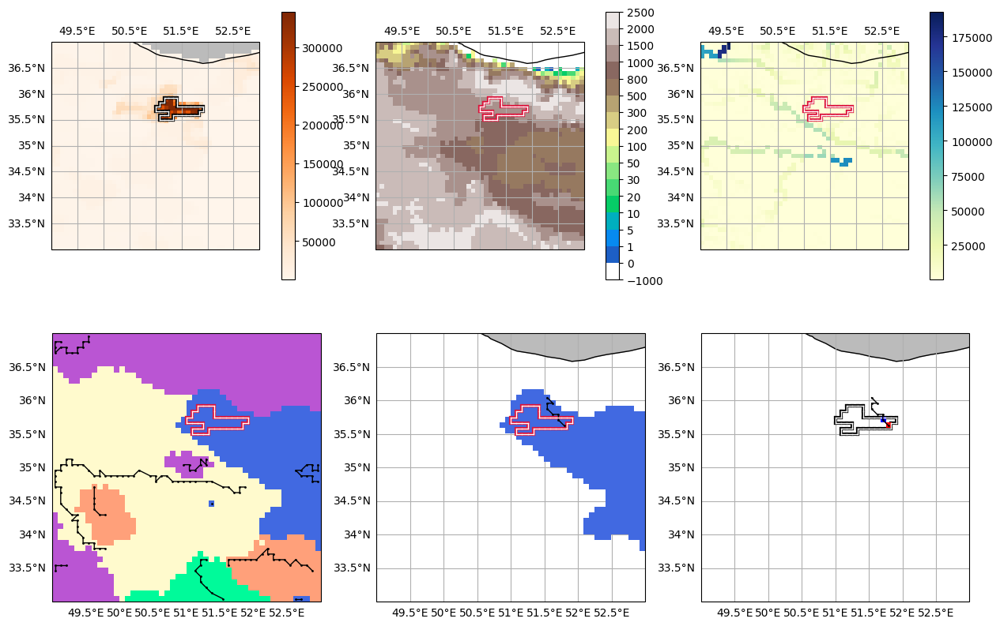

London


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


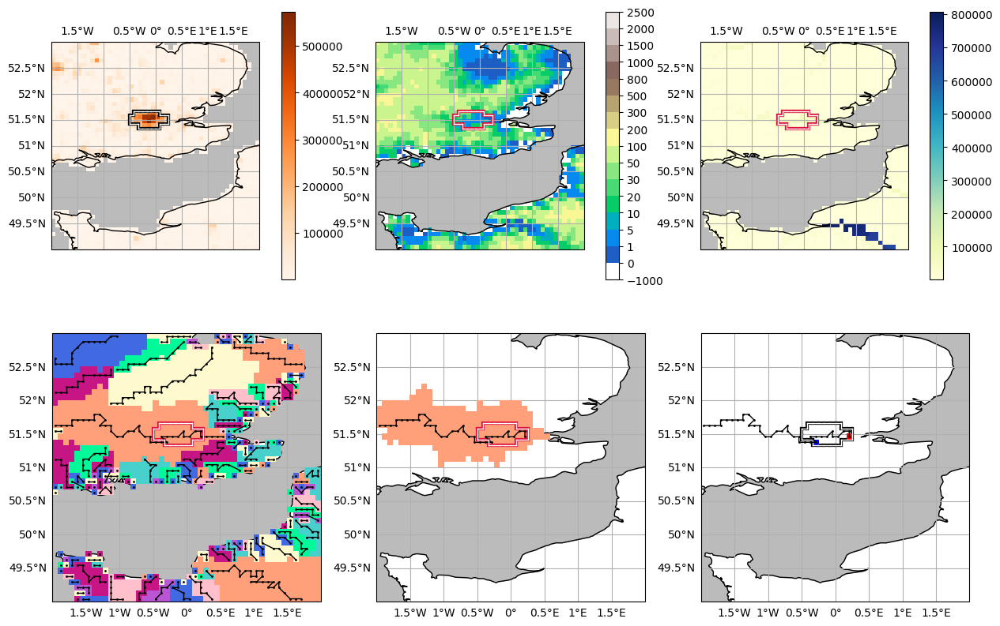

Chengdu
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


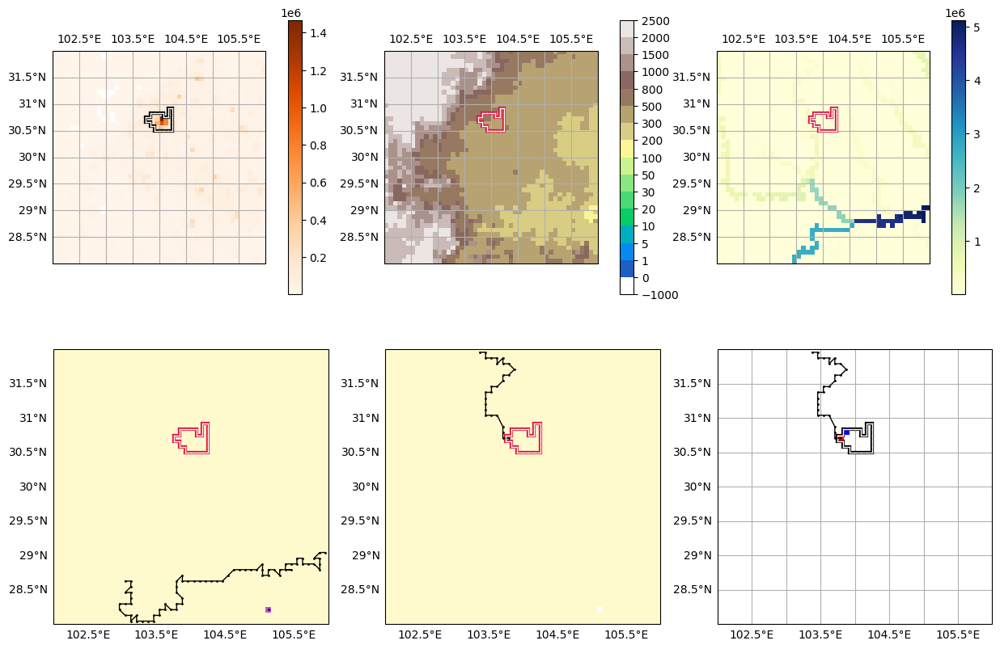

Hyderabad


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


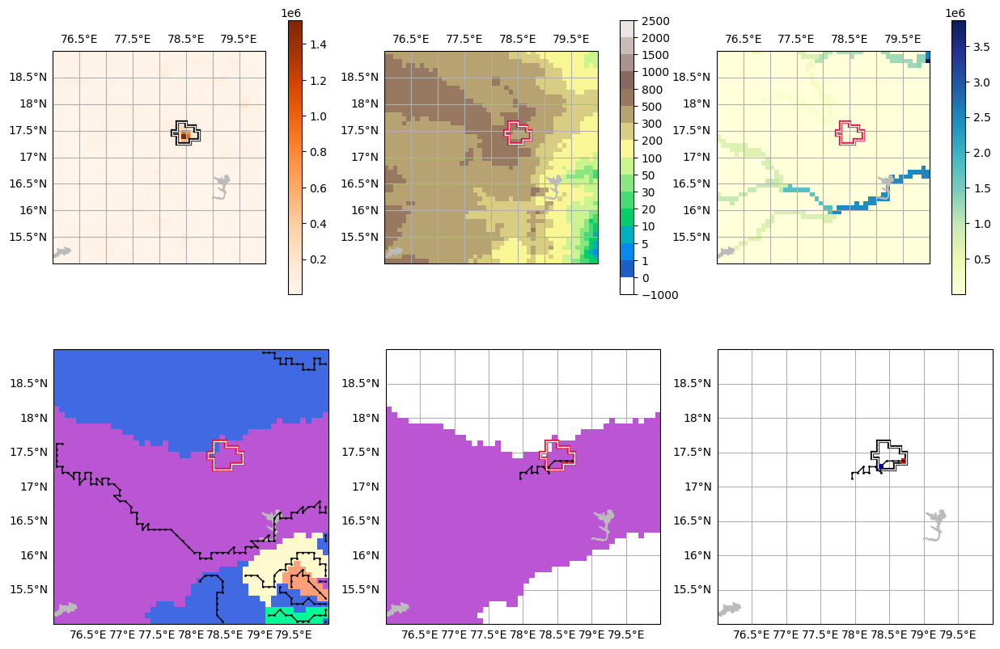

Wuhan


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


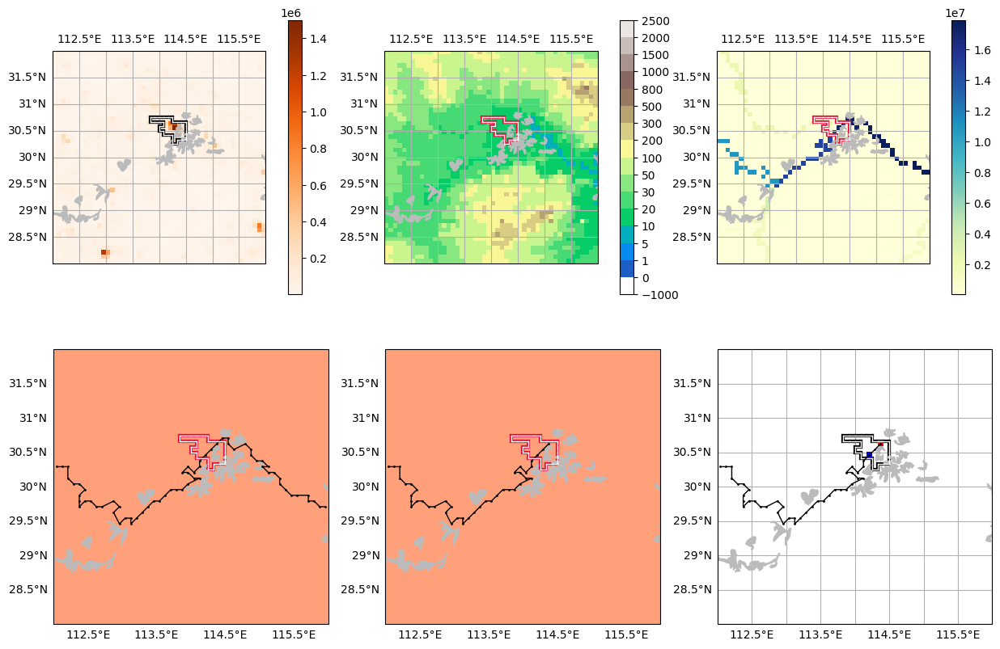

Dongguan


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


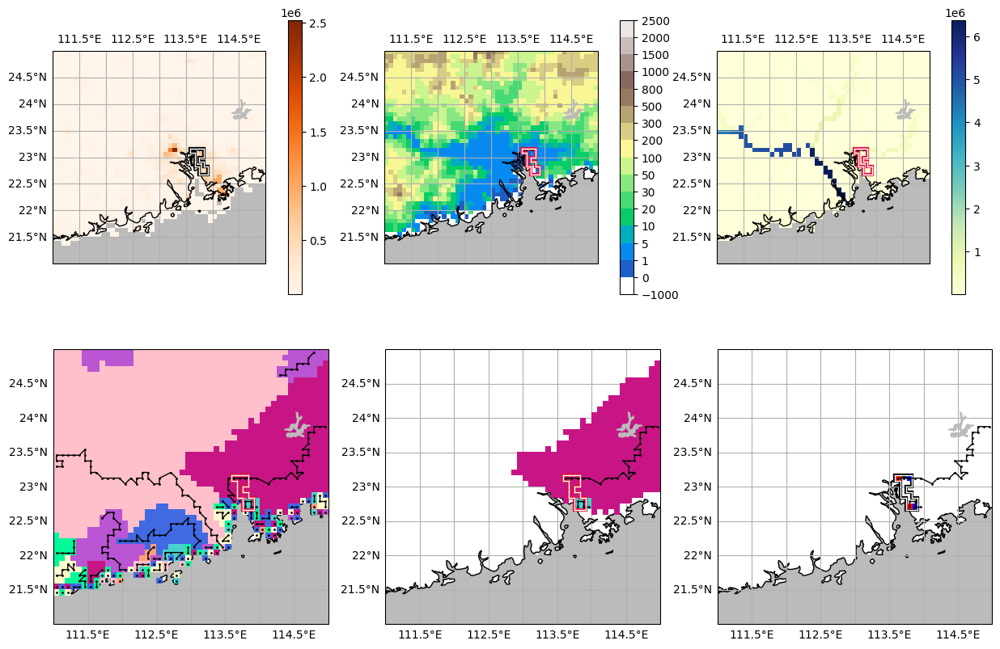

Hong Kong
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


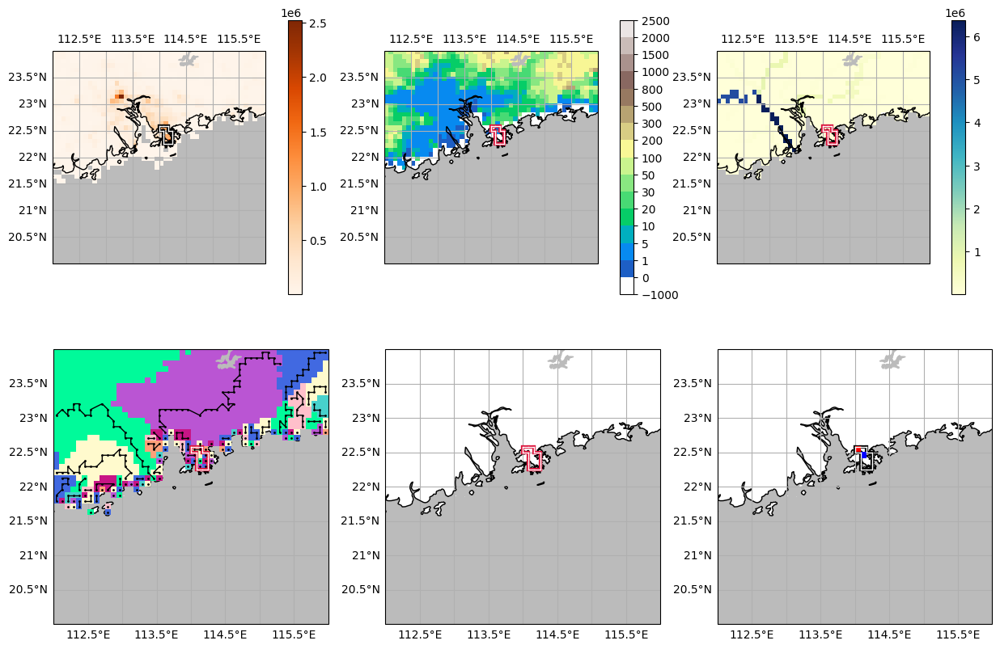

Foshan
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


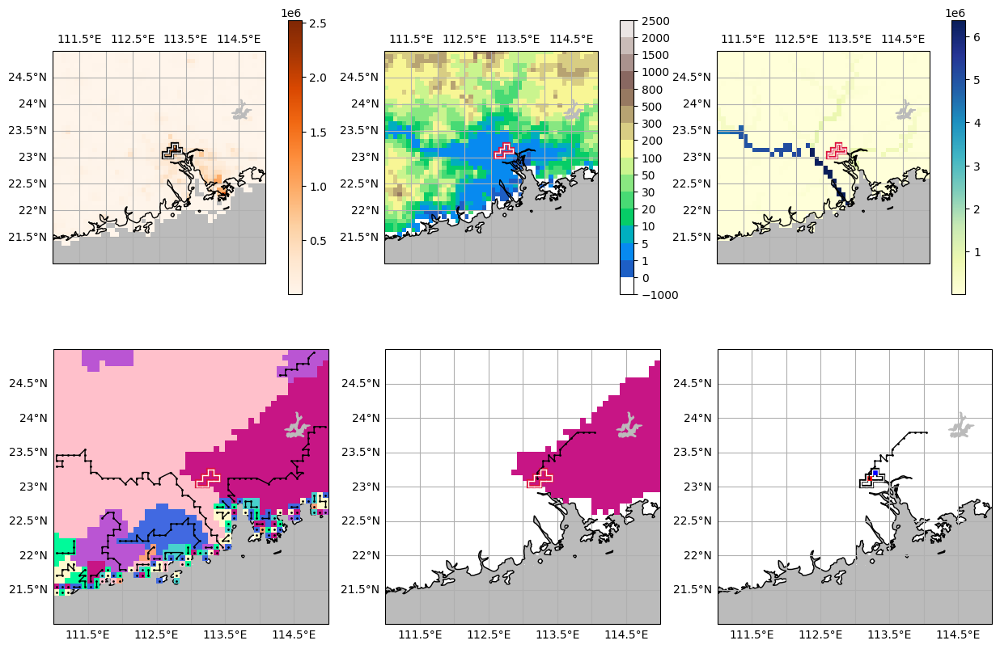

Santiago


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


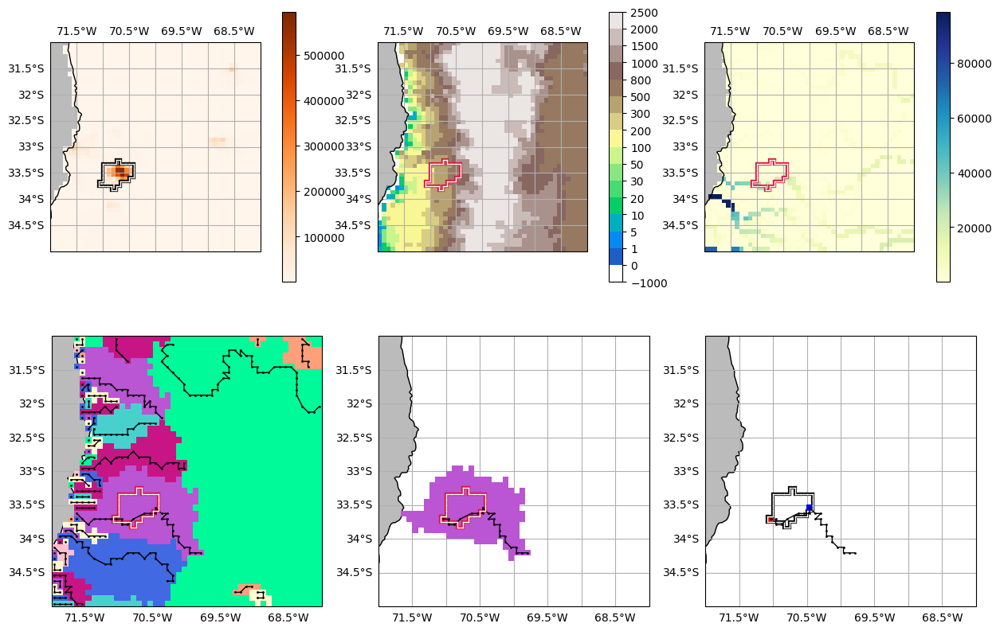

Ahmadabad


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


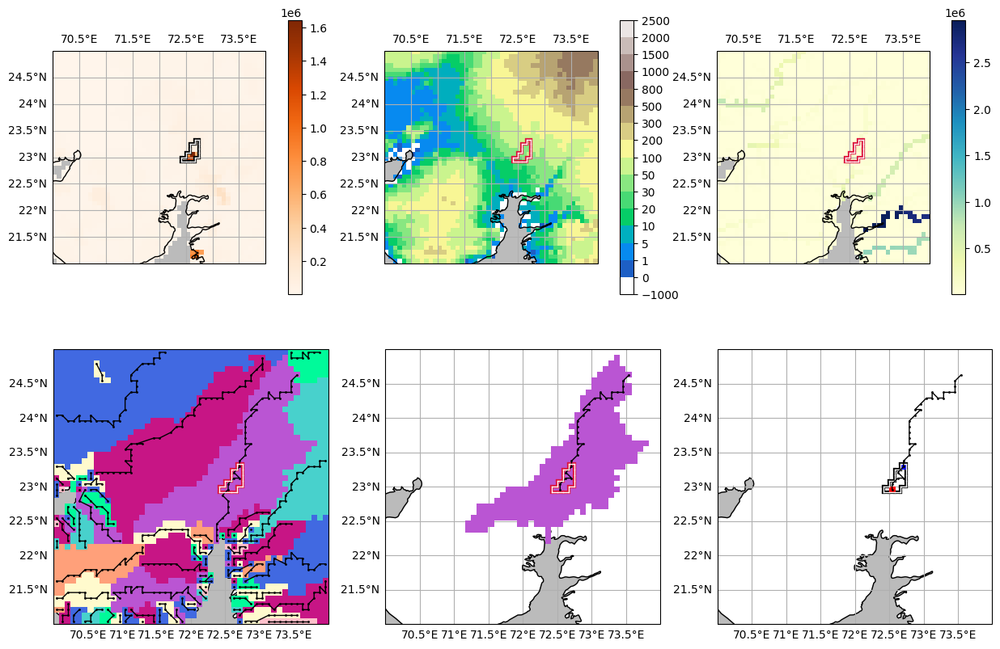

Thành Pho Ho Chí Minh (Ho Chi Minh City)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


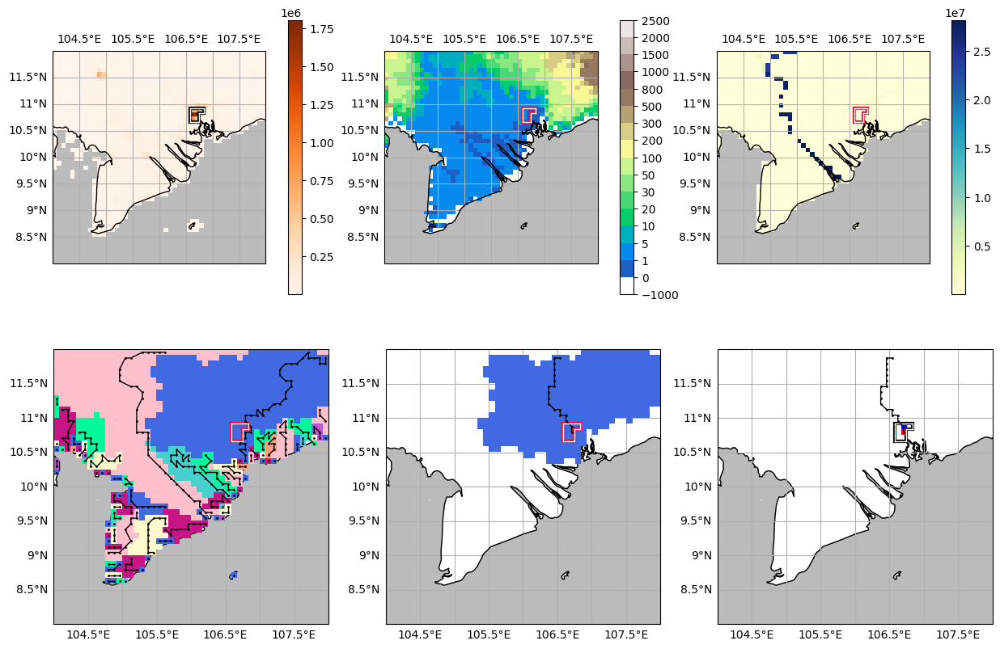

Nanjing, Jiangsu


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


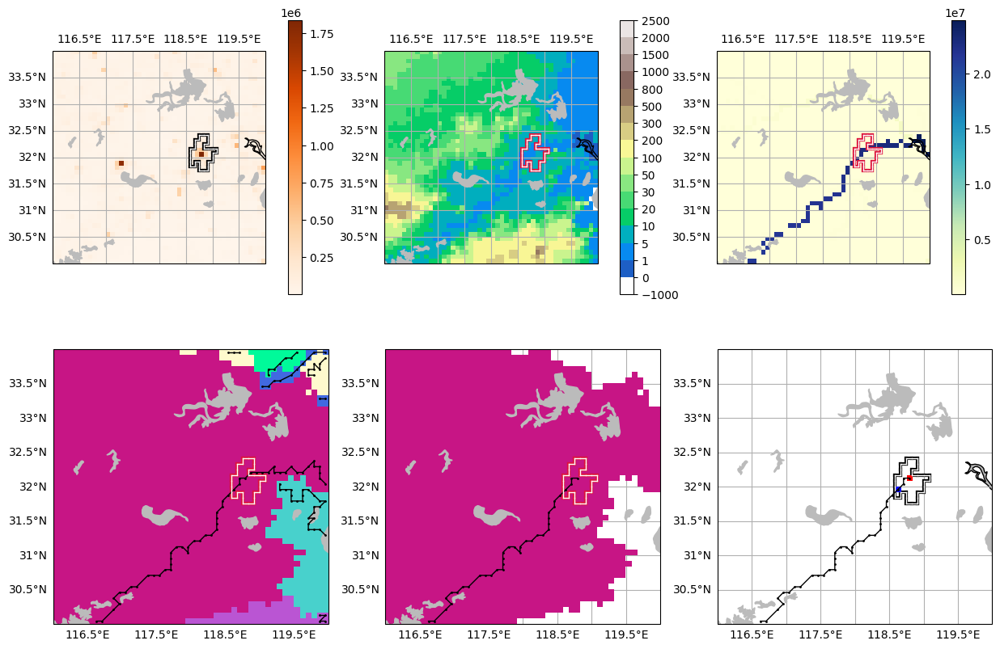

Shenyang


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


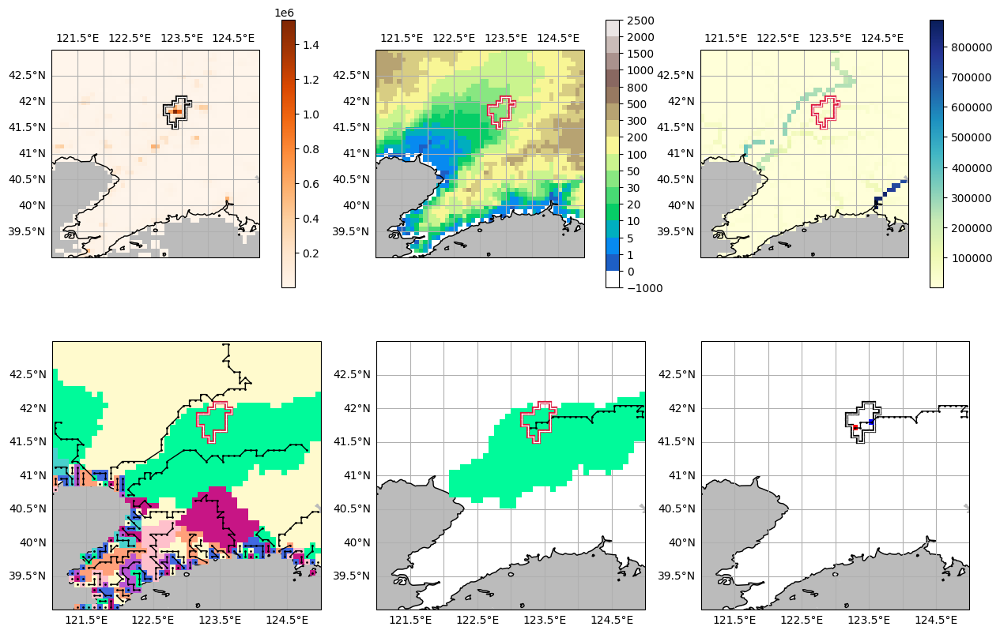

Kuala Lumpur


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


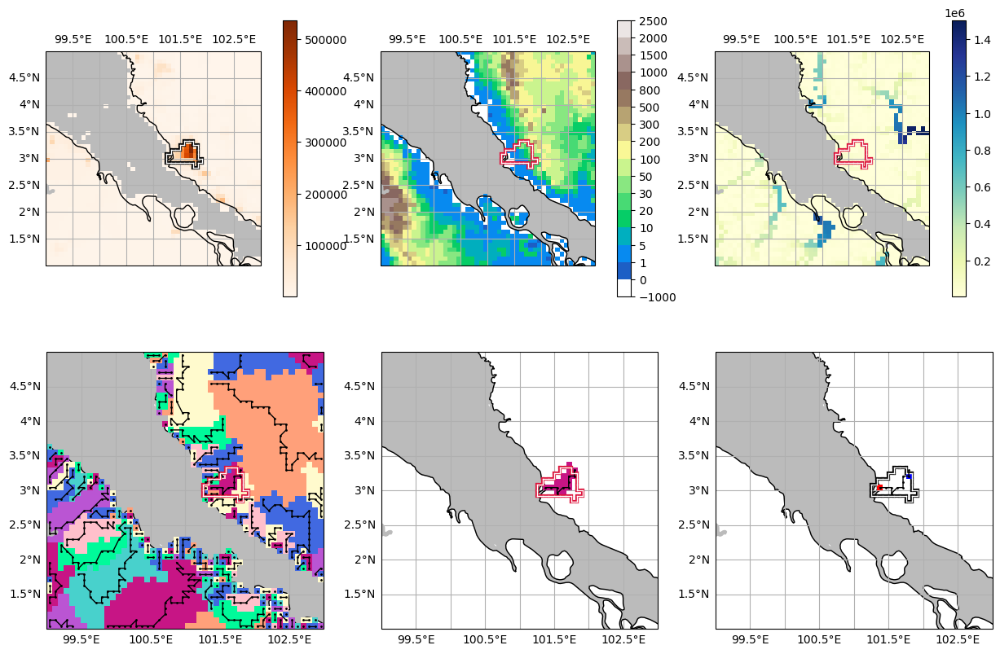

Madrid


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


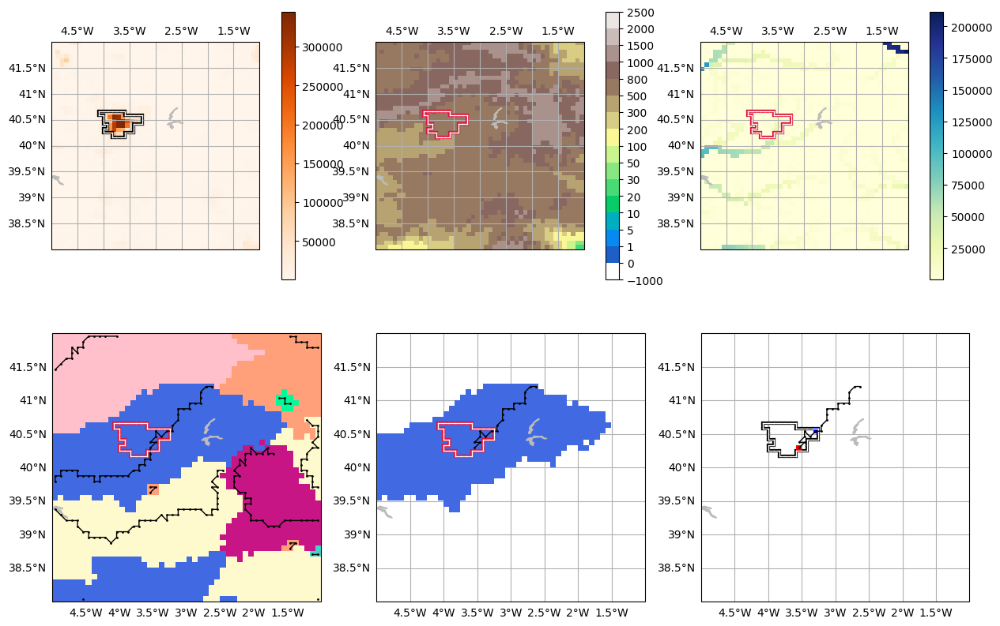

Hangzhou


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


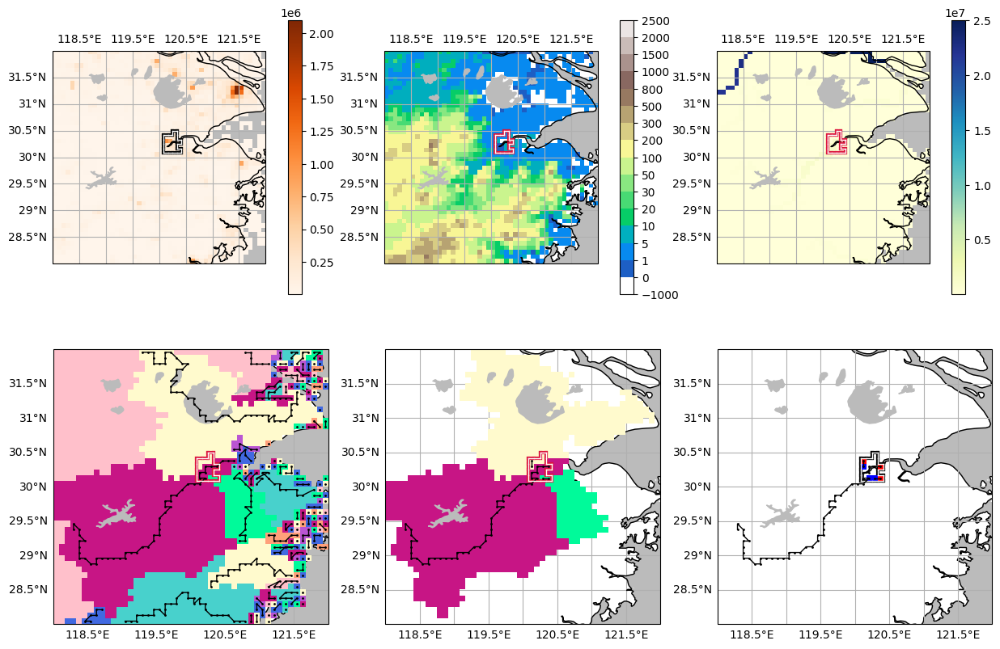

Baghdad


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


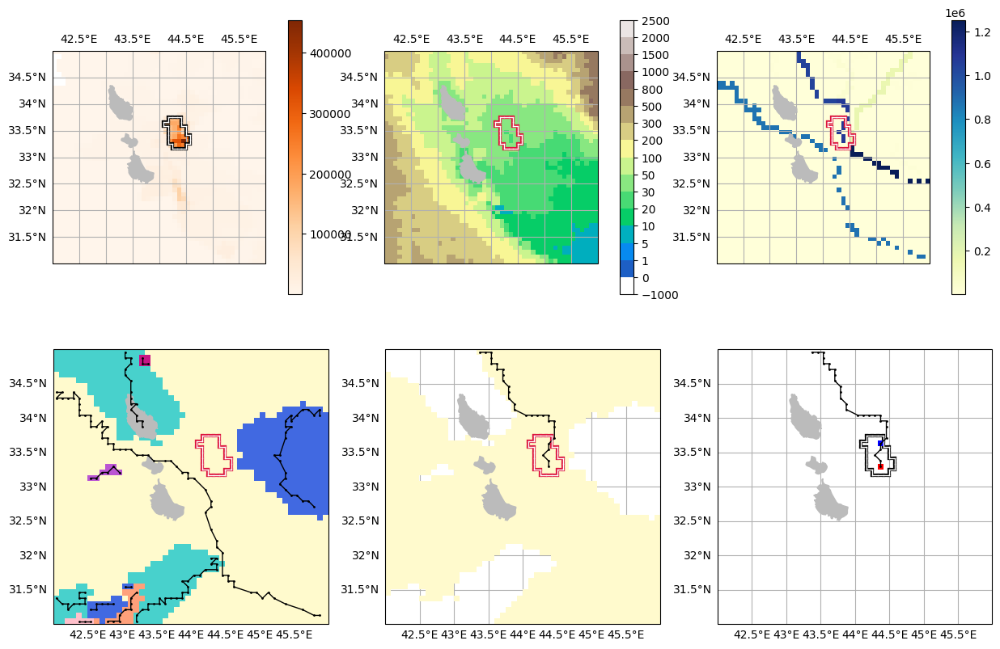

Xi'an, Shaanxi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


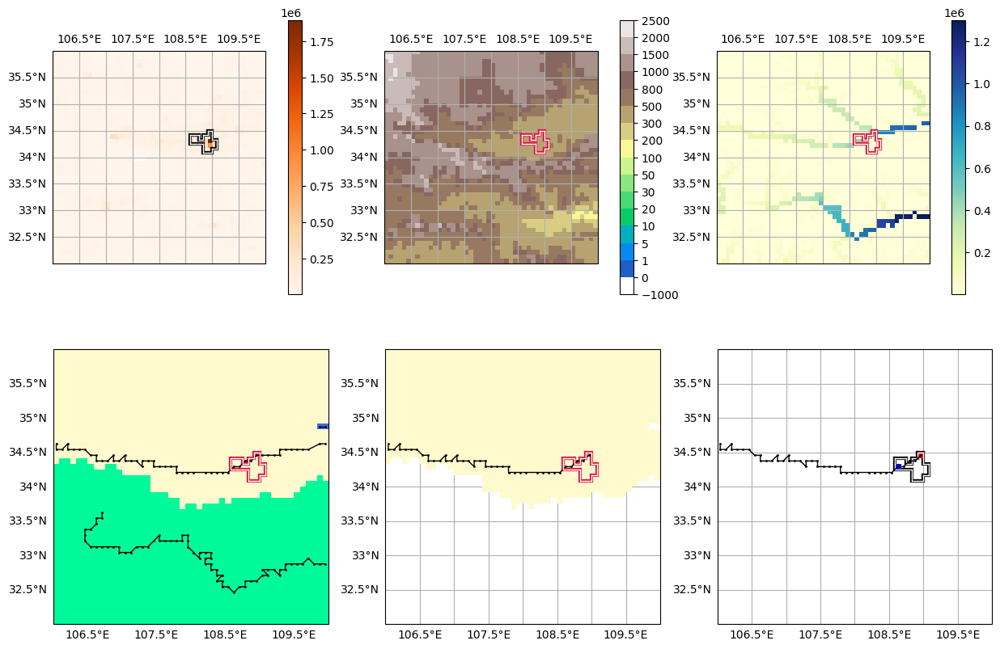

Kitakyushu-Fukuoka M.M.A.
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


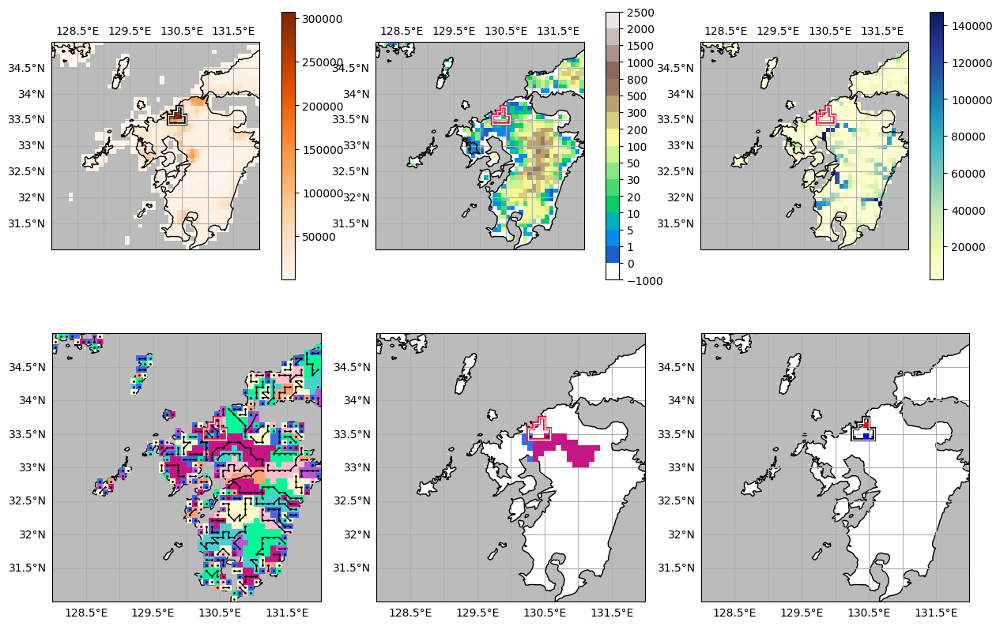

Miami
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


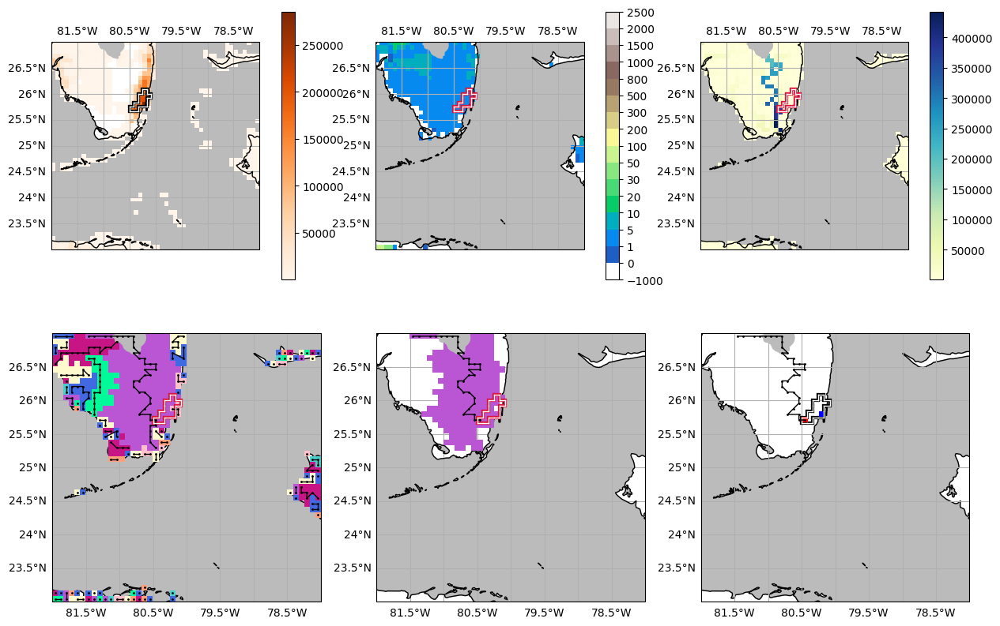

Toronto


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


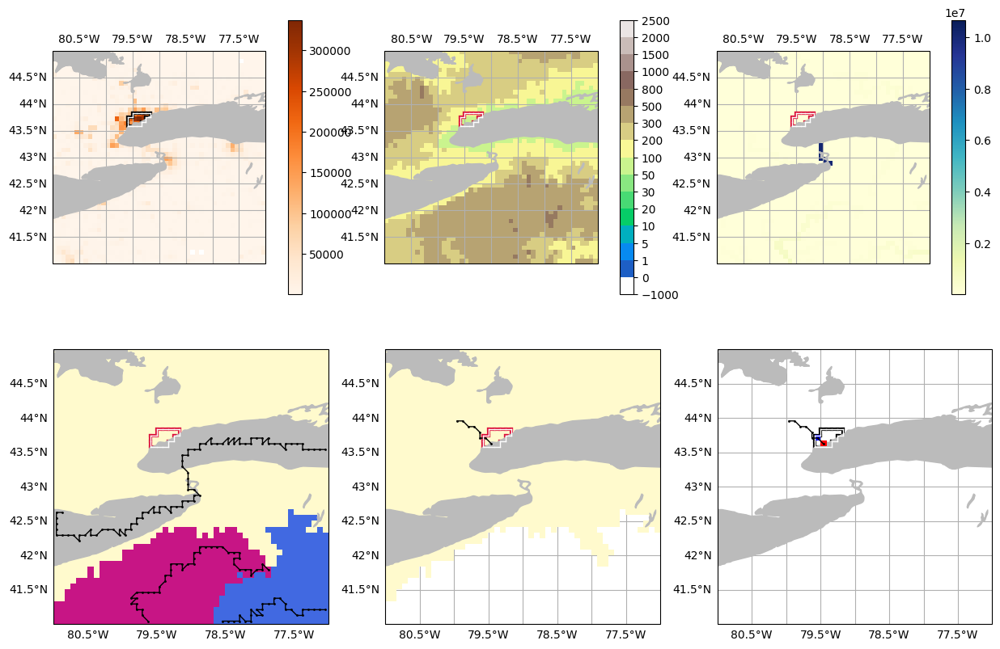

Philadelphia


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


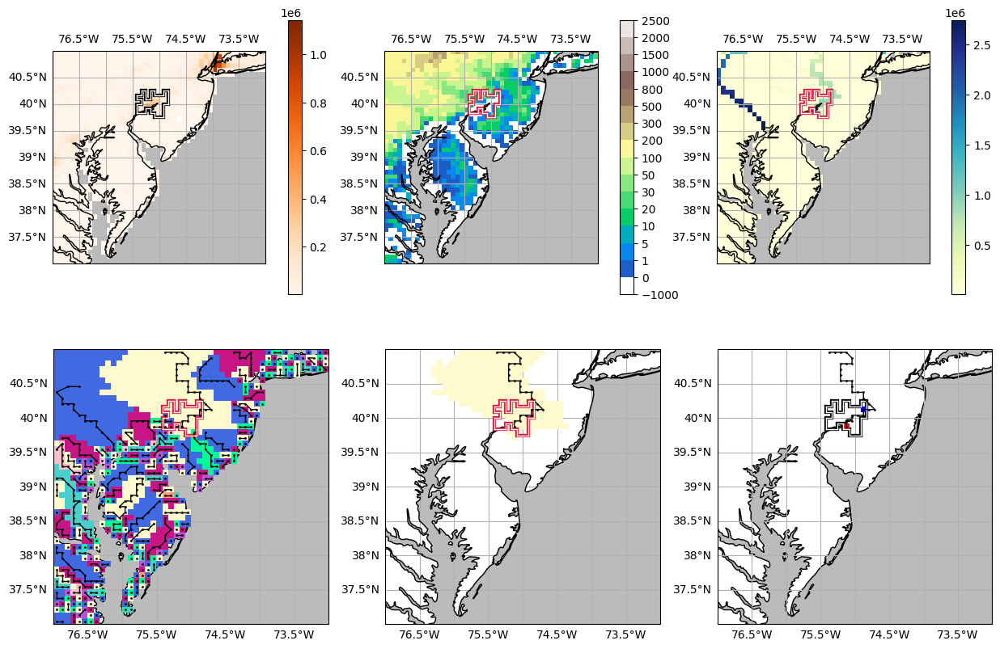

Belo Horizonte
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


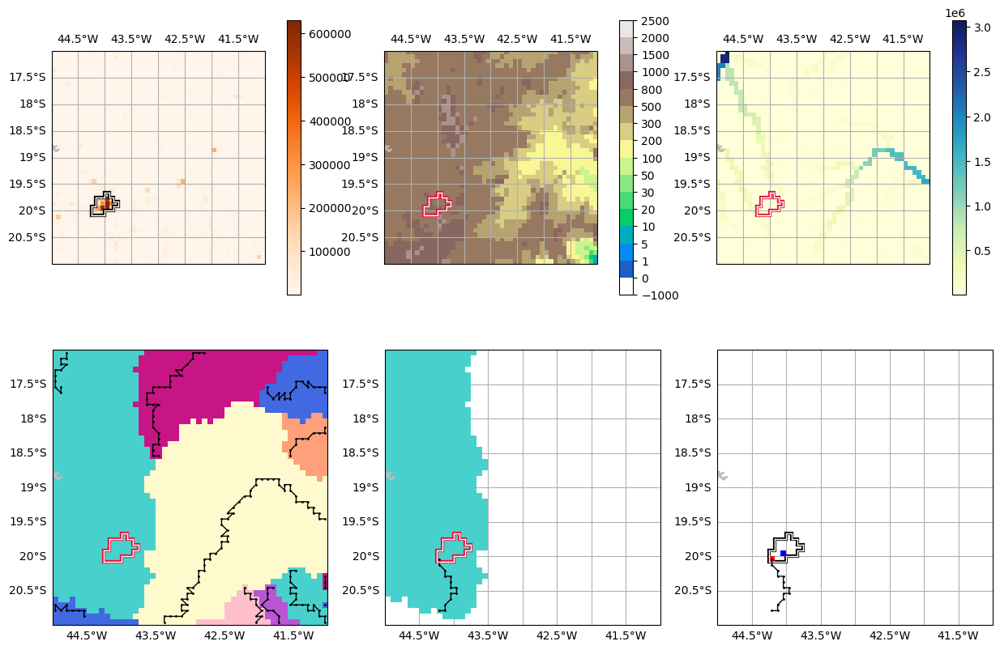

Luanda


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


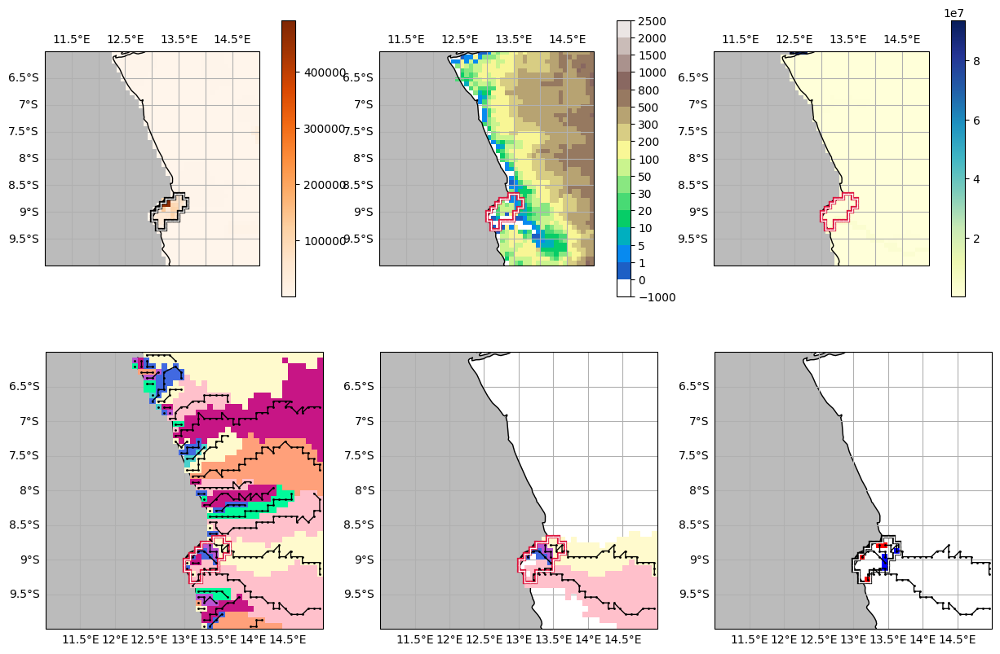

Ar-Riyadh (Riyadh)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


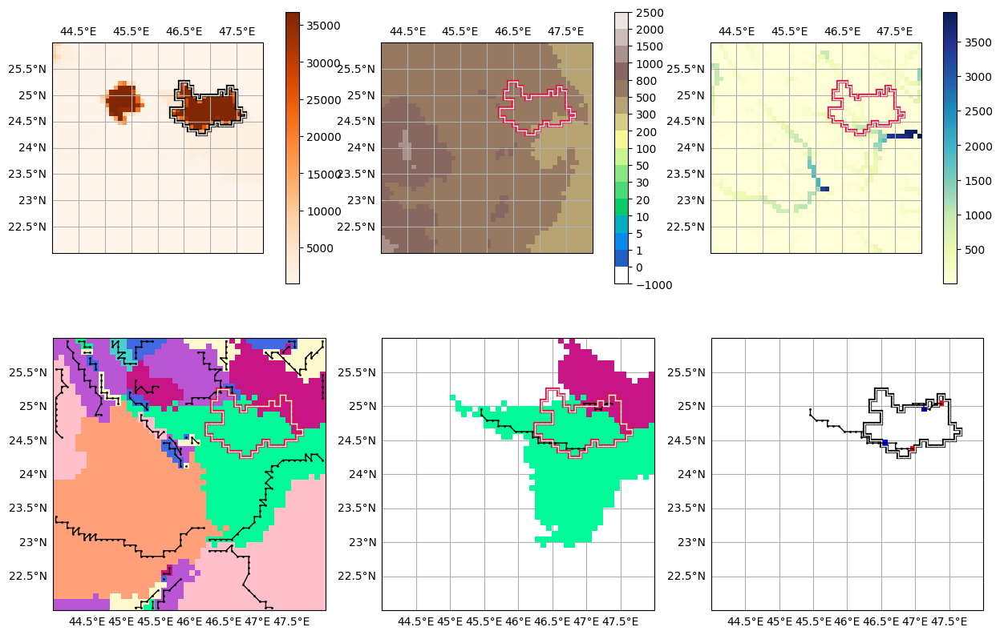

Dallas-Fort Worth


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


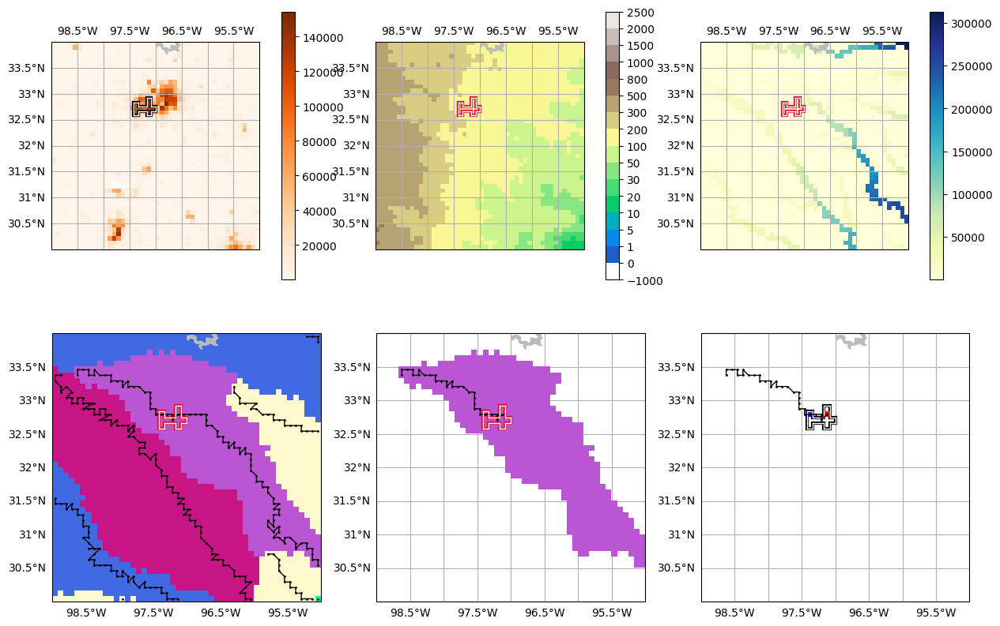

Haerbin


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


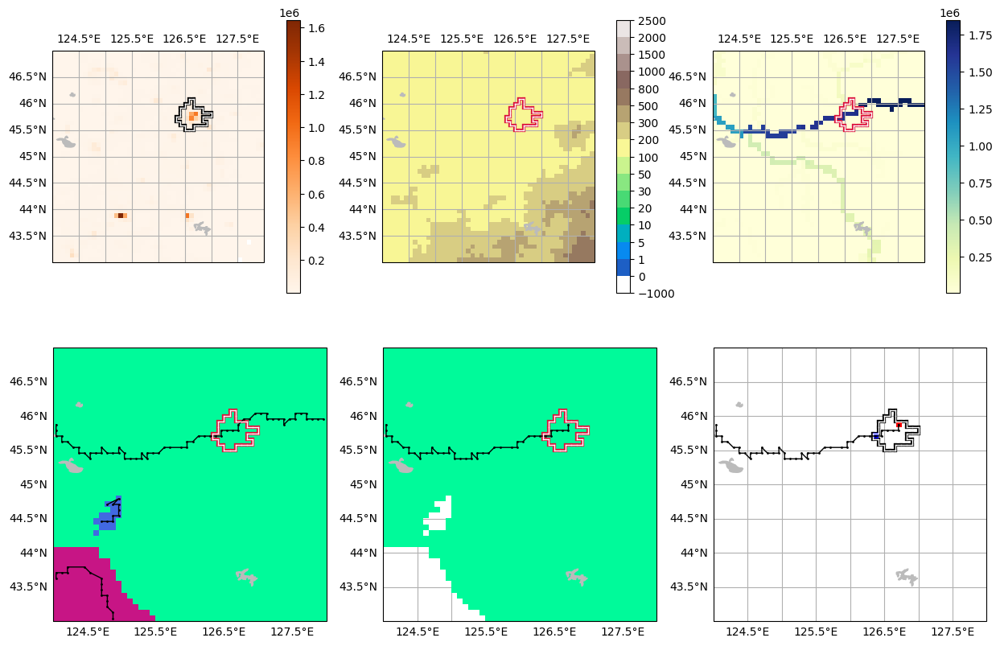

Singapore
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


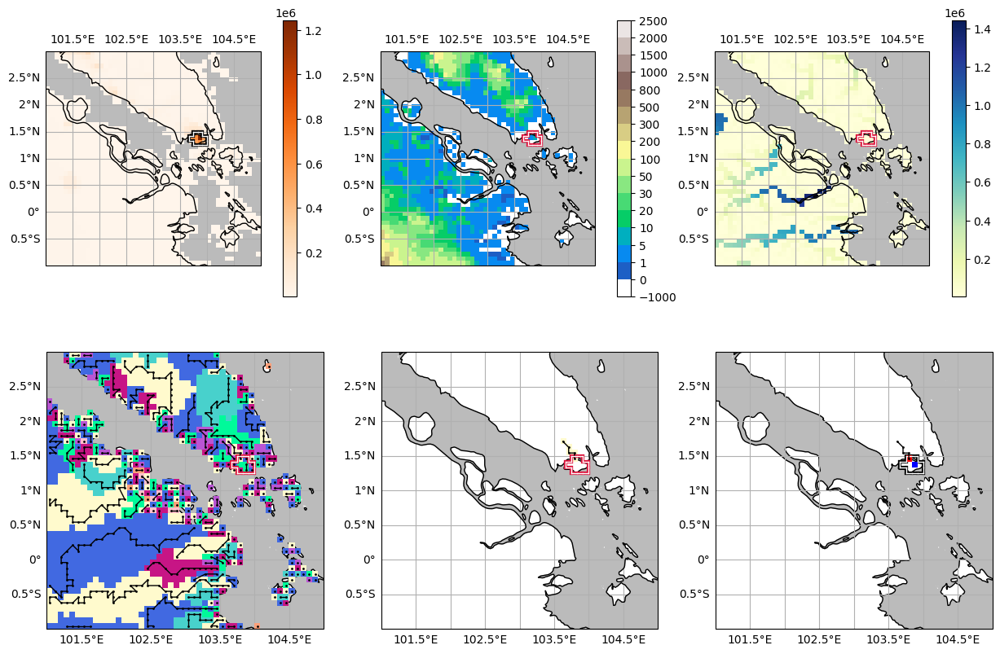

Houston


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


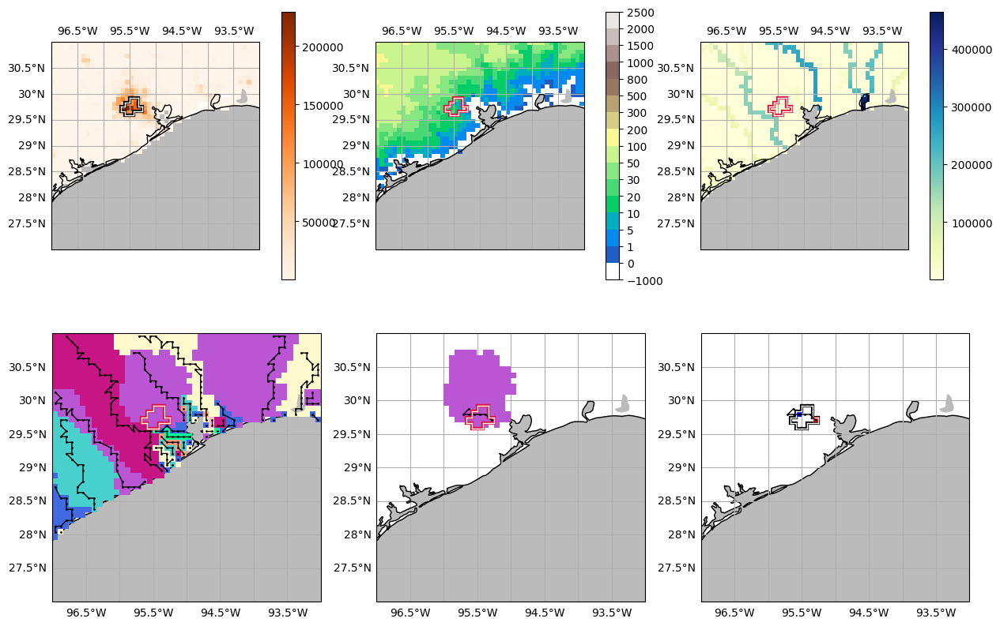

Pune (Poona)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


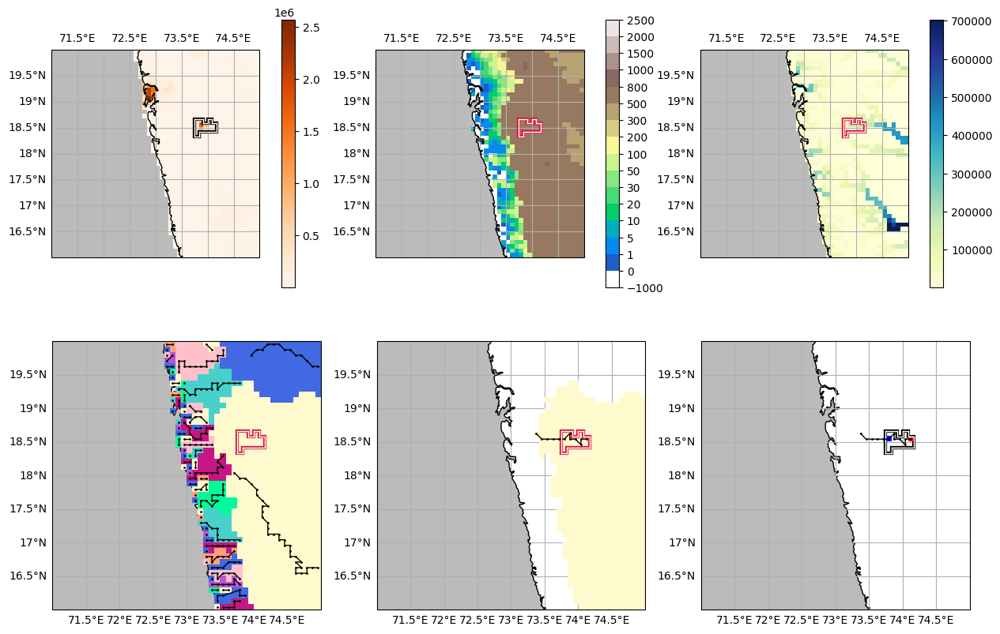

Barcelona


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


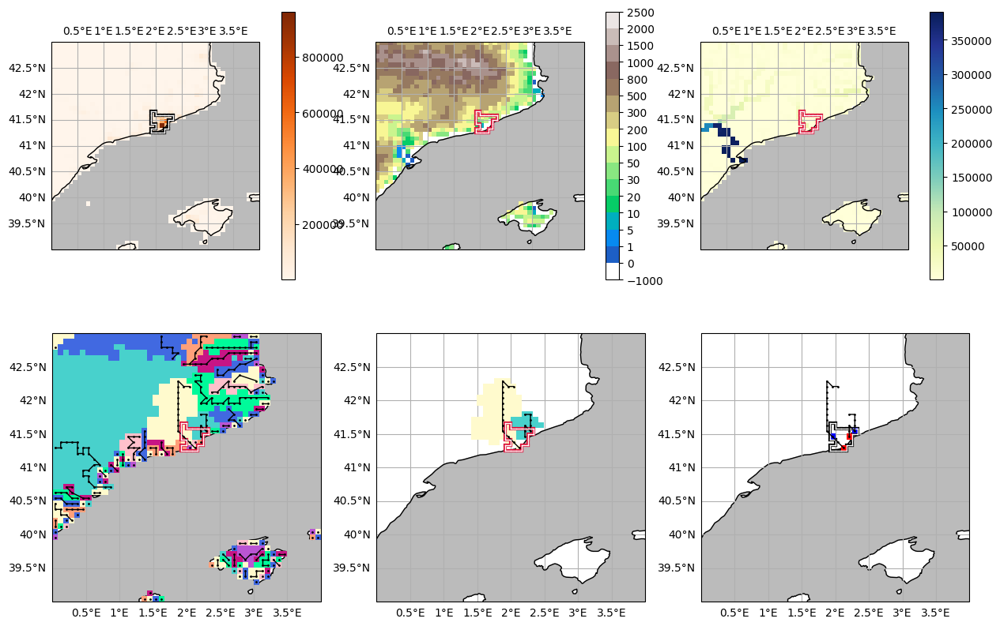

Sankt Peterburg (Saint Petersburg)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


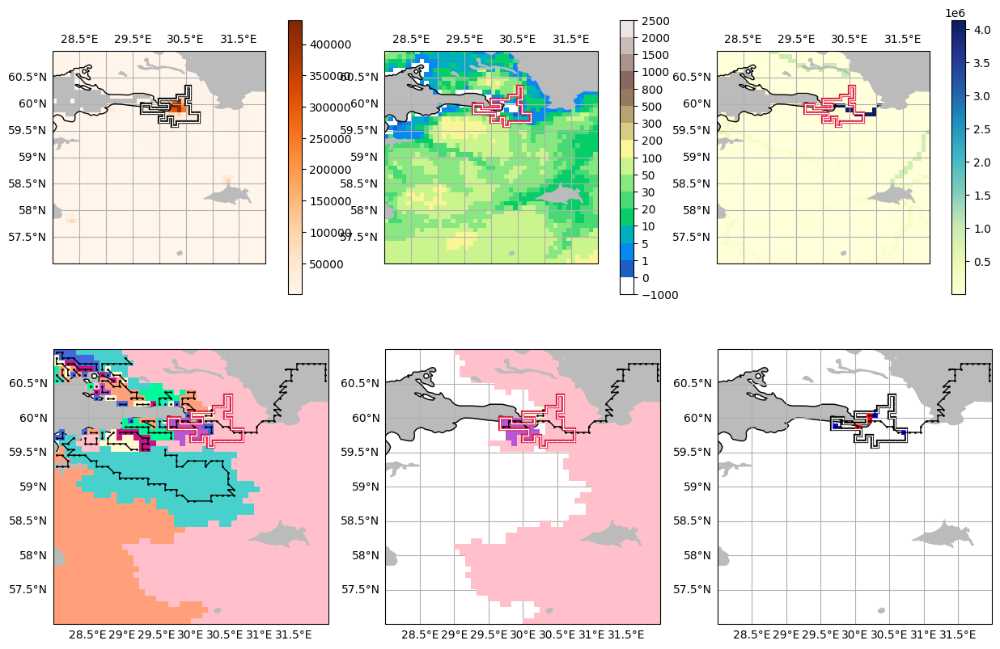

Washington, D.C.


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


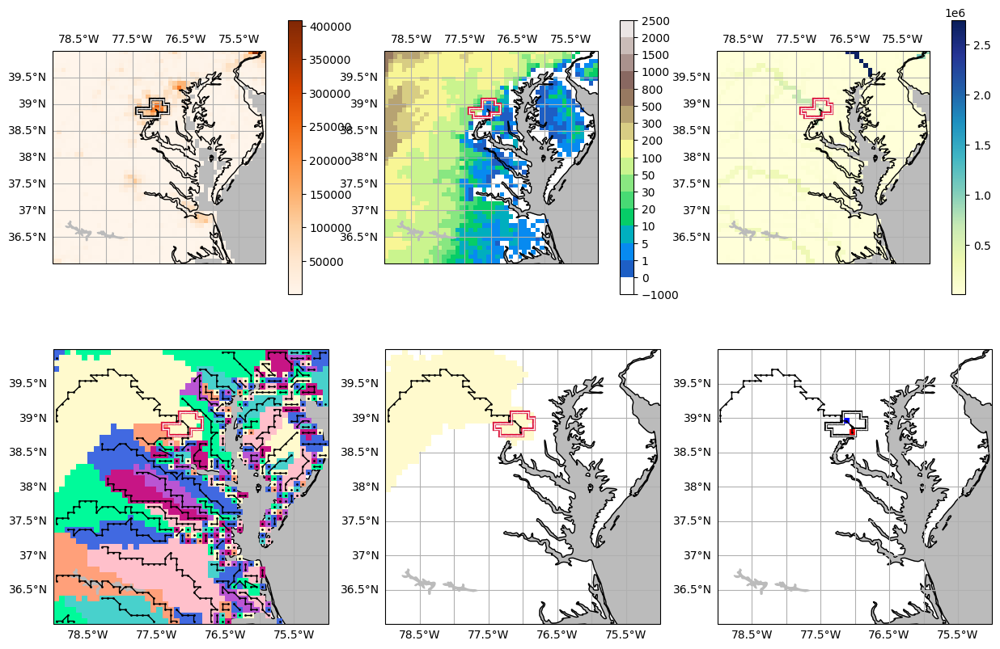

Atlanta


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


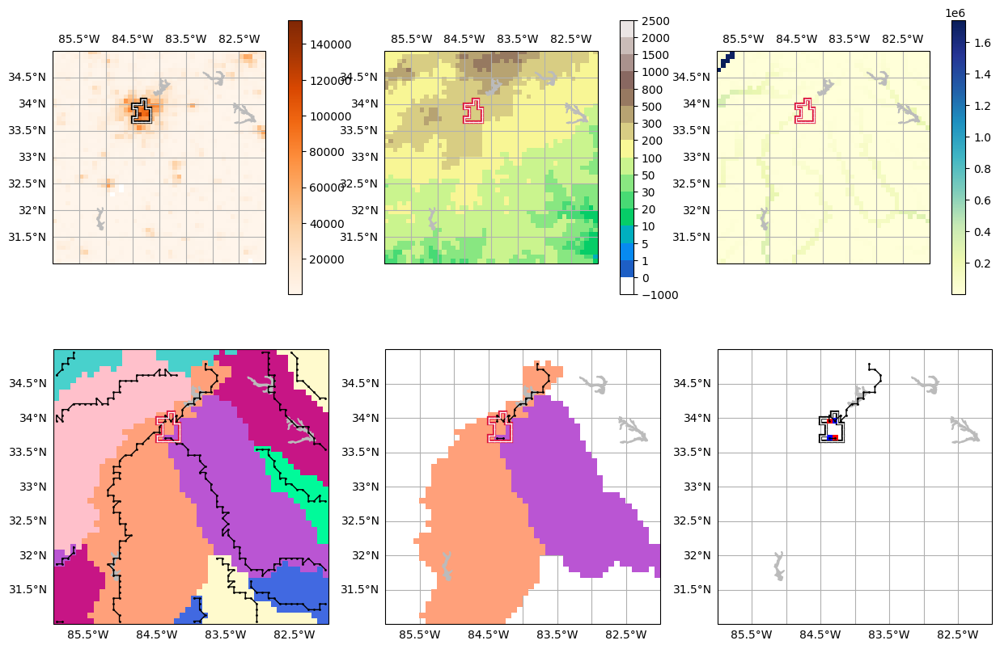

Al-Khartum (Khartoum)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


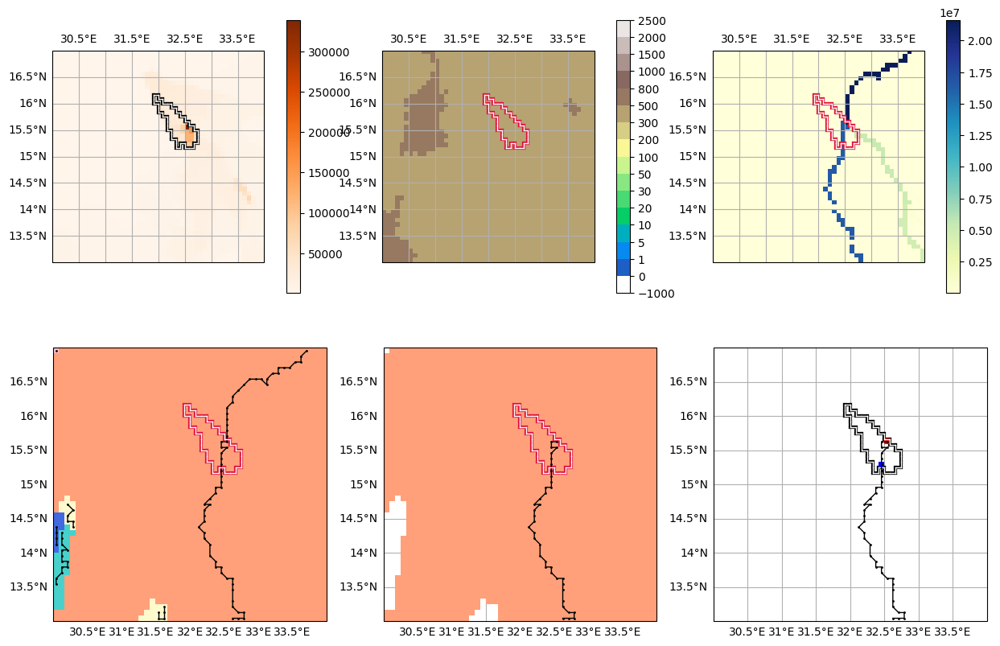

Qingdao


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


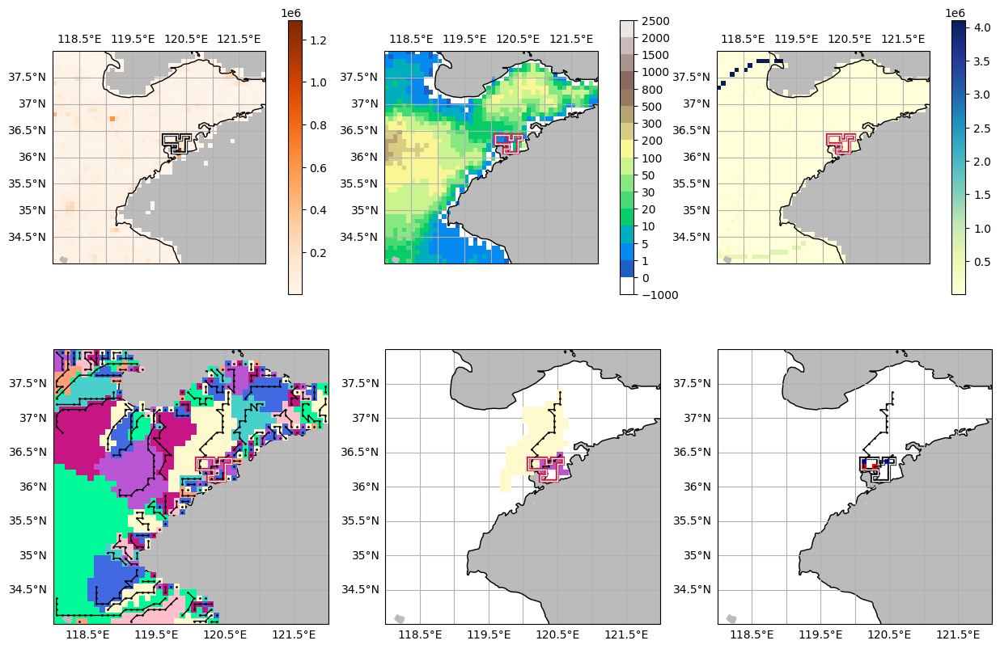

Surat


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


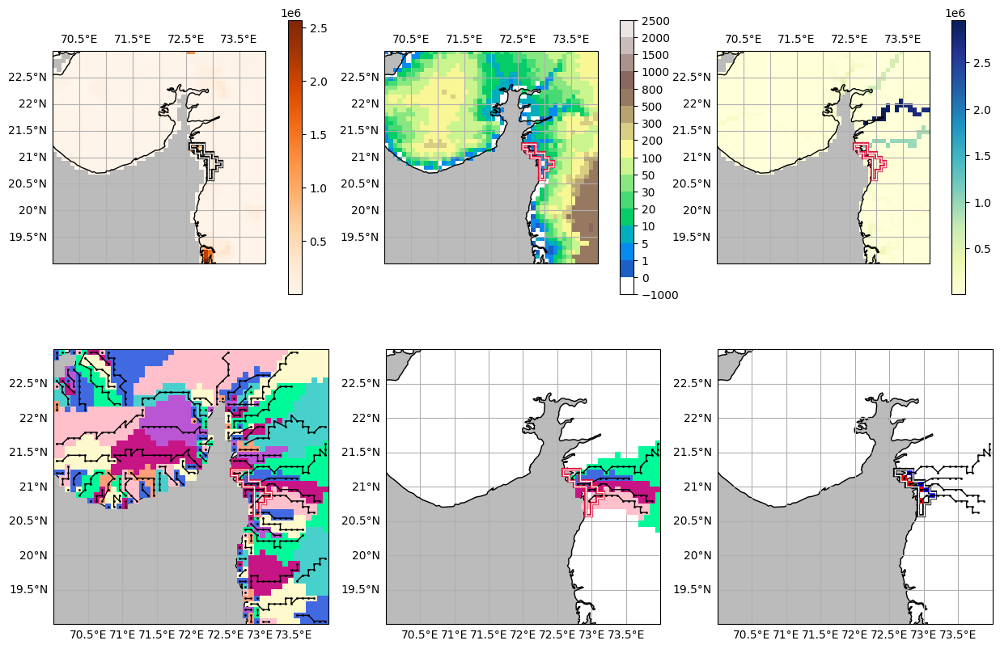

Guadalajara


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


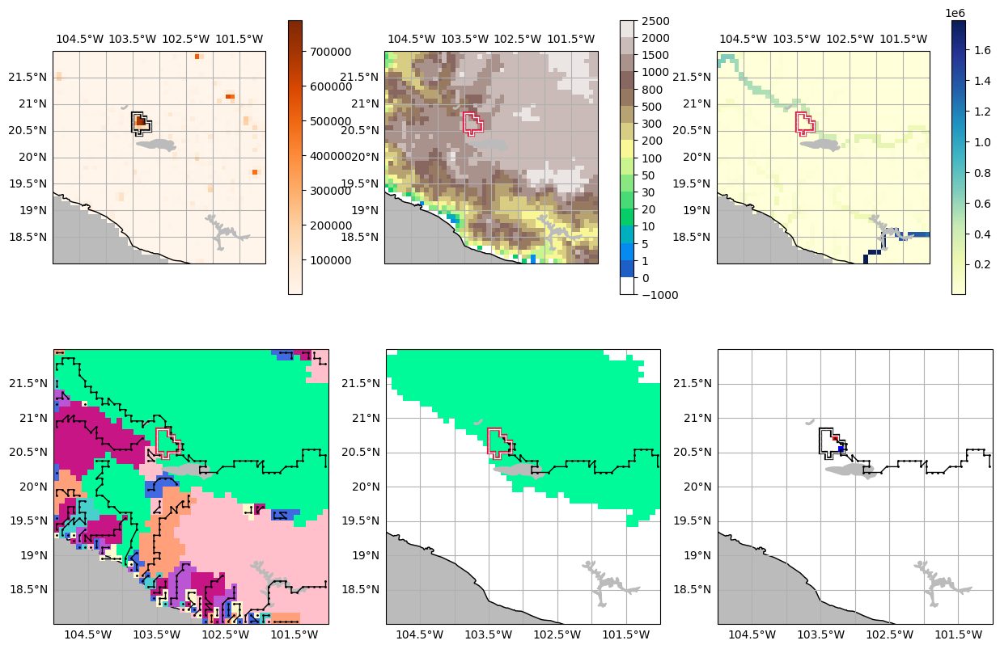

Yangon


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


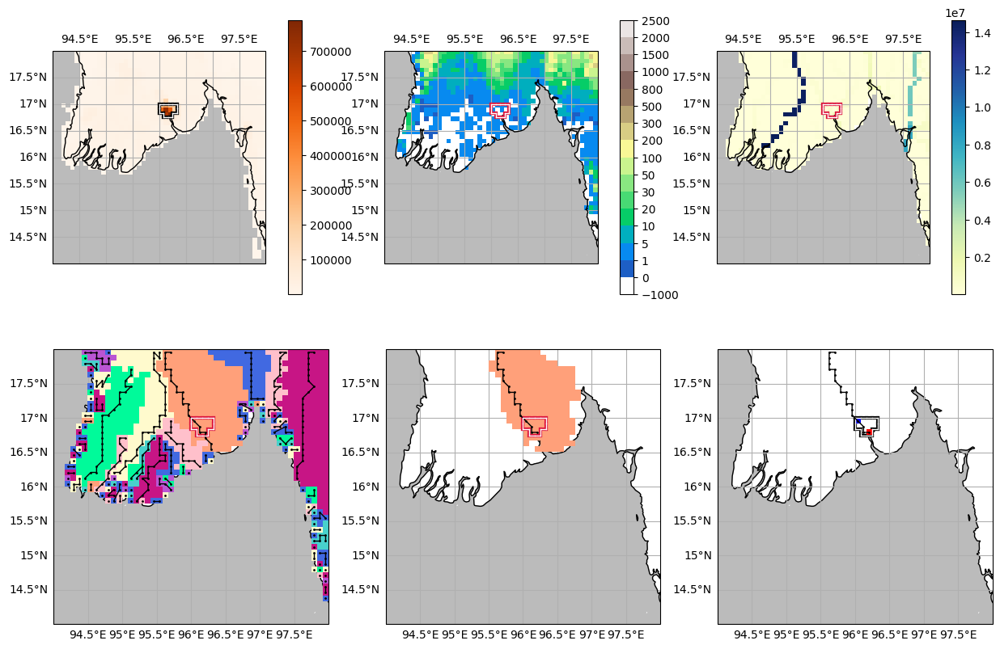

Al-Iskandariyah (Alexandria)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


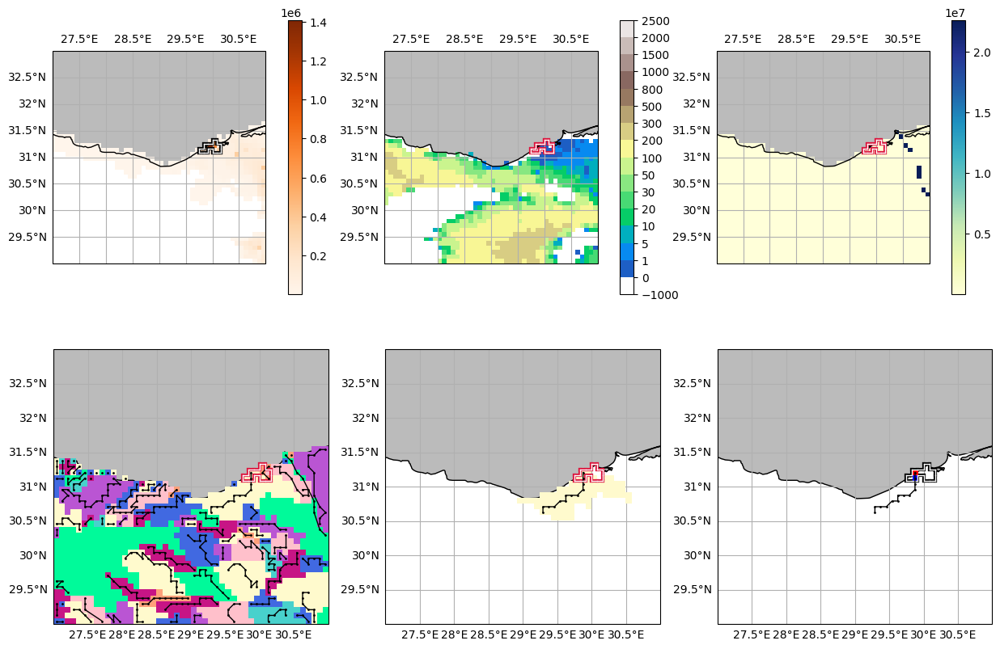

Johannesburg


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


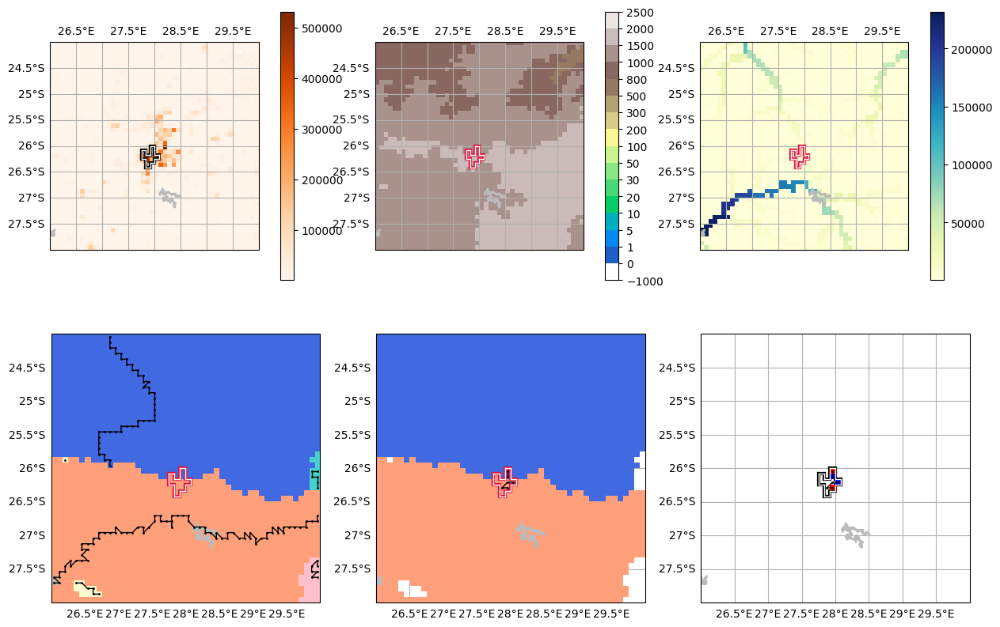

Boston


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


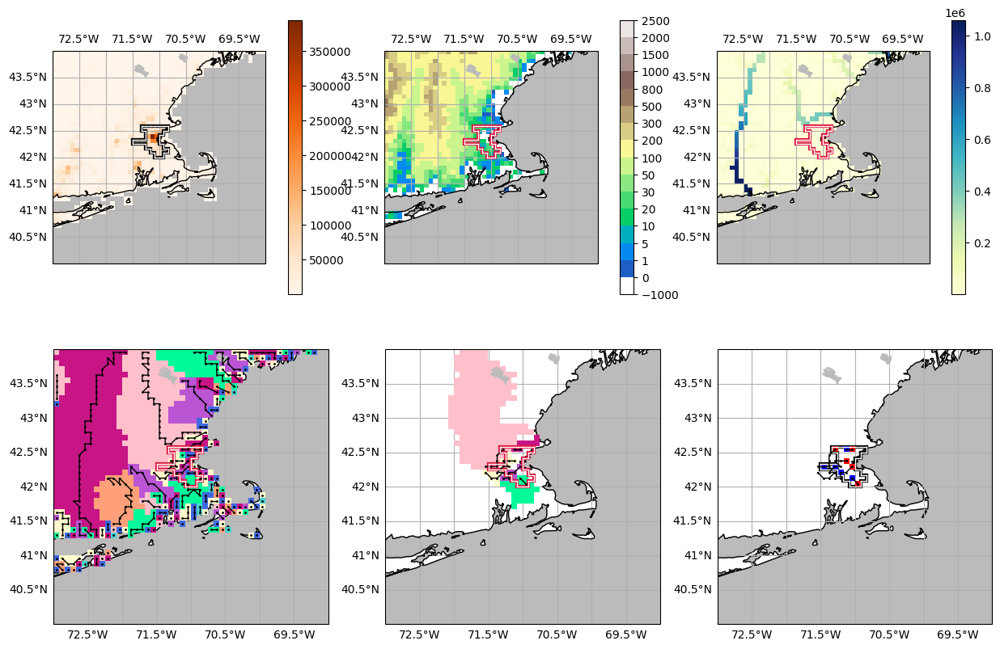

Dalian
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


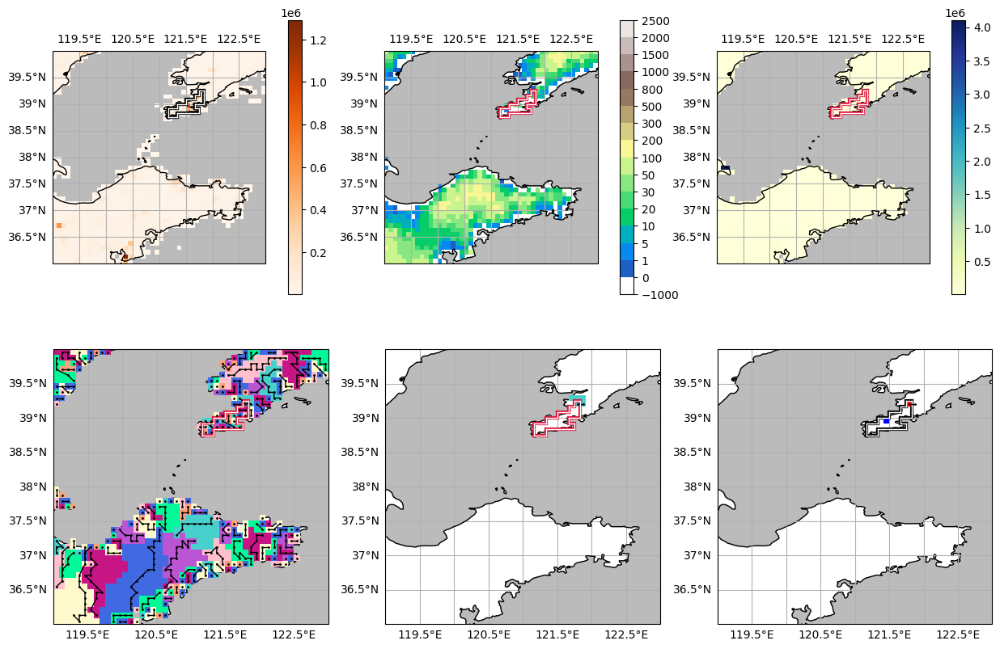

Sydney


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


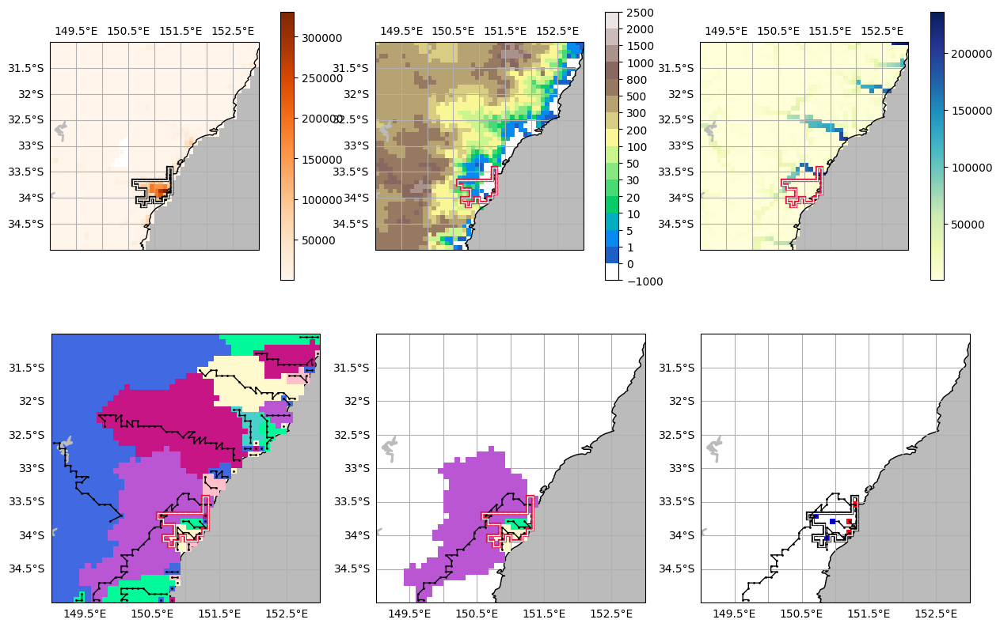

Ankara


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


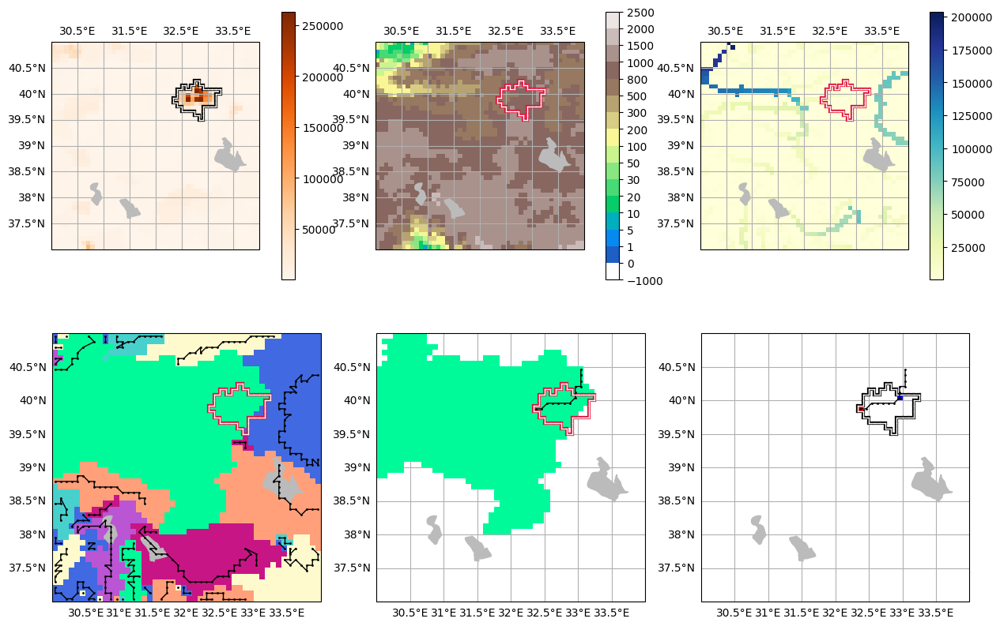

Monterrey
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


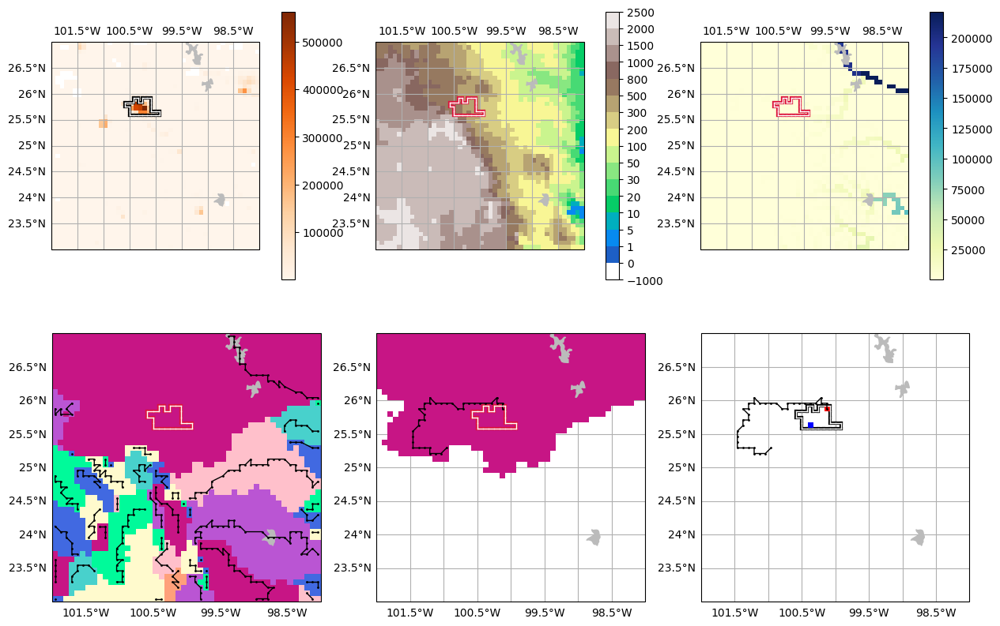

Chittagong


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


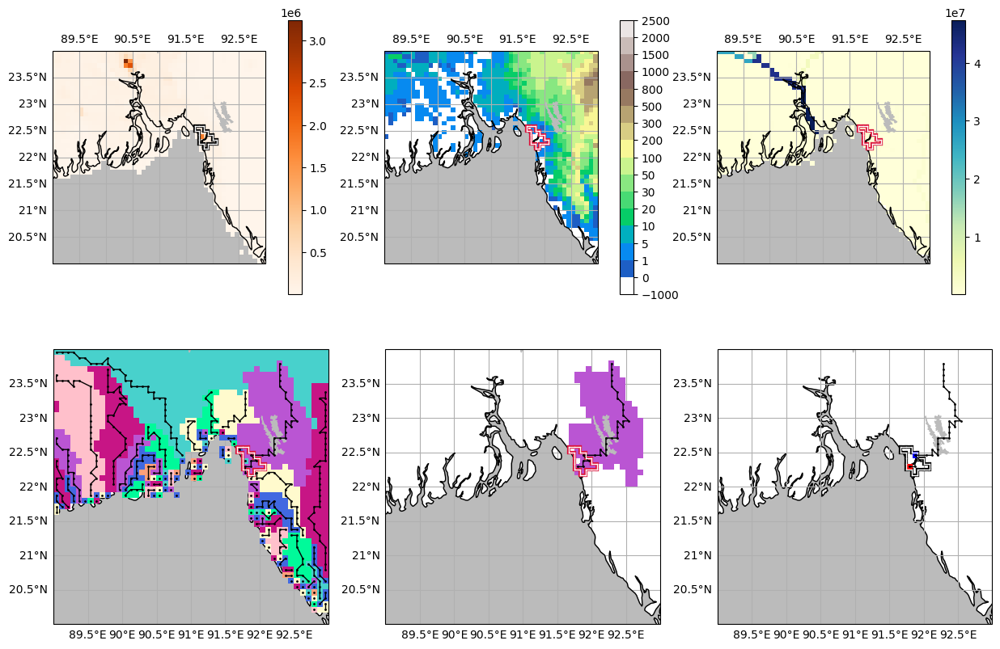

Xinbei


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


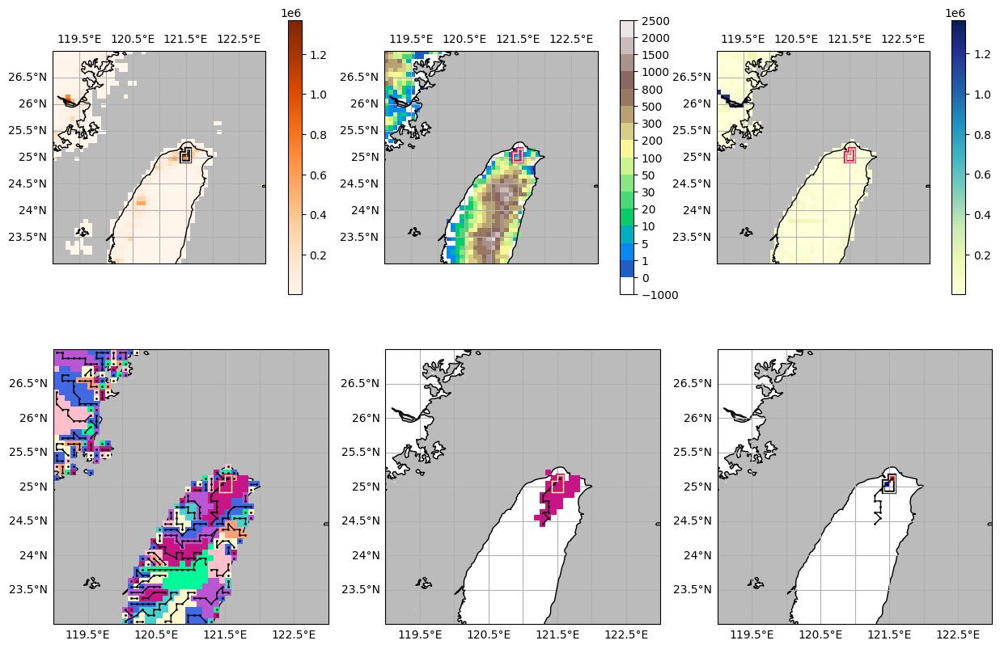

Suzhou, Jiangsu


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


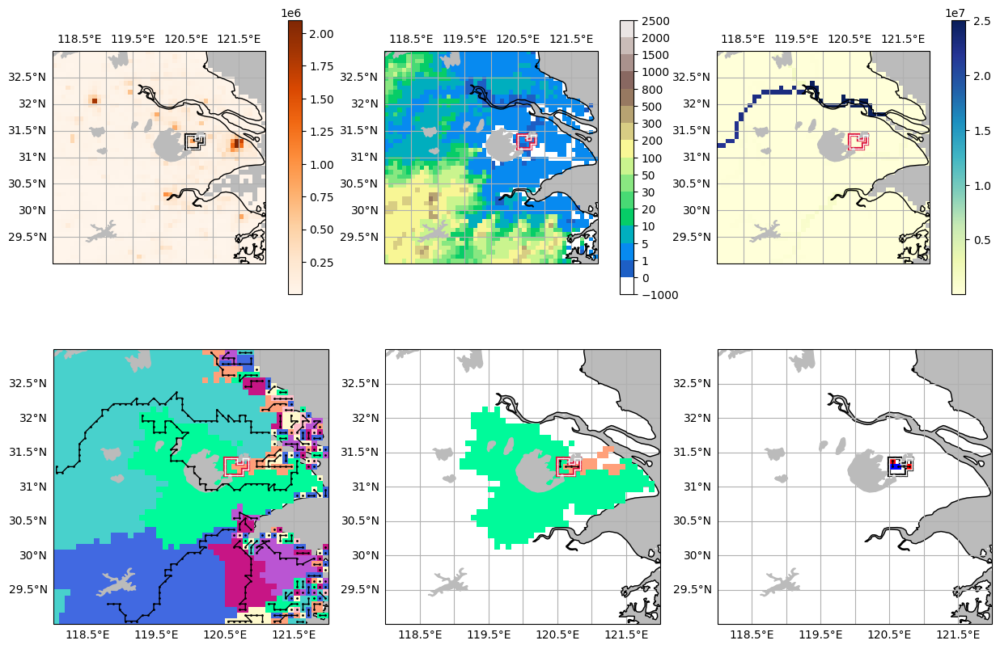

Ji'nan, Shandong


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


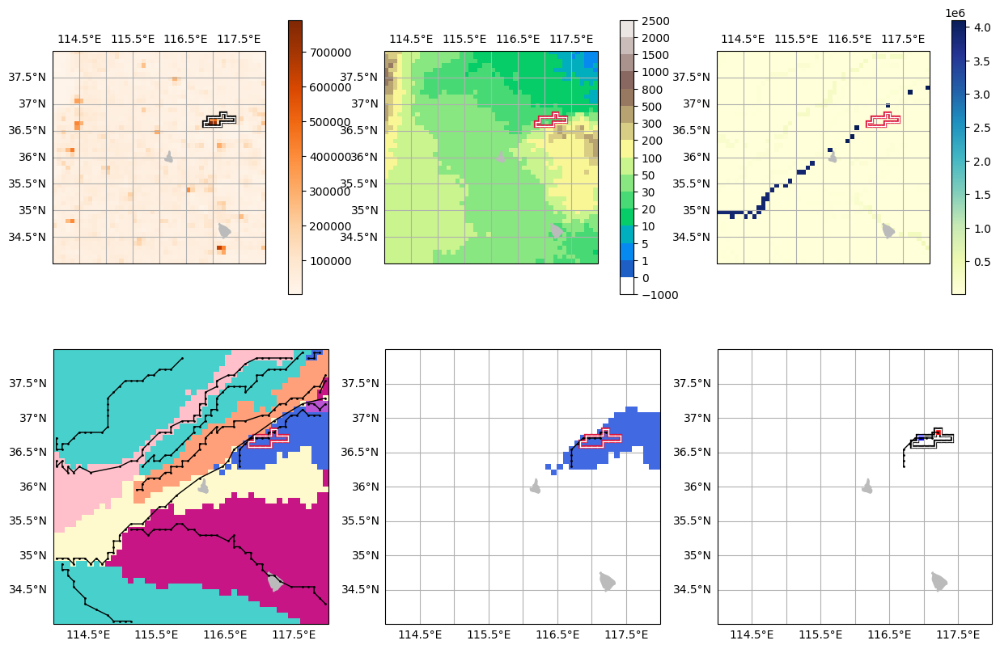

Roma (Rome)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


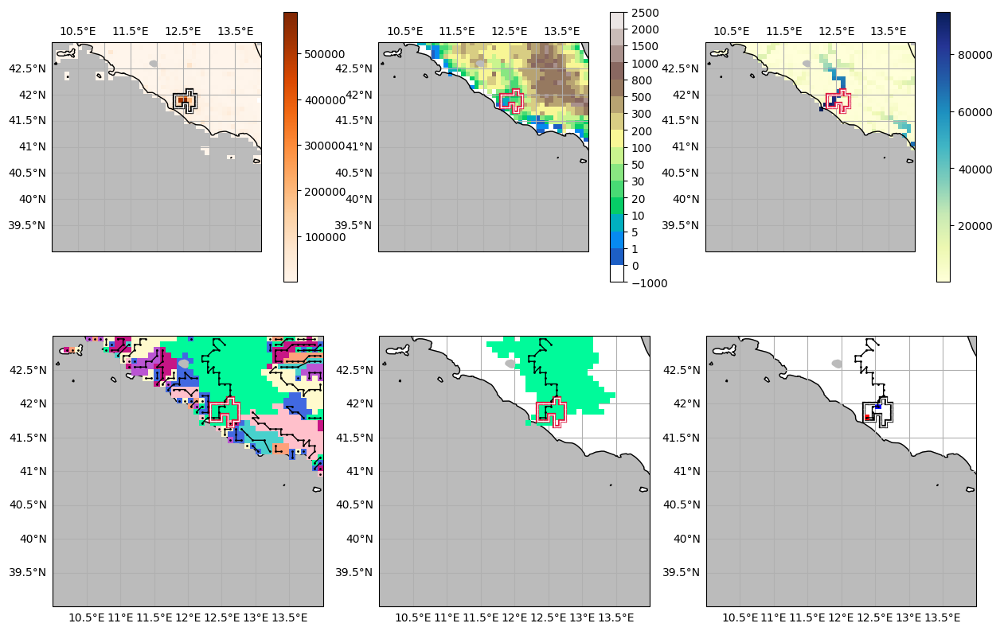

Abidjan


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


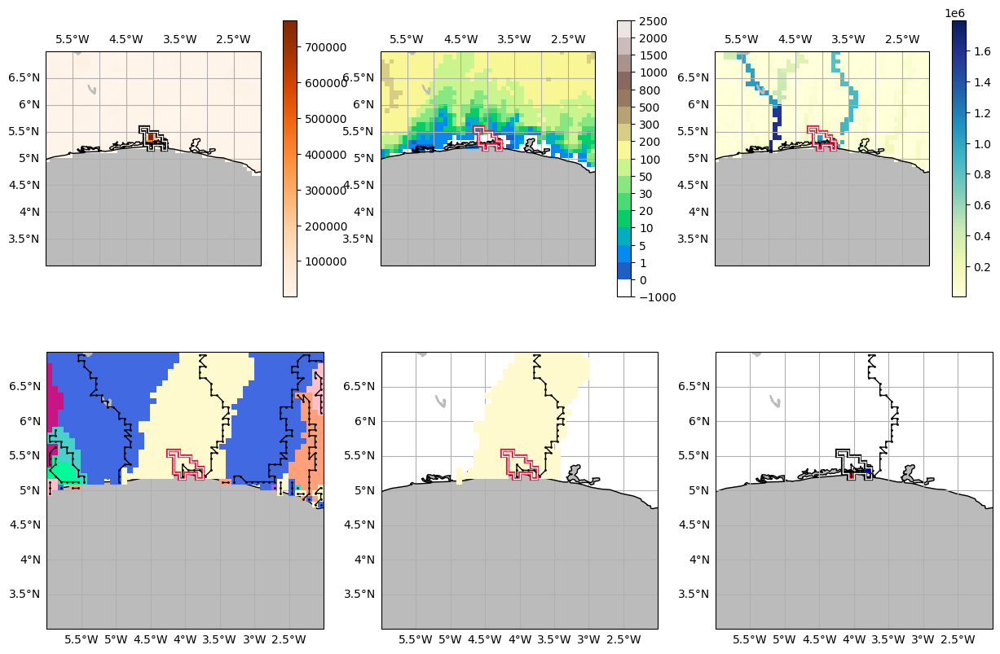

Melbourne


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


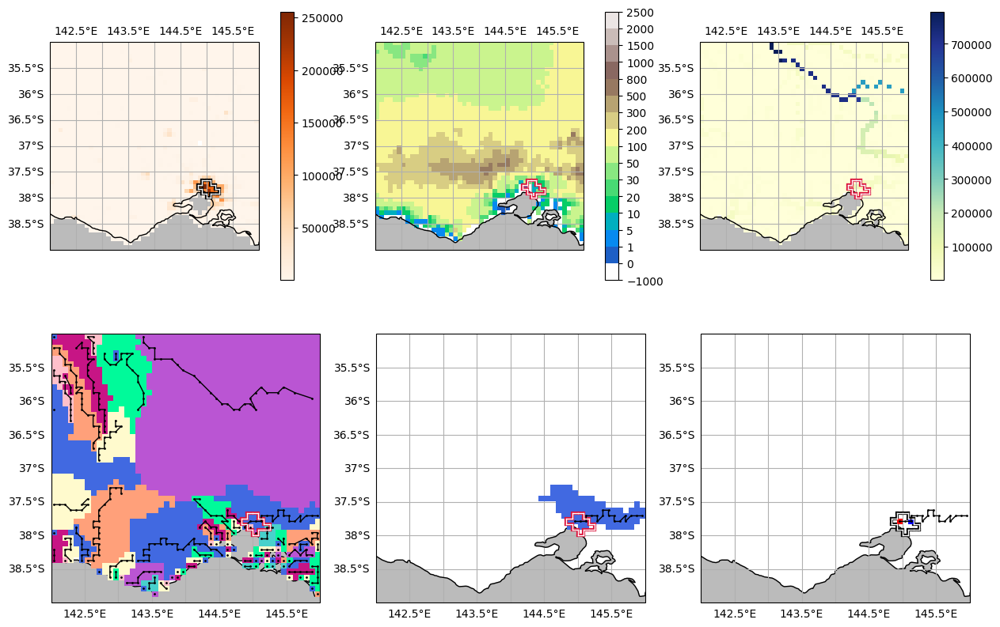

Montréal


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


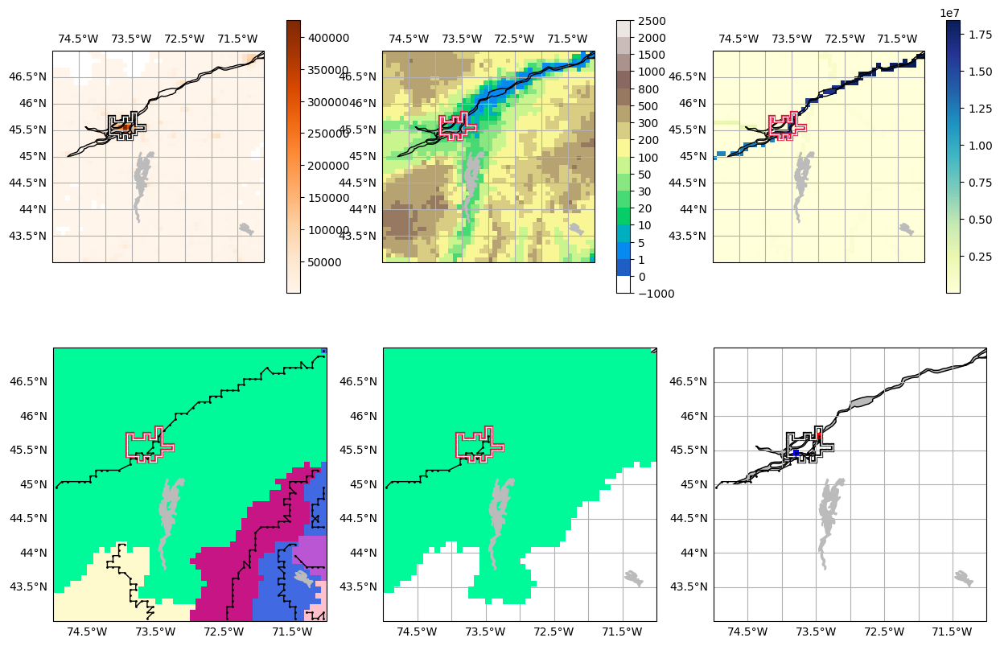

Dar es Salaam


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


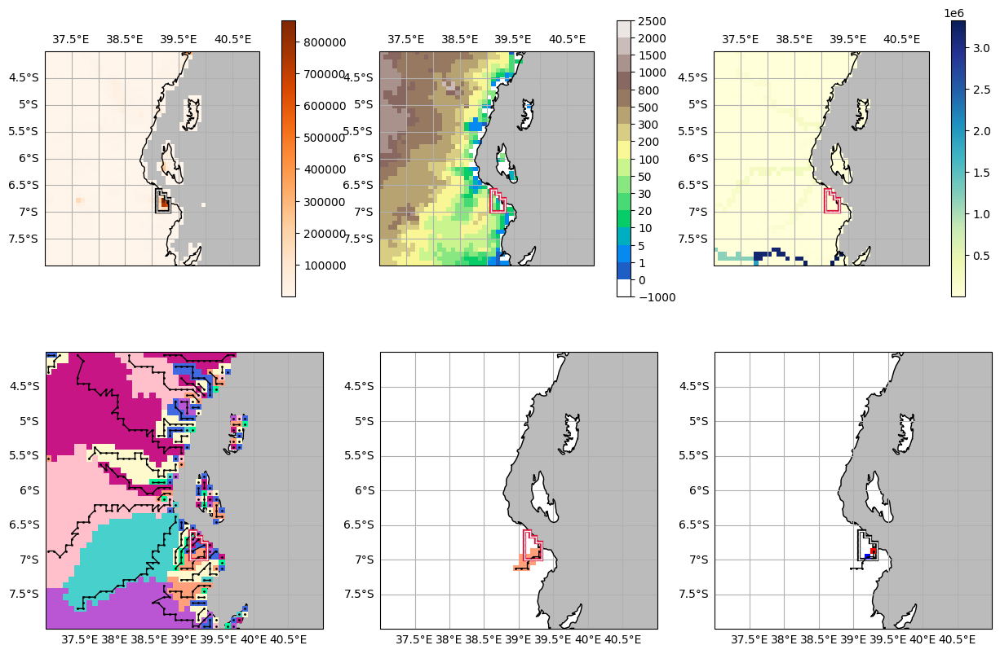

Pôrto Alegre


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


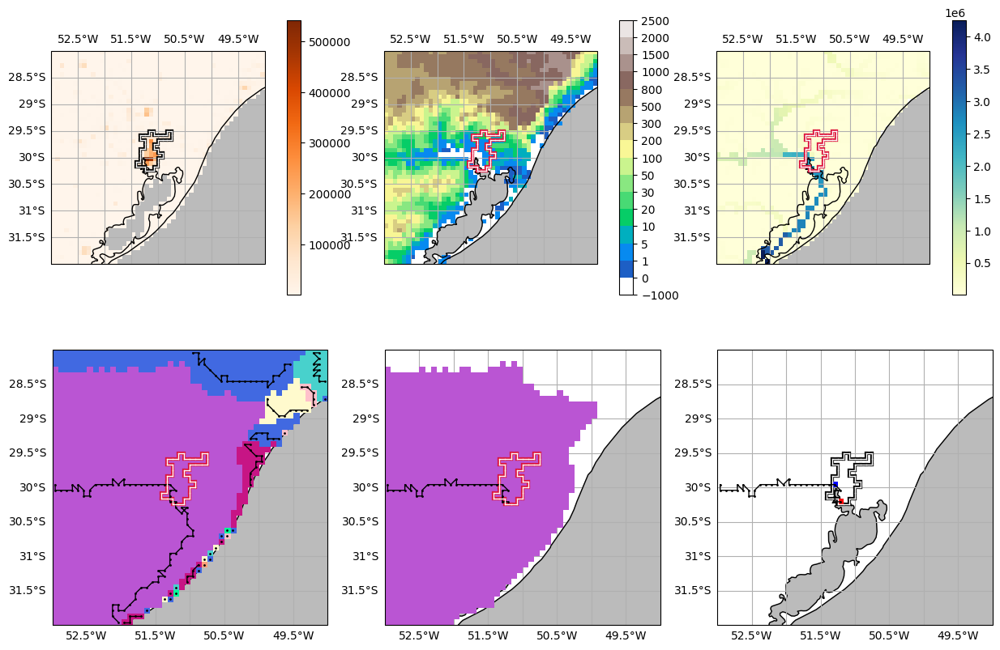

Detroit


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


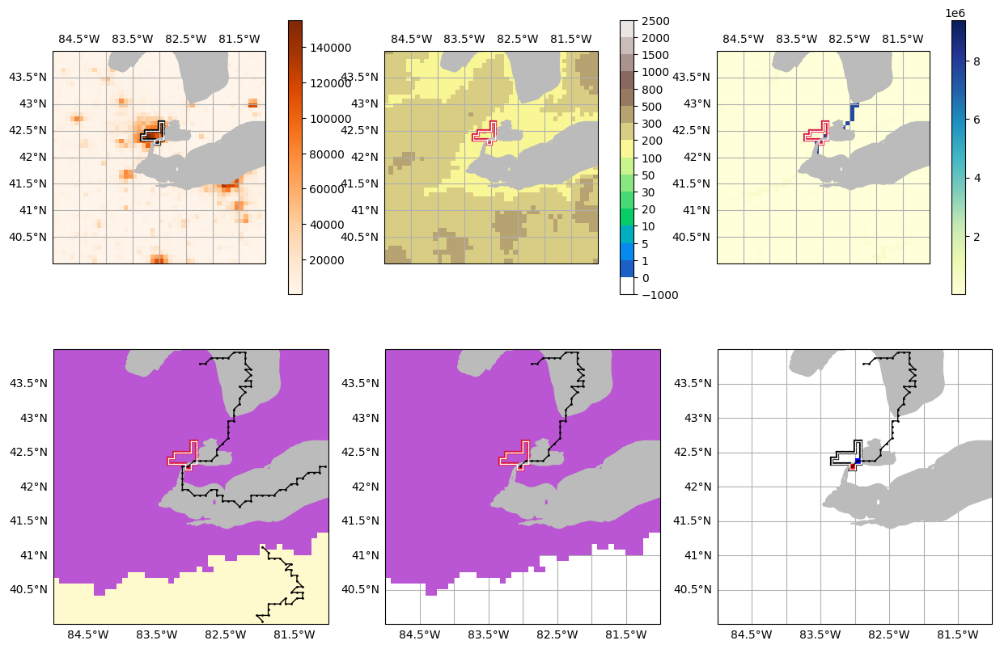

Brasília


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


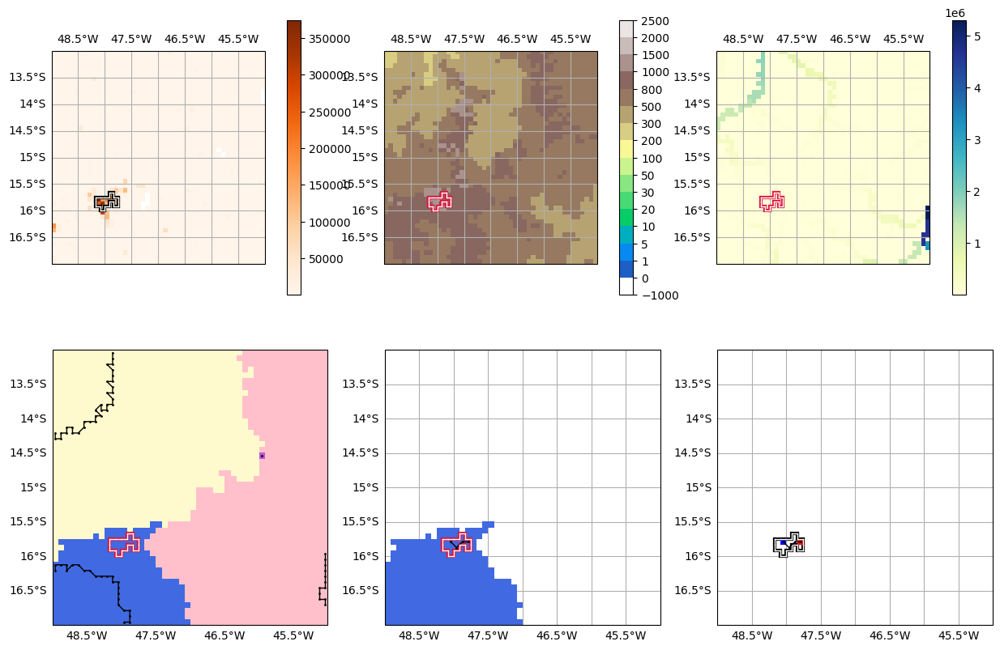

Phoenix-Mesa


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


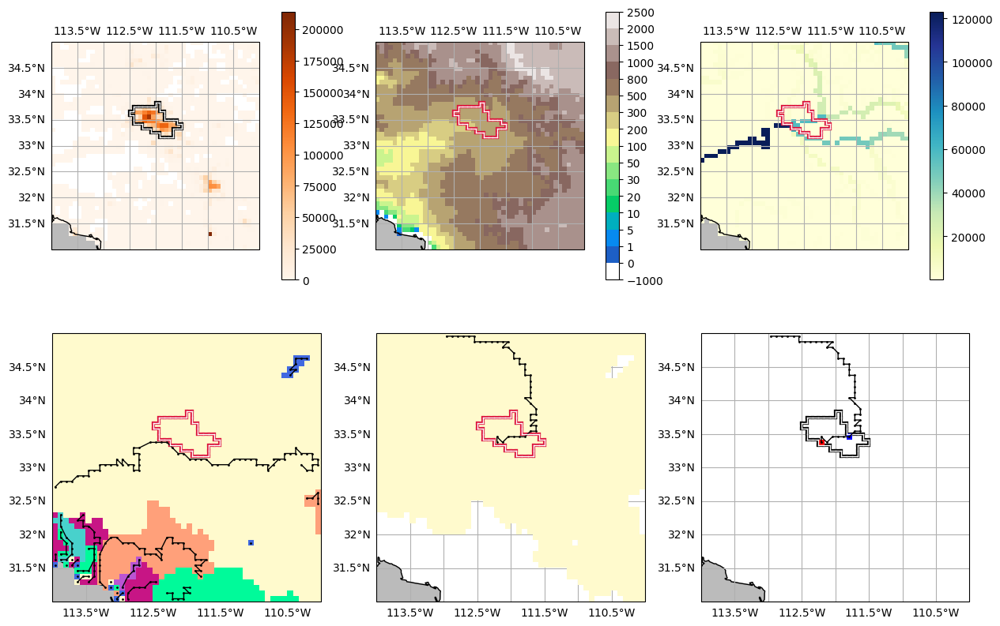

Zhengzhou


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


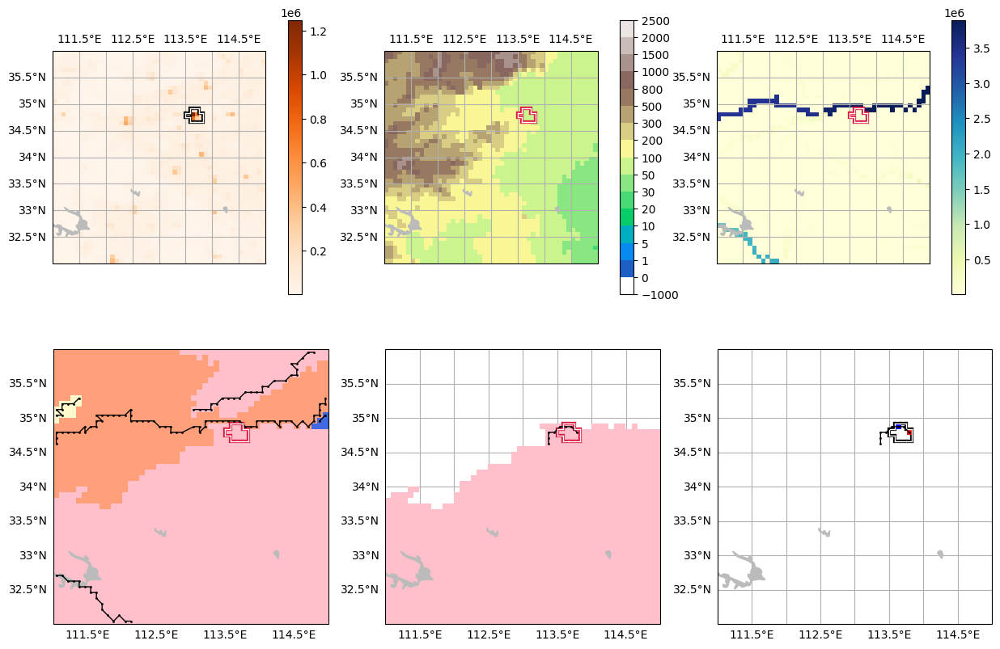

Shantou


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


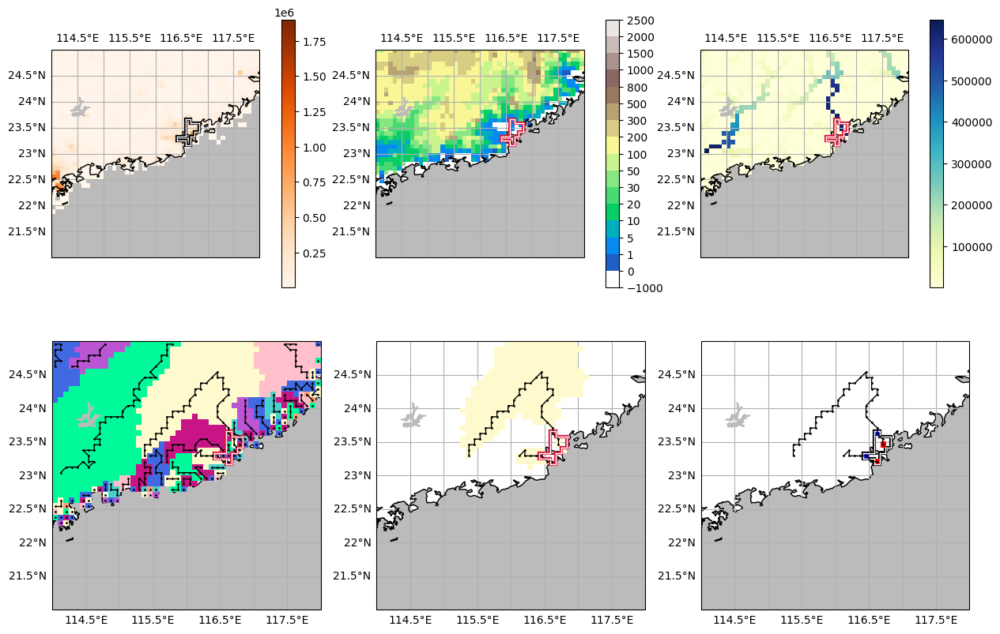

Cape Town


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


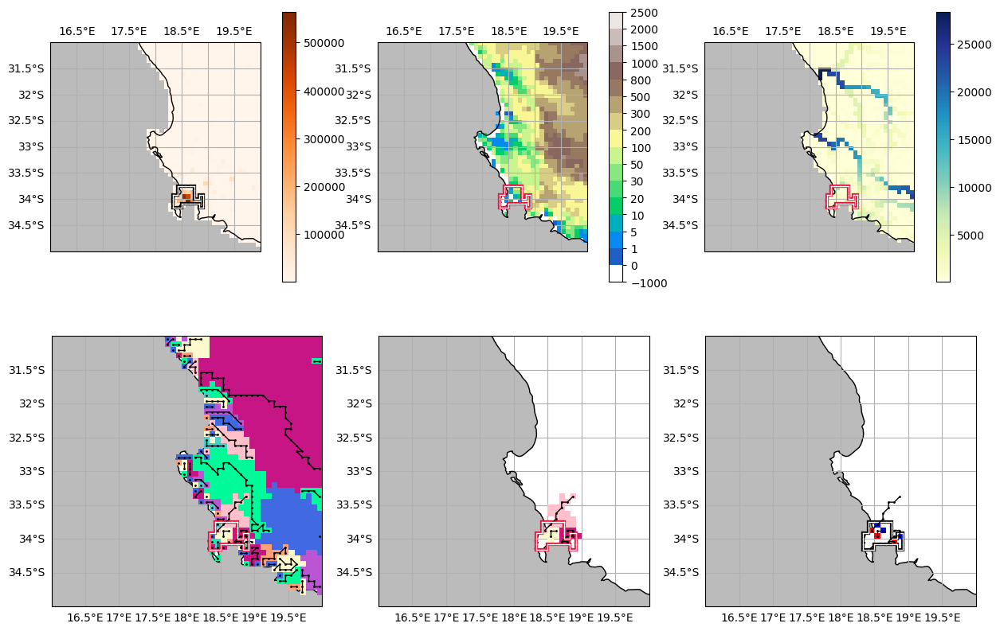

Changchun


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


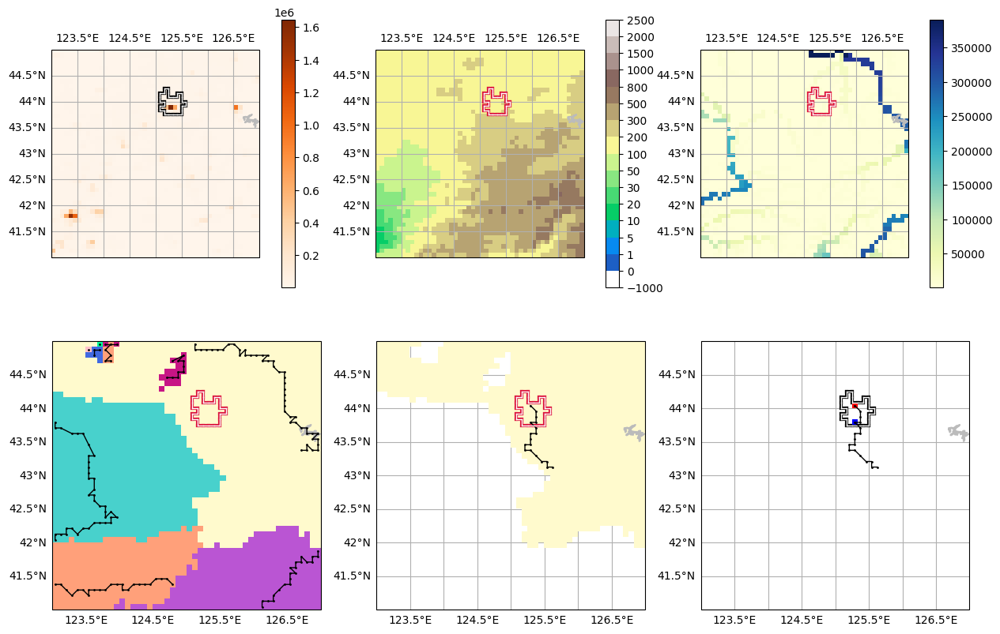

Recife


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


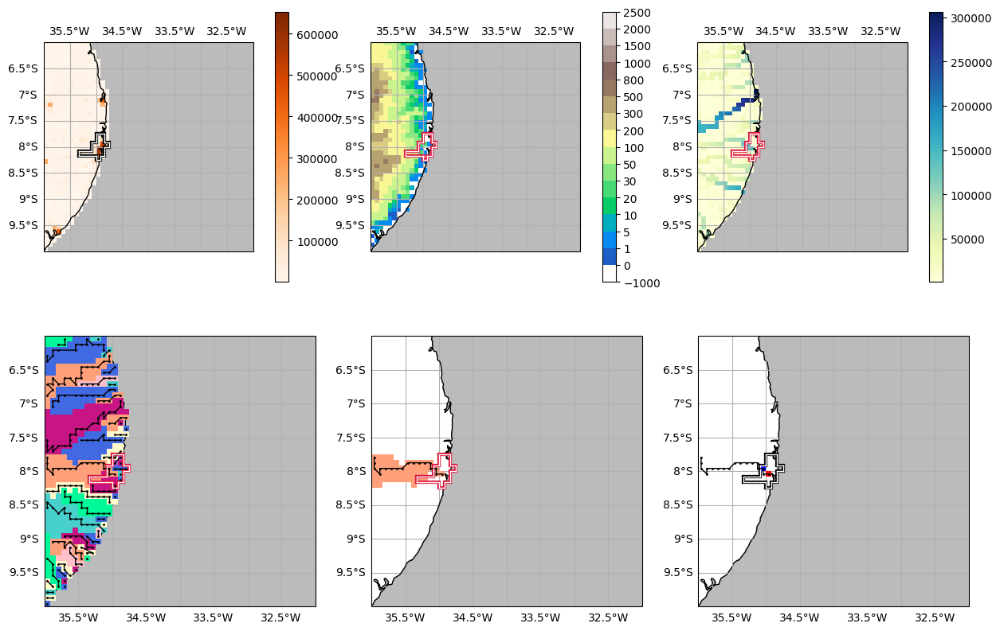

In [15]:
for i in range(1, 101):
    snapshot(city_num=i)

Fortaleza


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


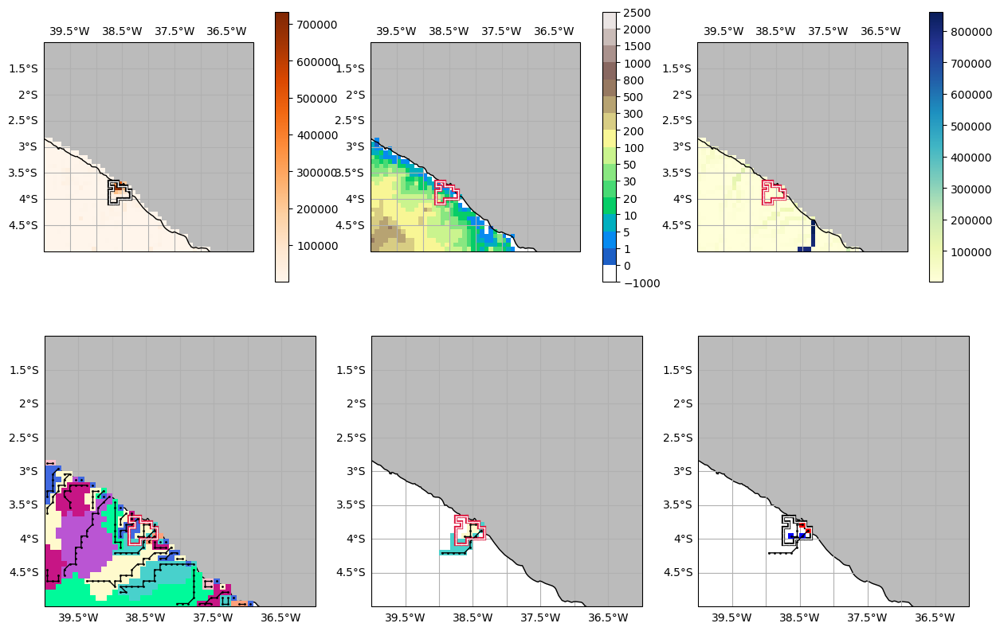

Kunming


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


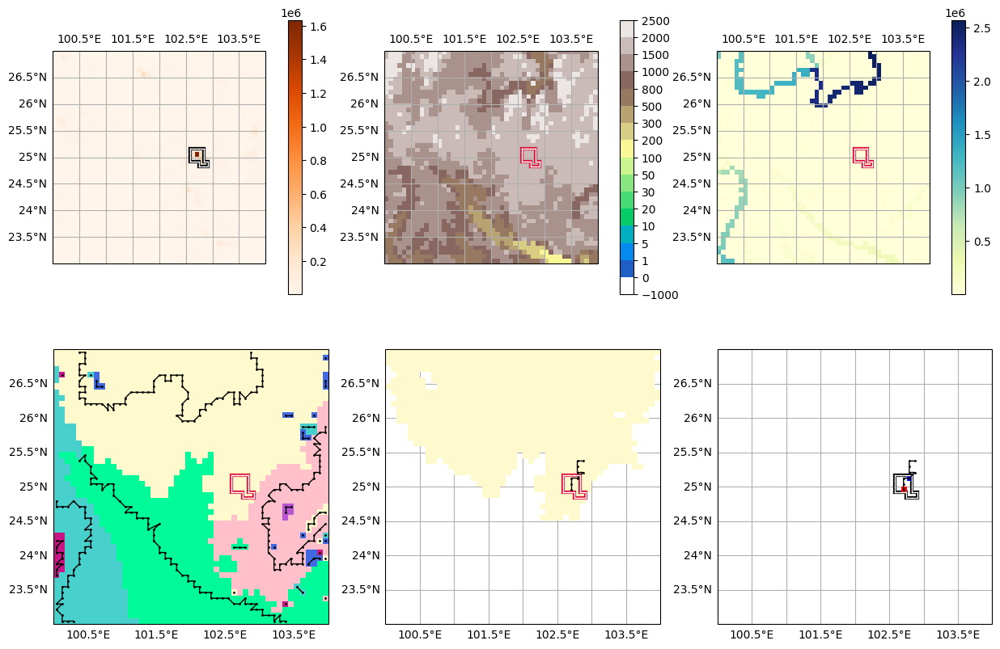

Berlin


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


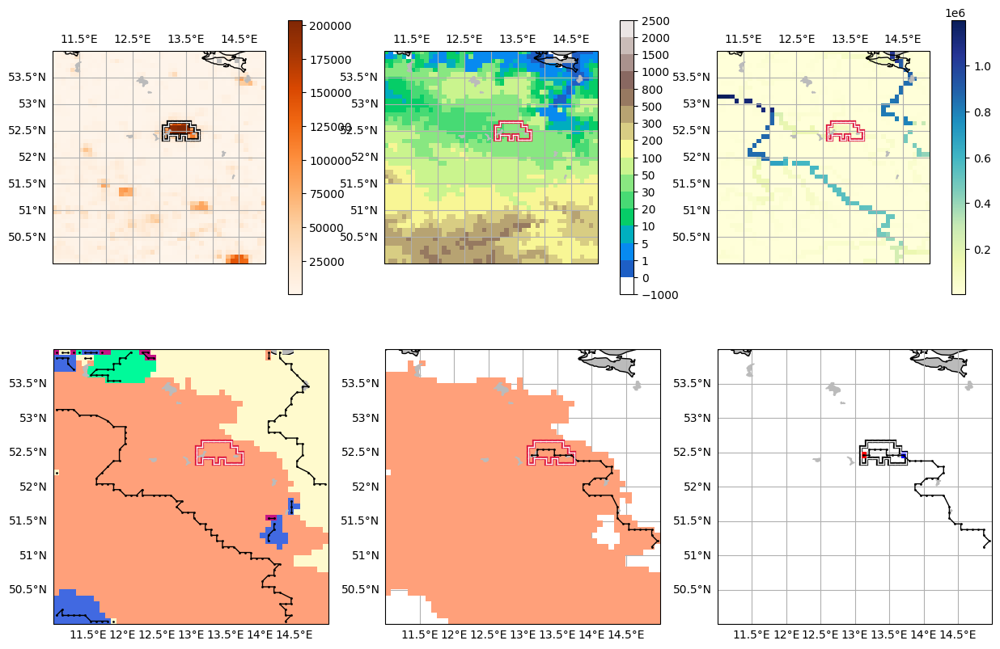

Jiddah


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


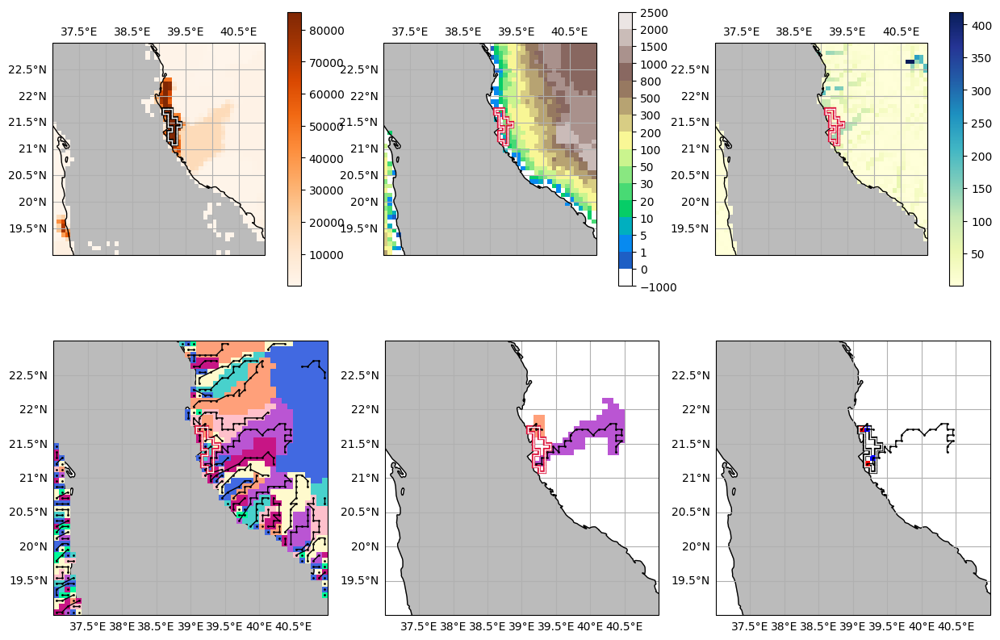

Dar-el-Beida (Casablanca)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


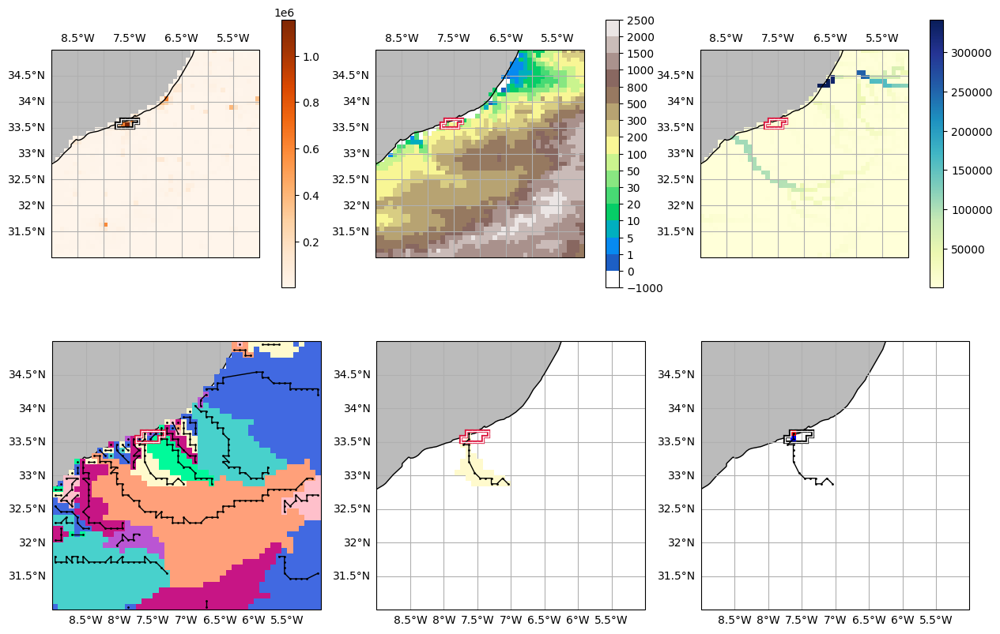

Medellín


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


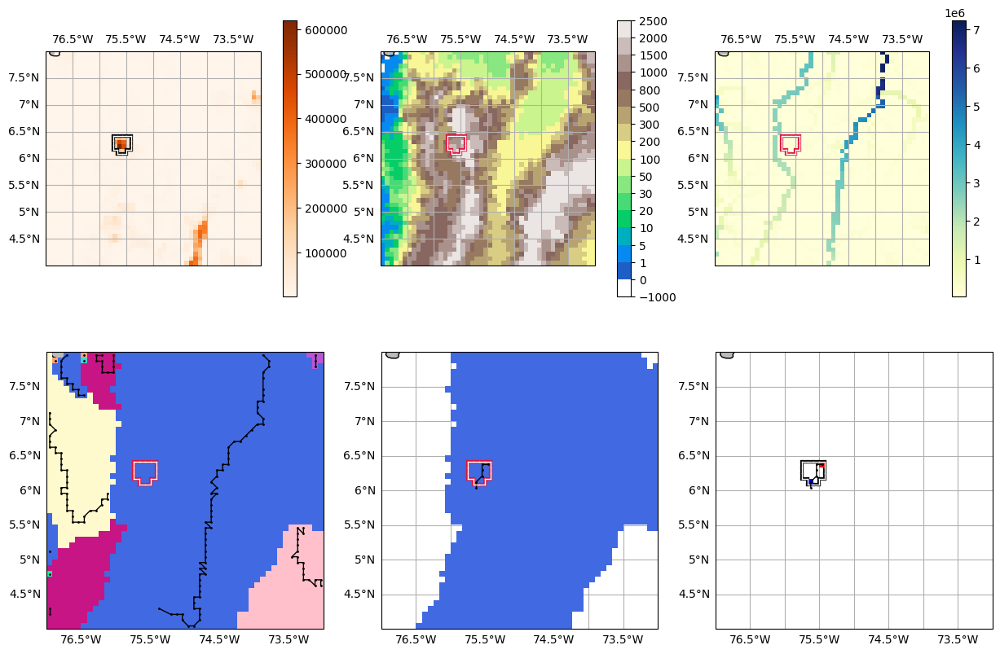

Busan


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


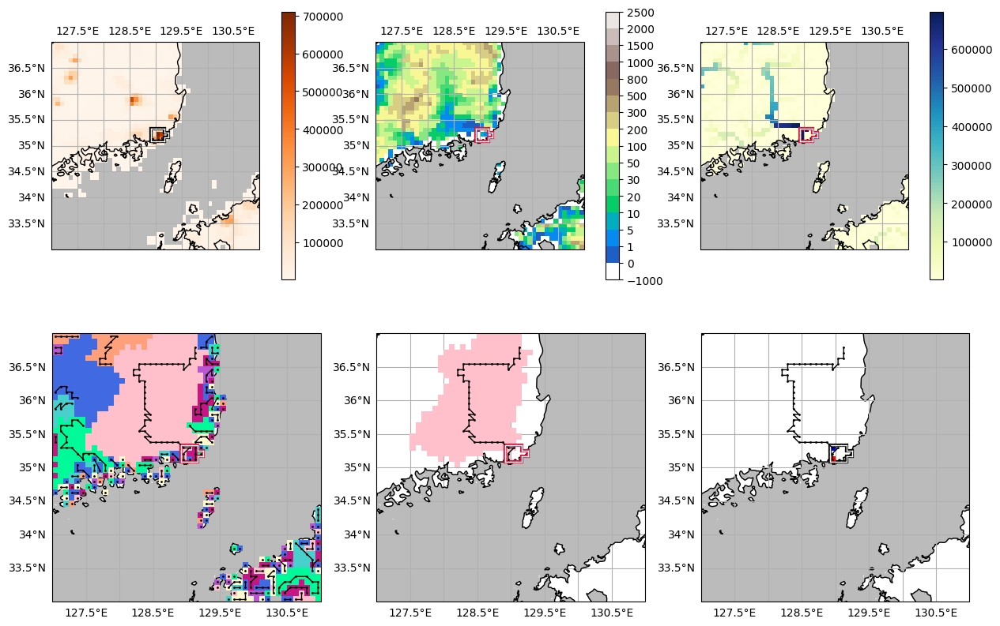

Shijiazhuang


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


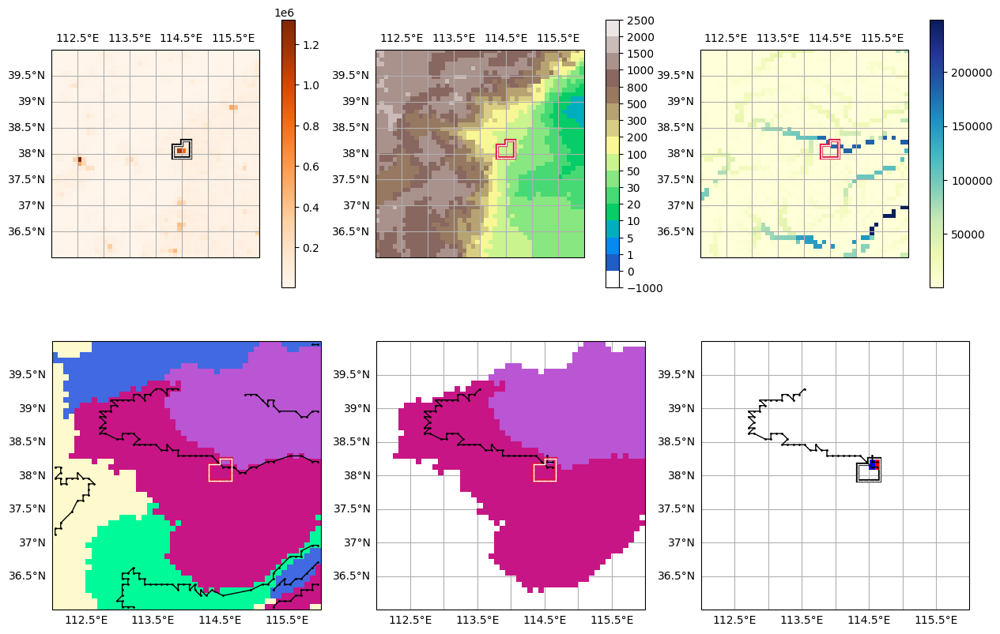

Salvador


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


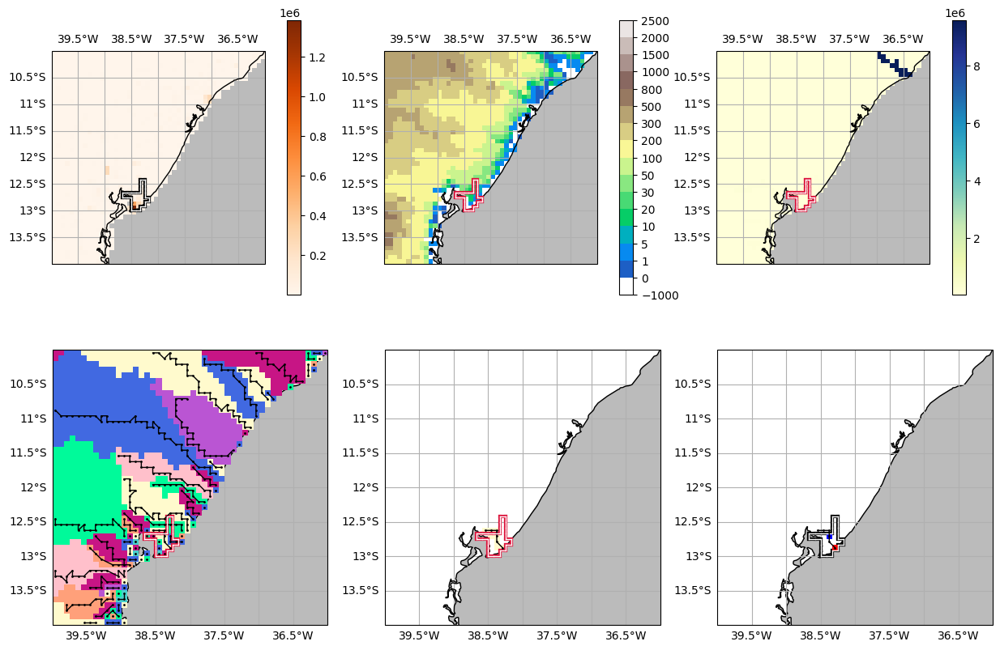

Tel Aviv-Yafo (Tel Aviv-Jaffa)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


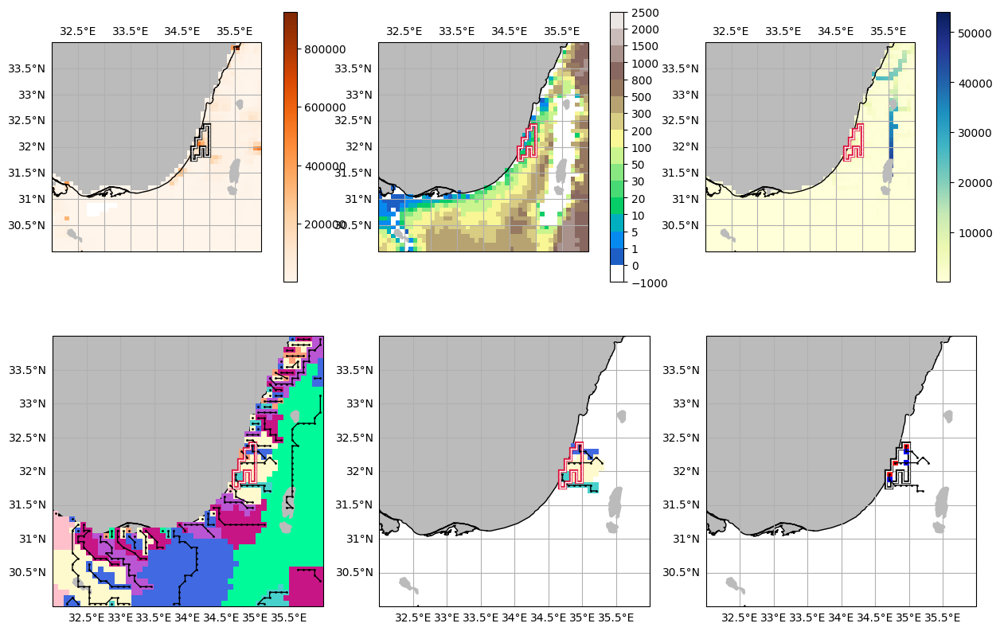

Kabul


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


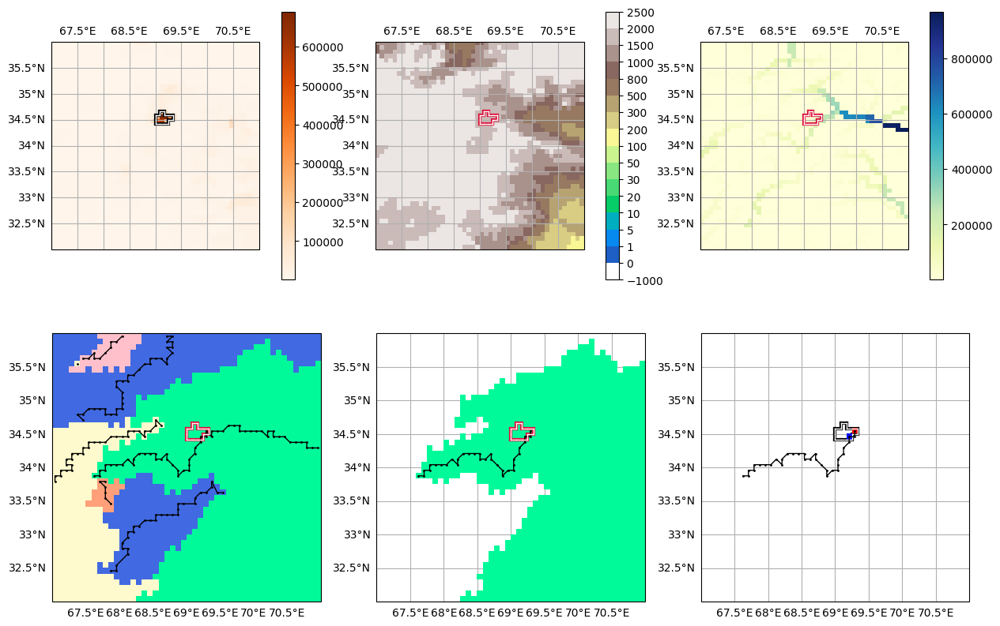

San Francisco-Oakland
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


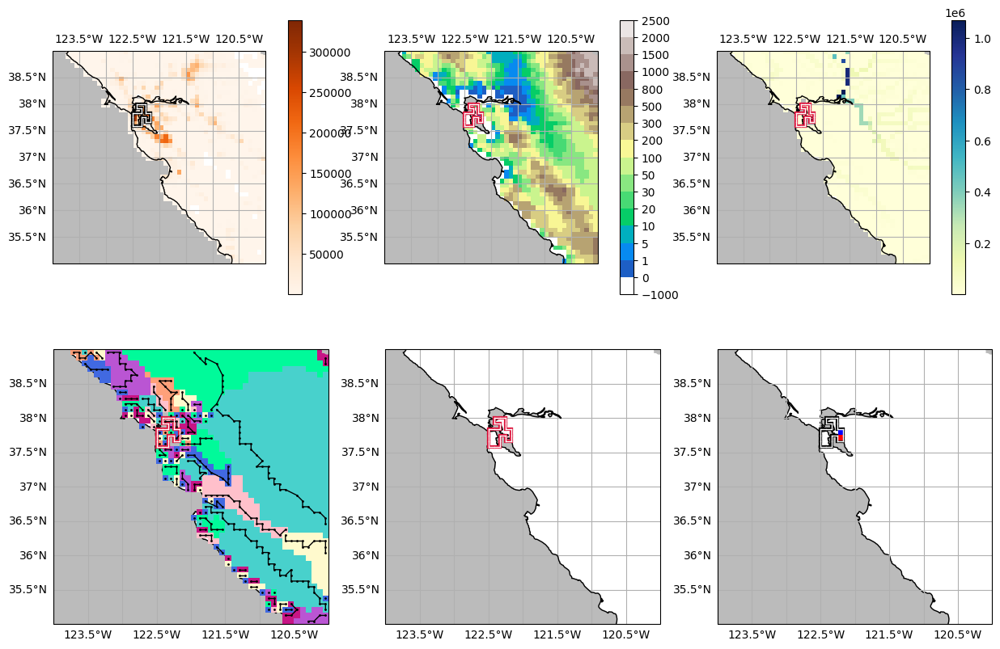

Nairobi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


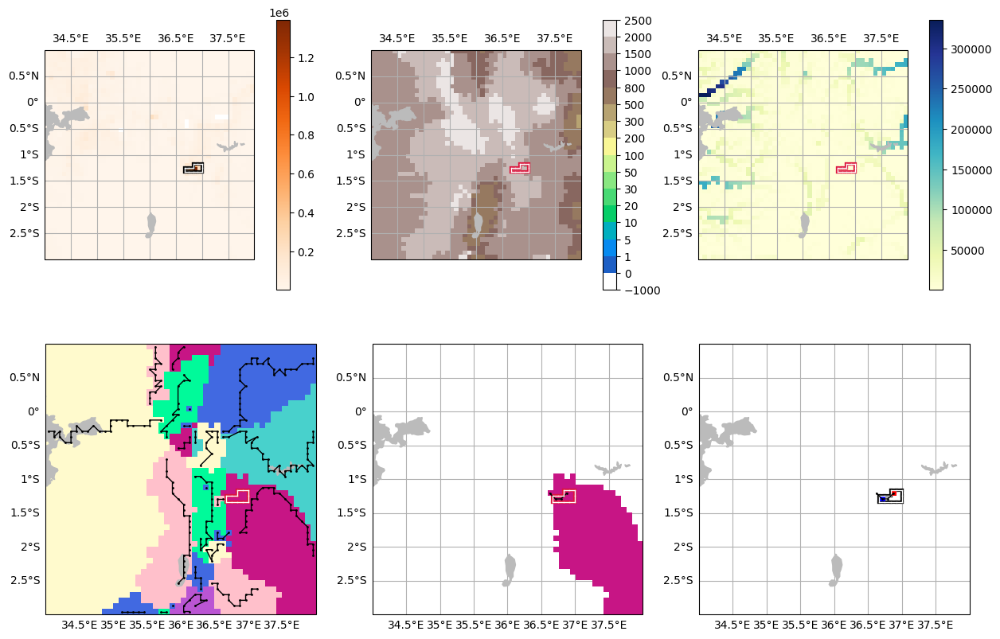

Kano


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


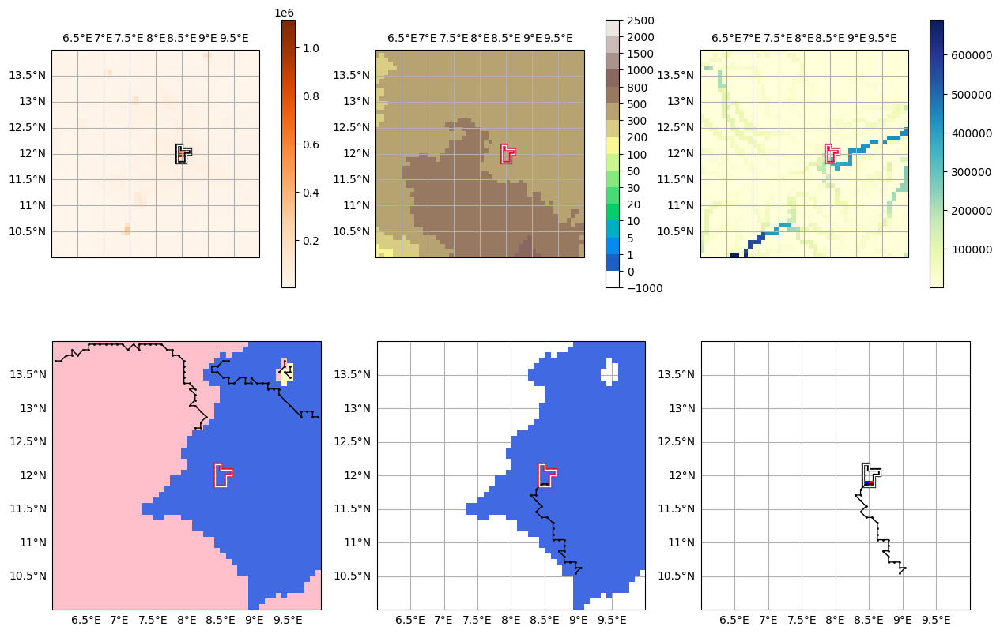

Athínai (Athens)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


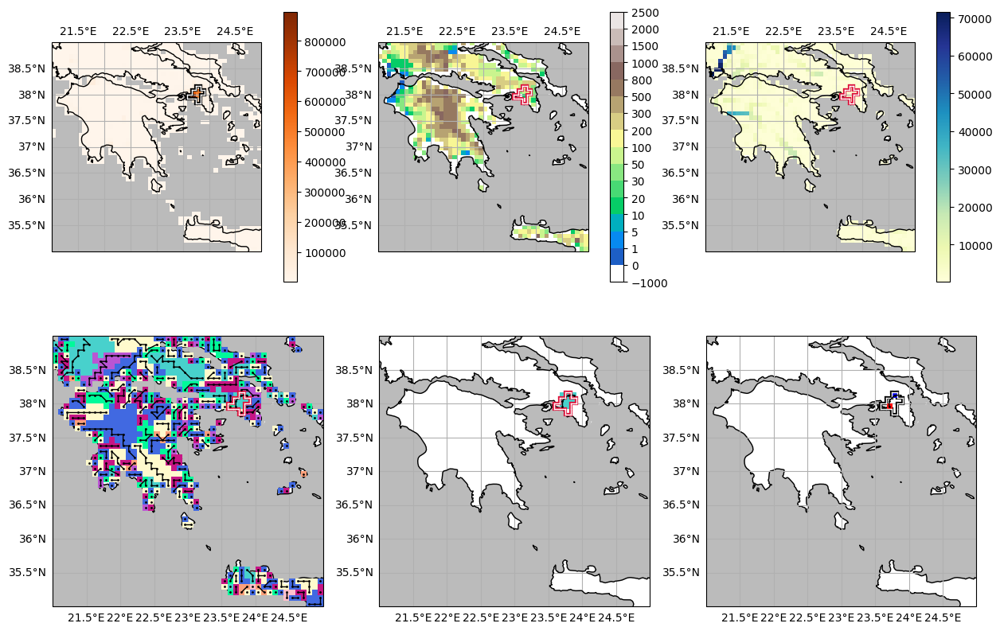

Changsha


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


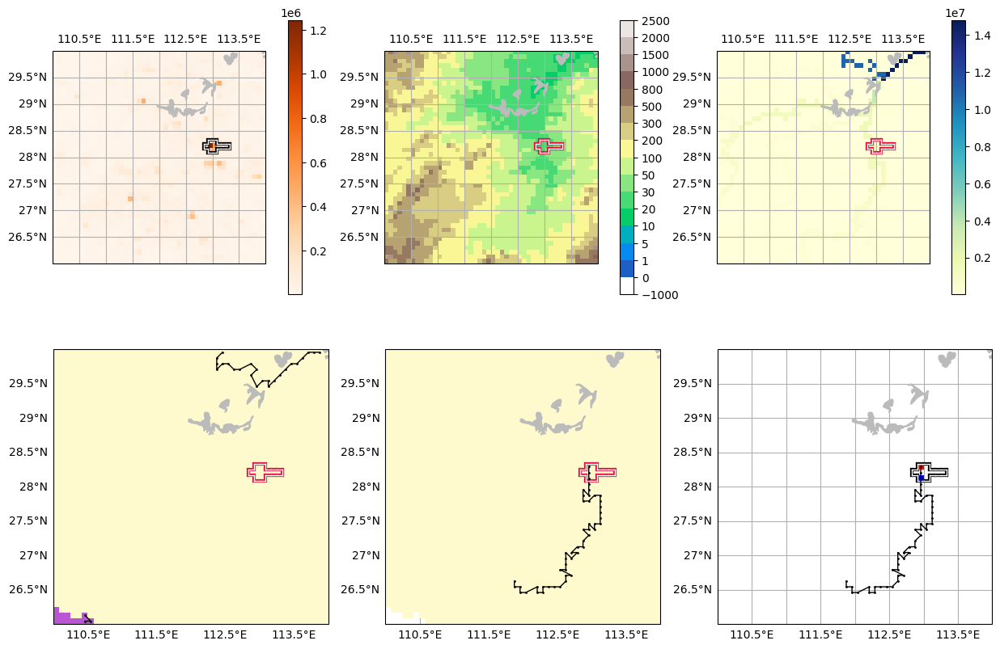

Taiyuan, Shanxi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


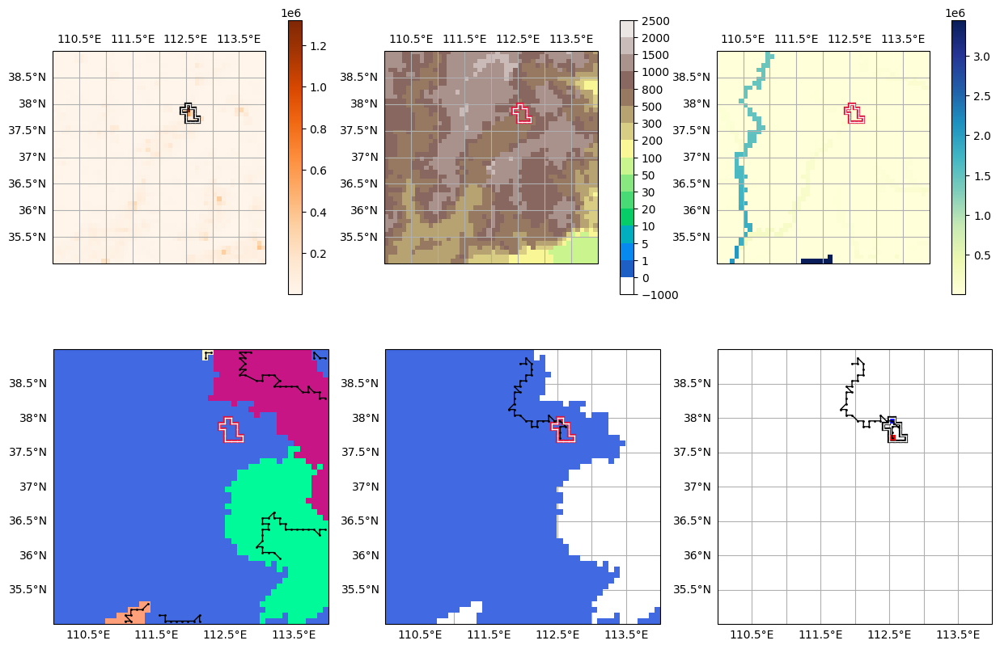

Addis Ababa


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


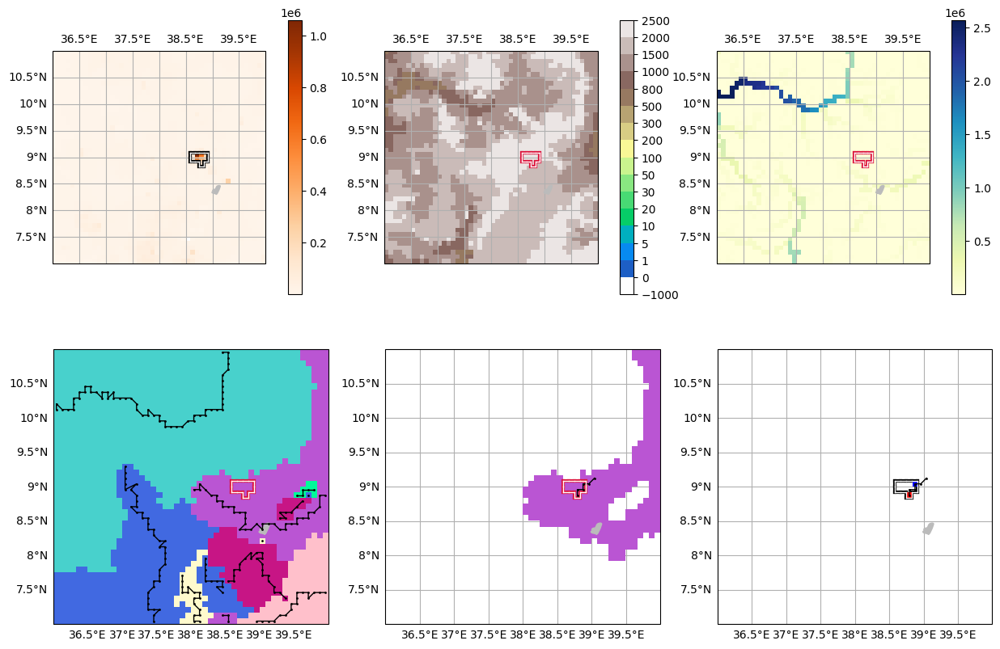

Curitiba


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


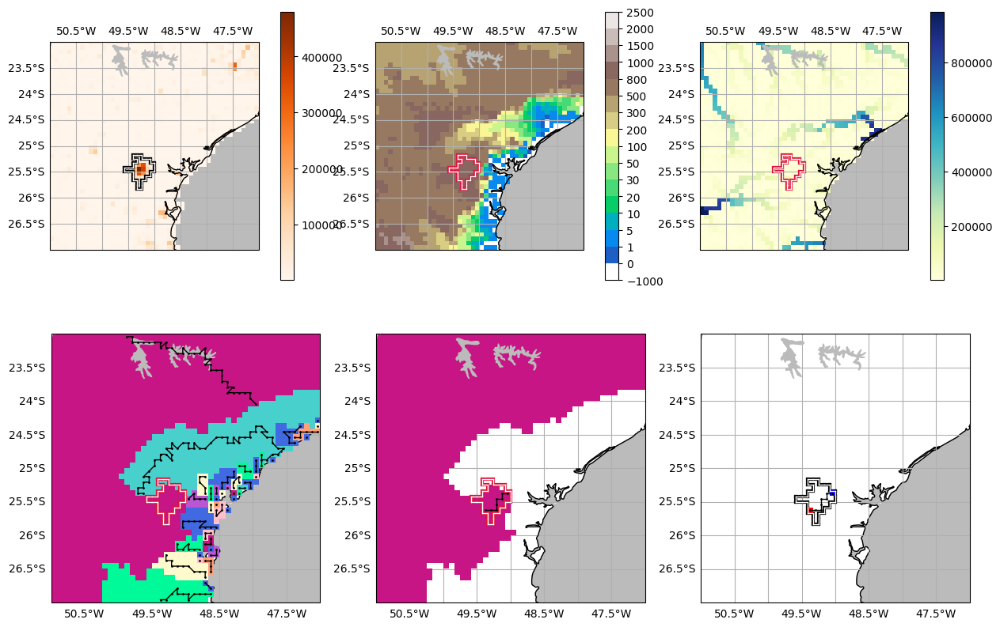

Halab (Aleppo)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


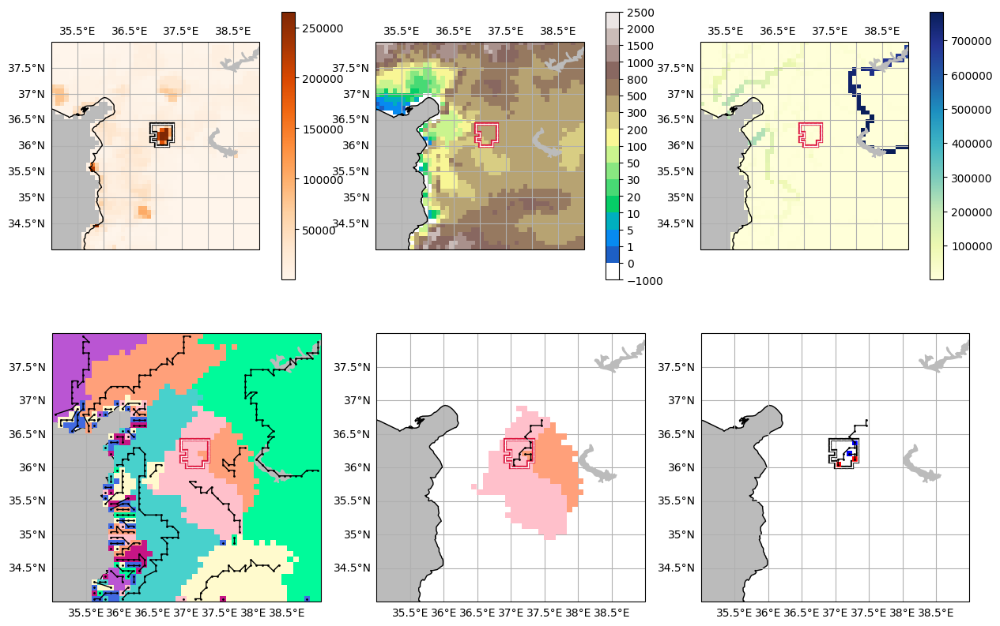

Seattle


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


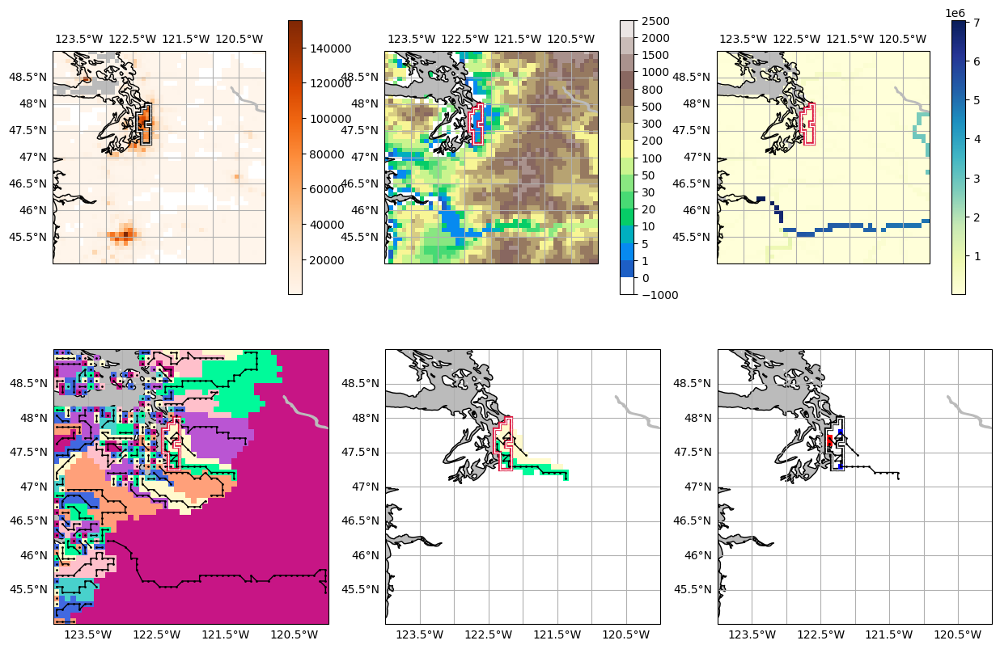

Ekurhuleni


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


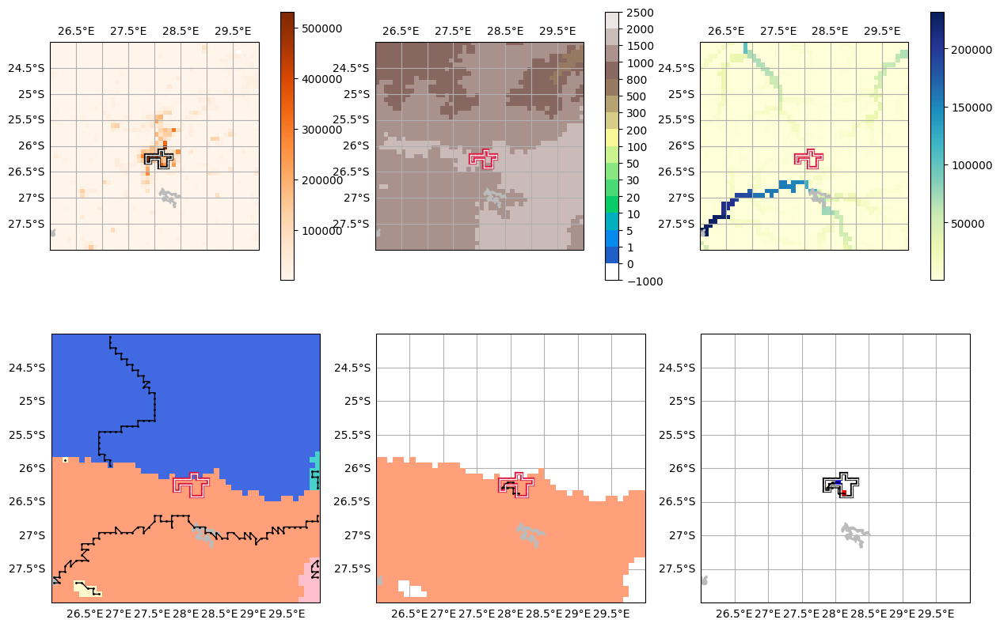

Milano (Milan)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


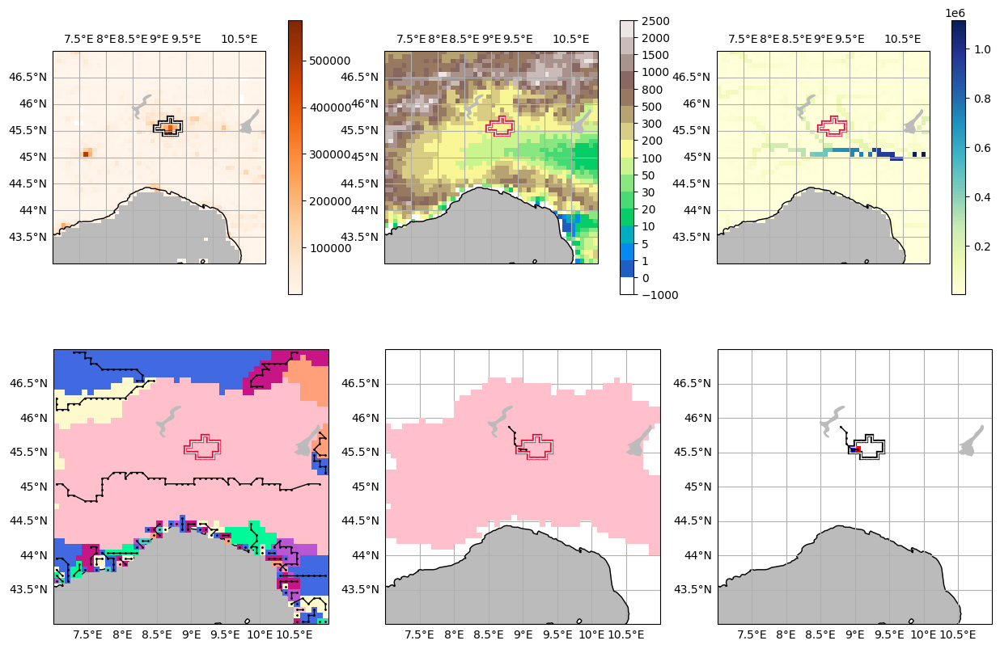

Xiamen
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


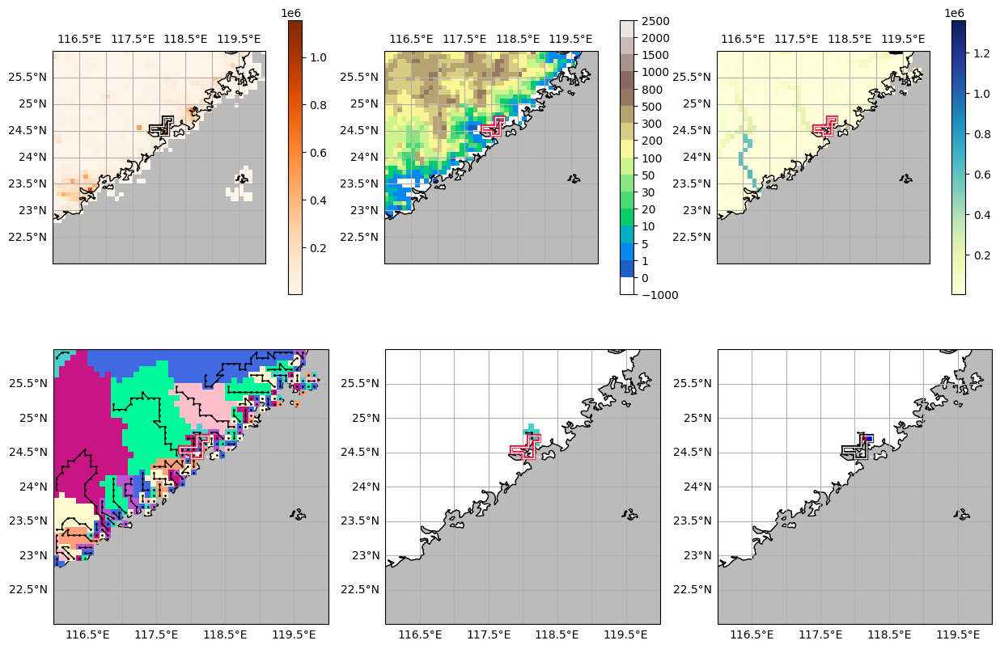

Hefei


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


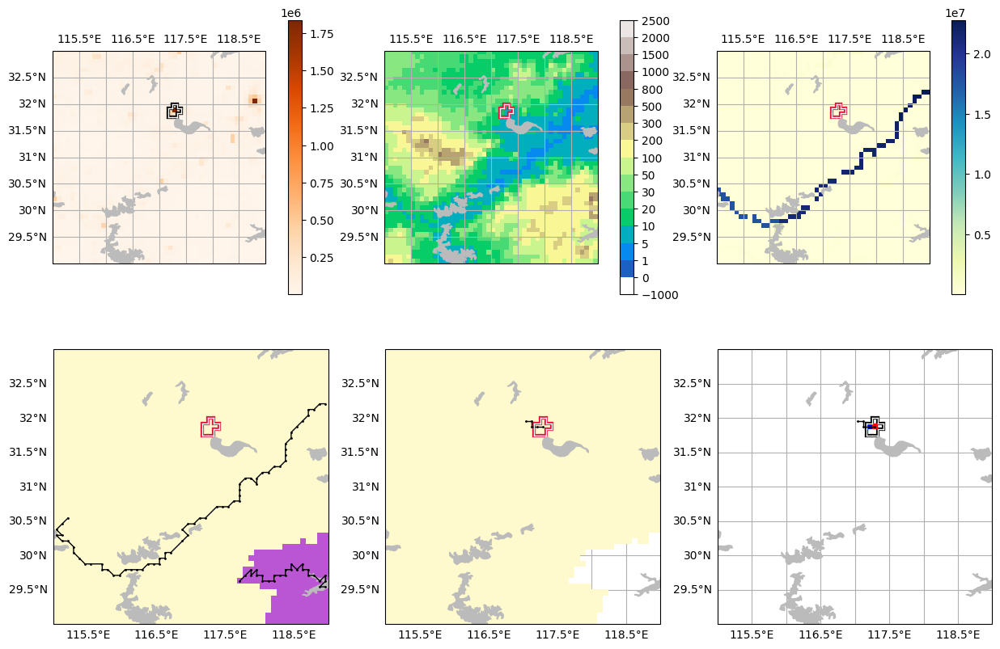

Jaipur


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


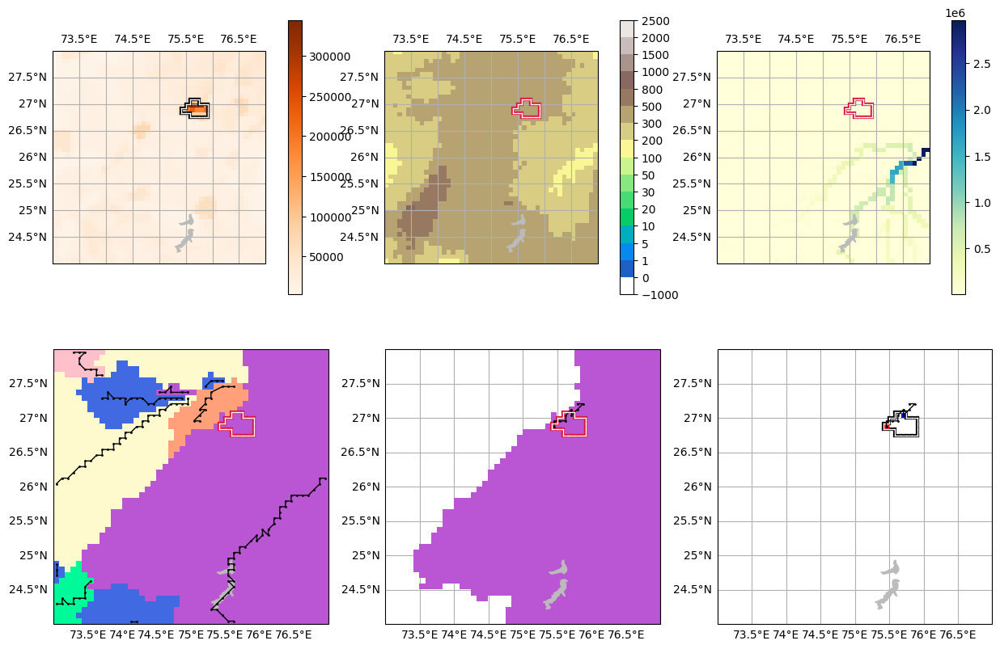

Fuzhou, Fujian


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


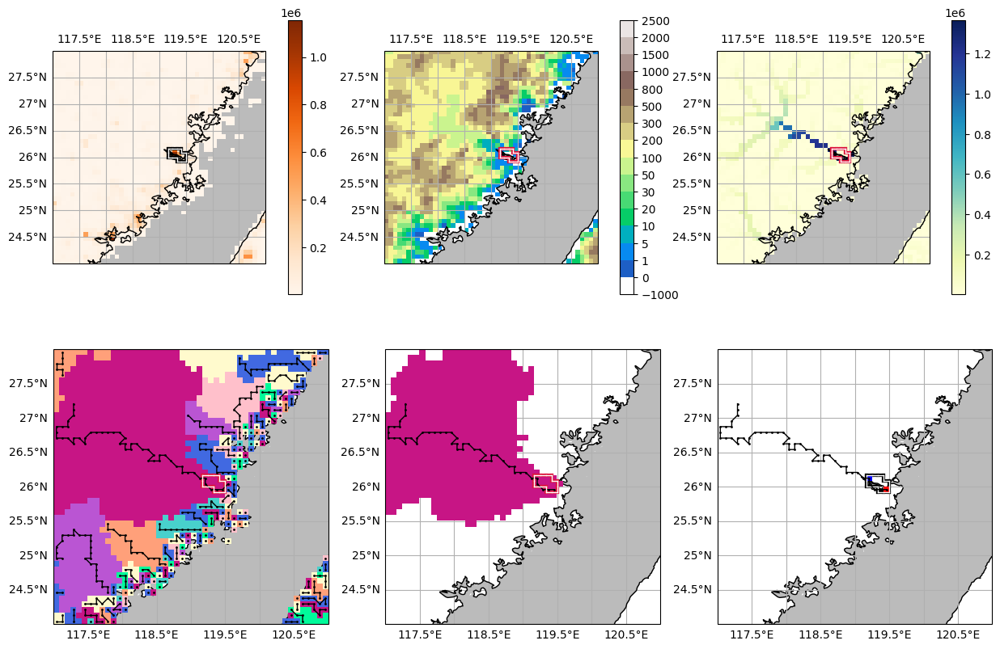

San Diego


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


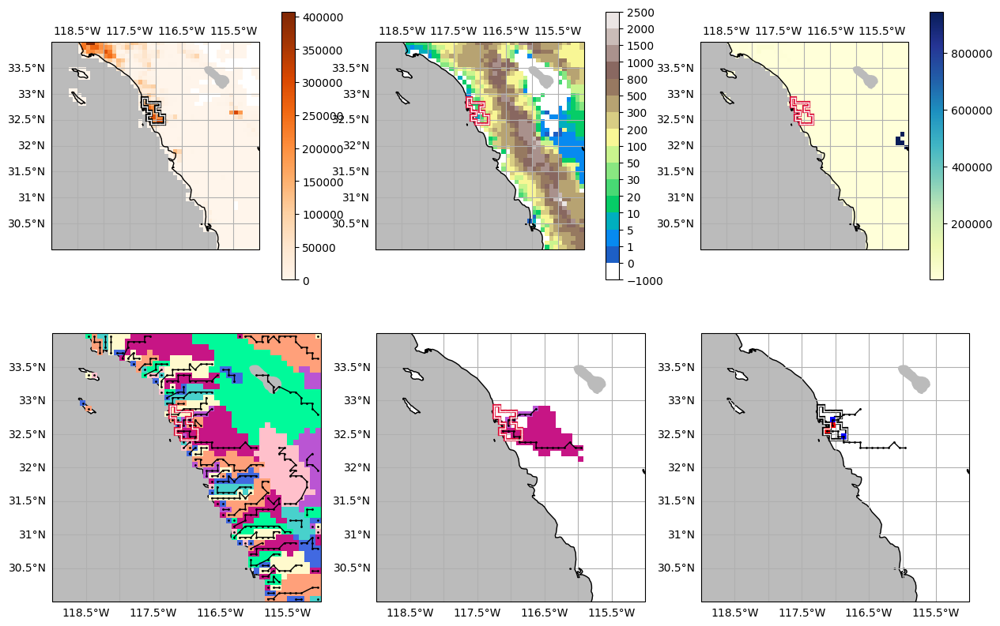

Durban (Ethekwini)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


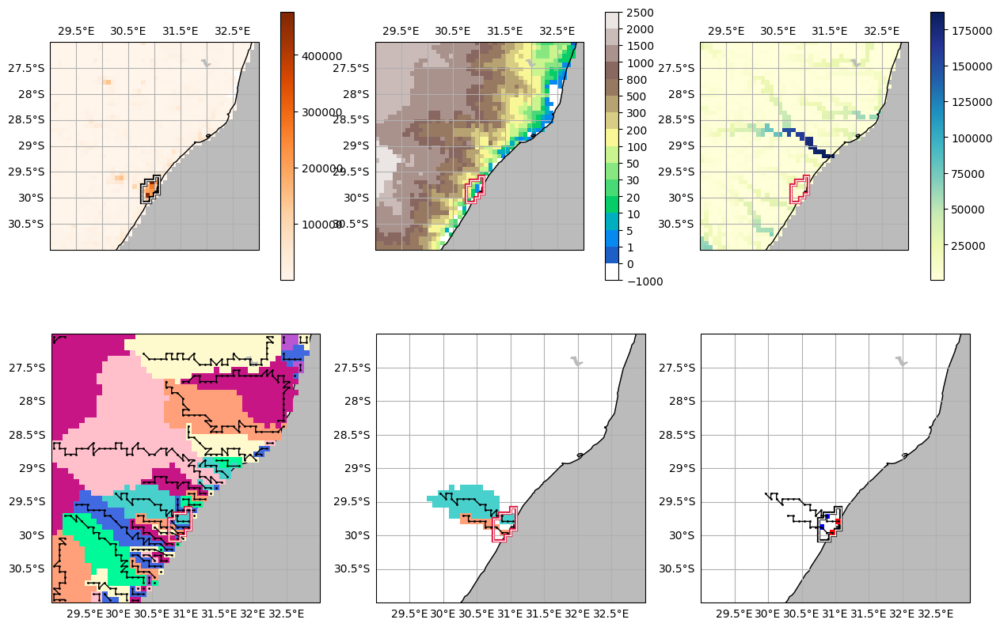

Kanpur


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


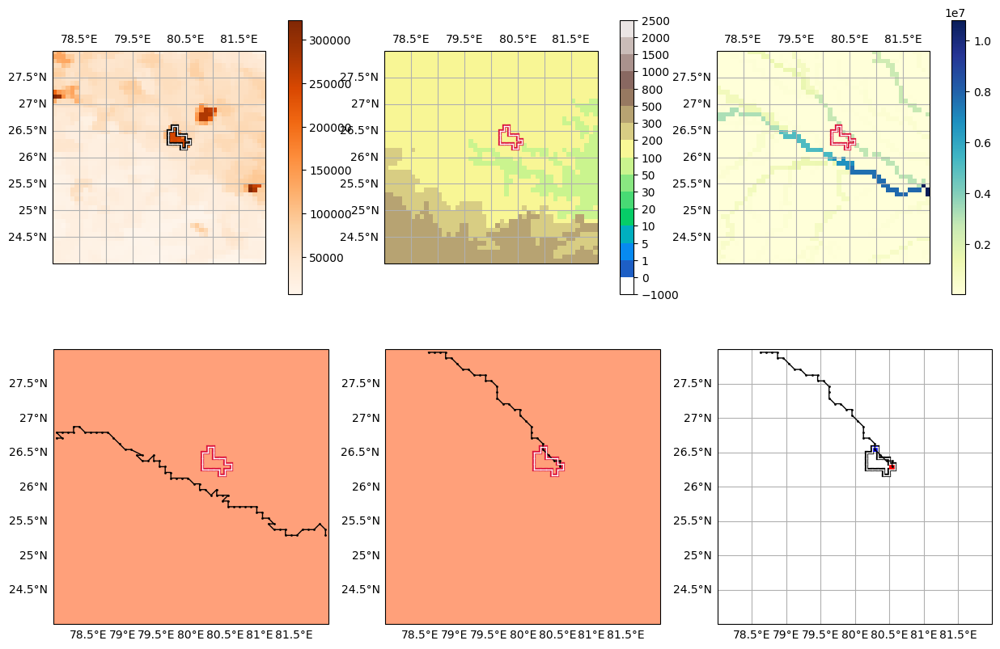

Caracas


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


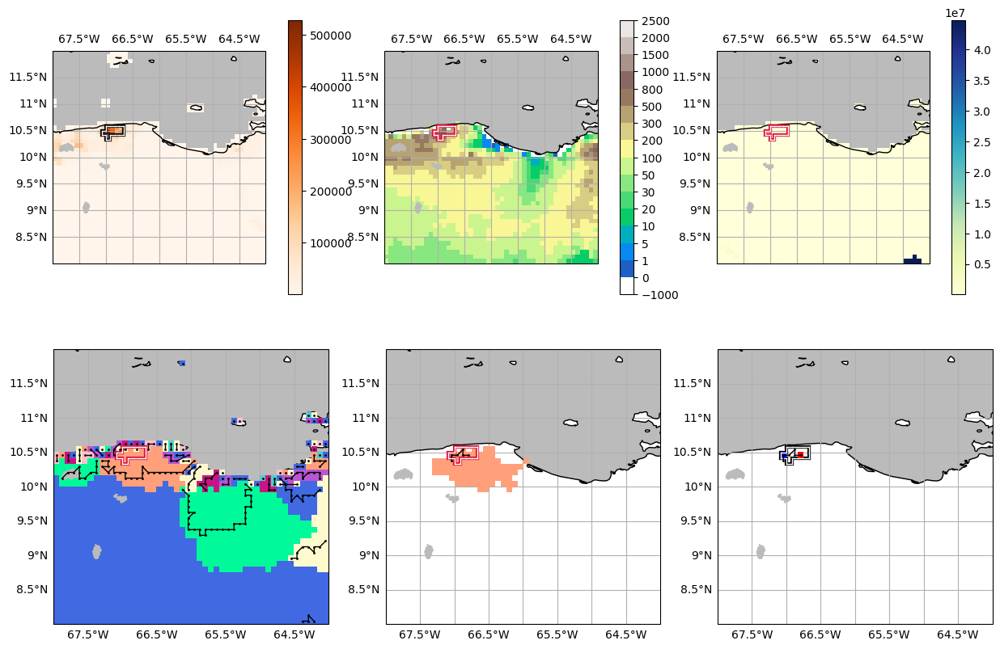

P'yongyang


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


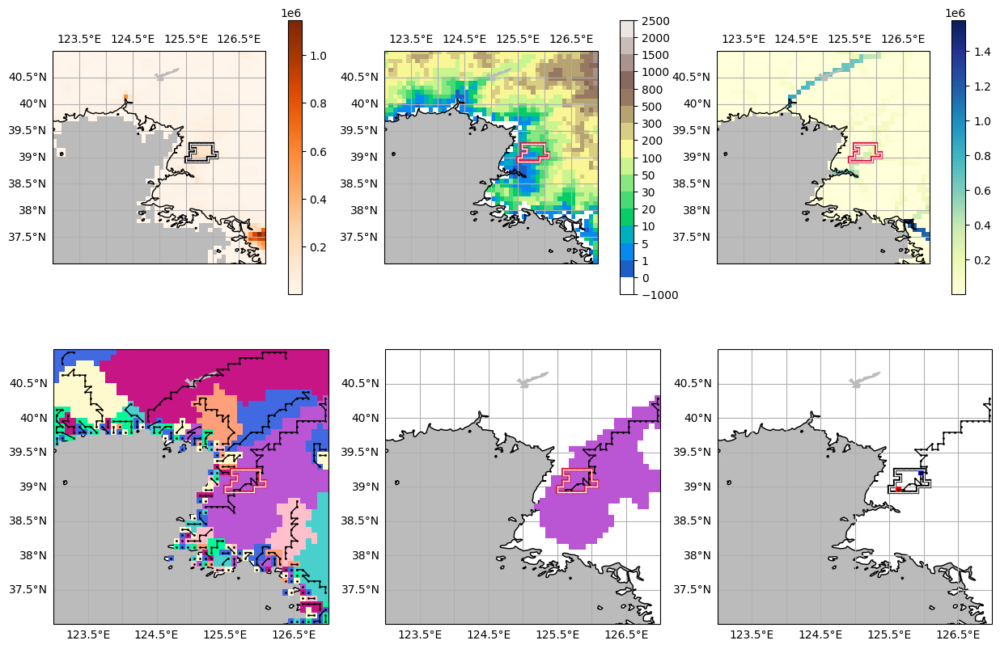

Lucknow


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


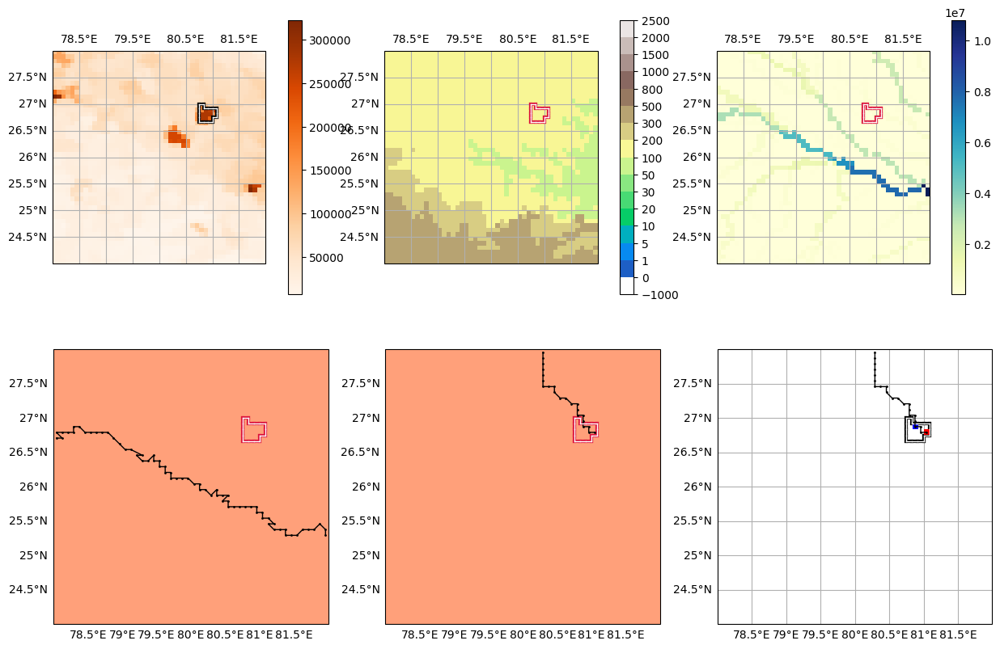

Ibadan


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


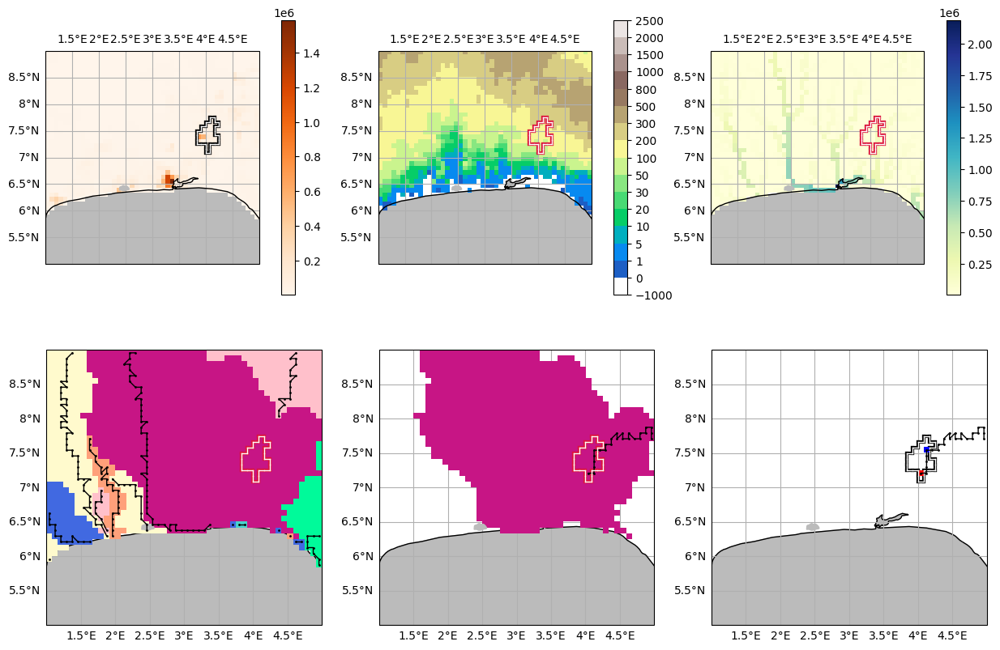

Lisboa (Lisbon)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


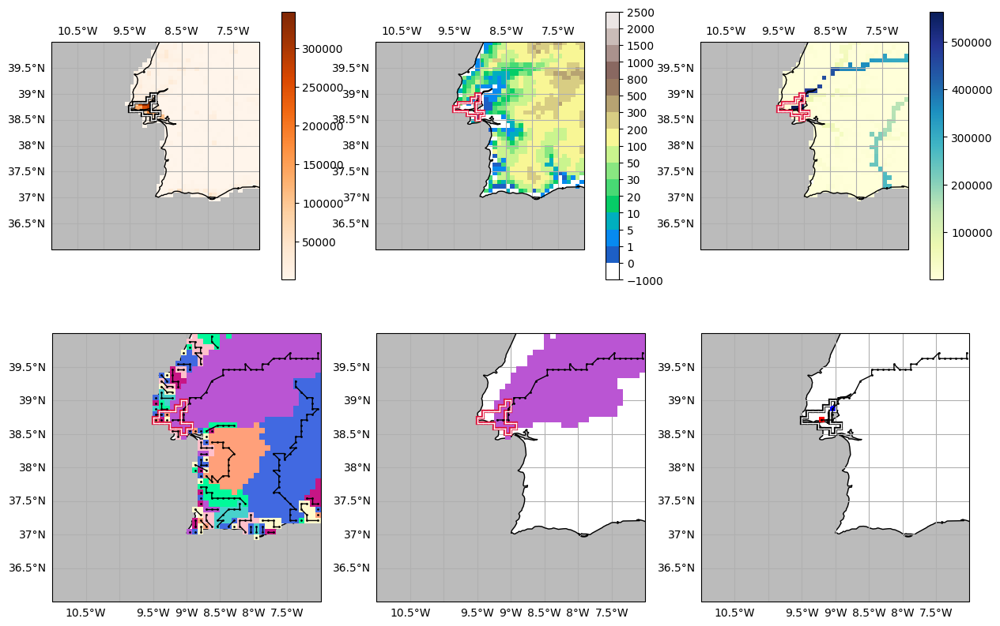

Hà Noi


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


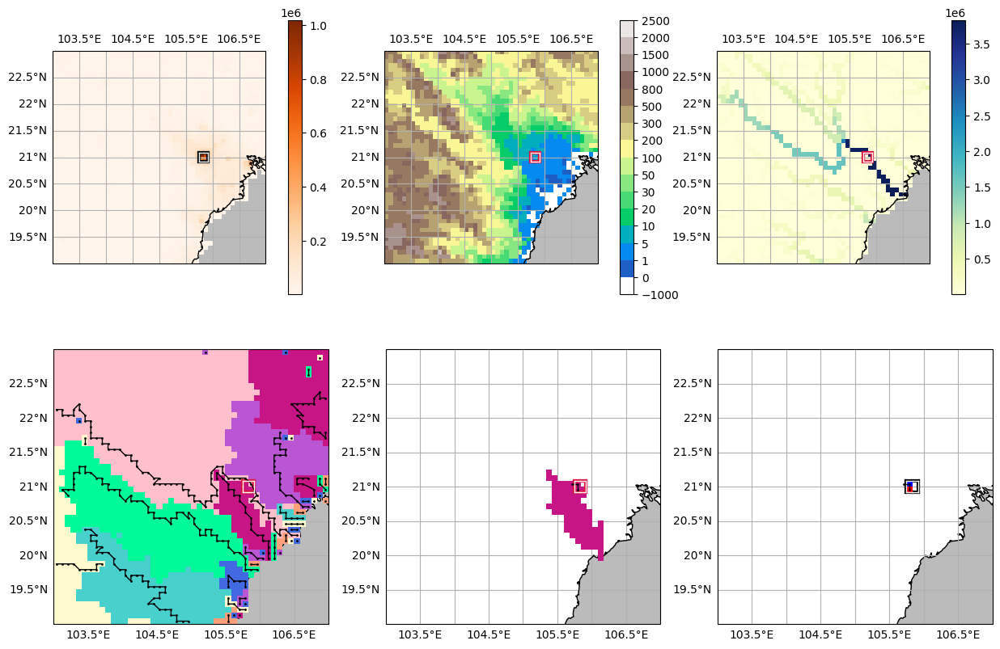

Ürümqi (Wulumqi)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


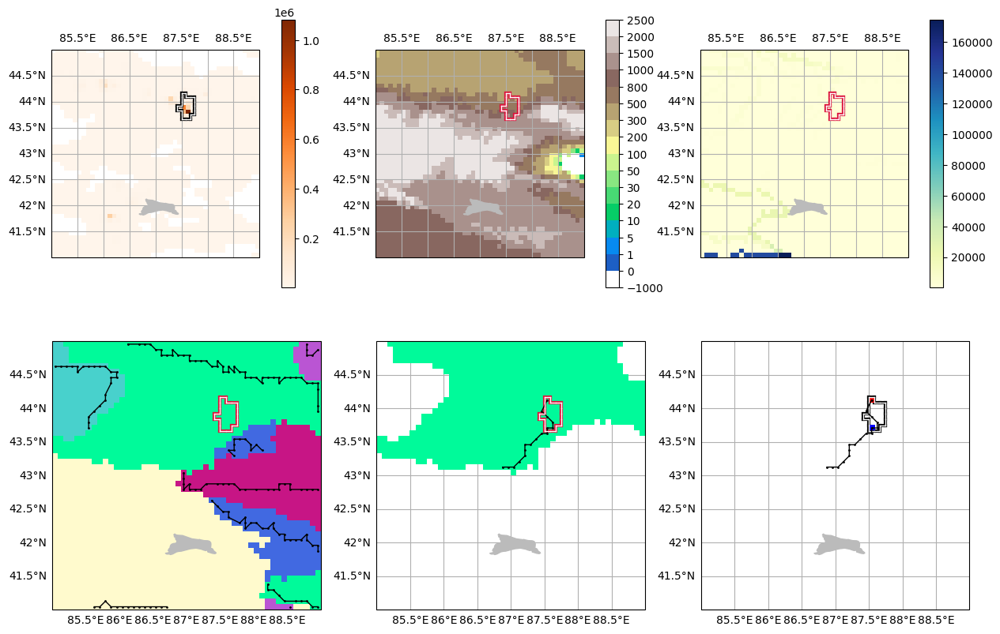

Nanning


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


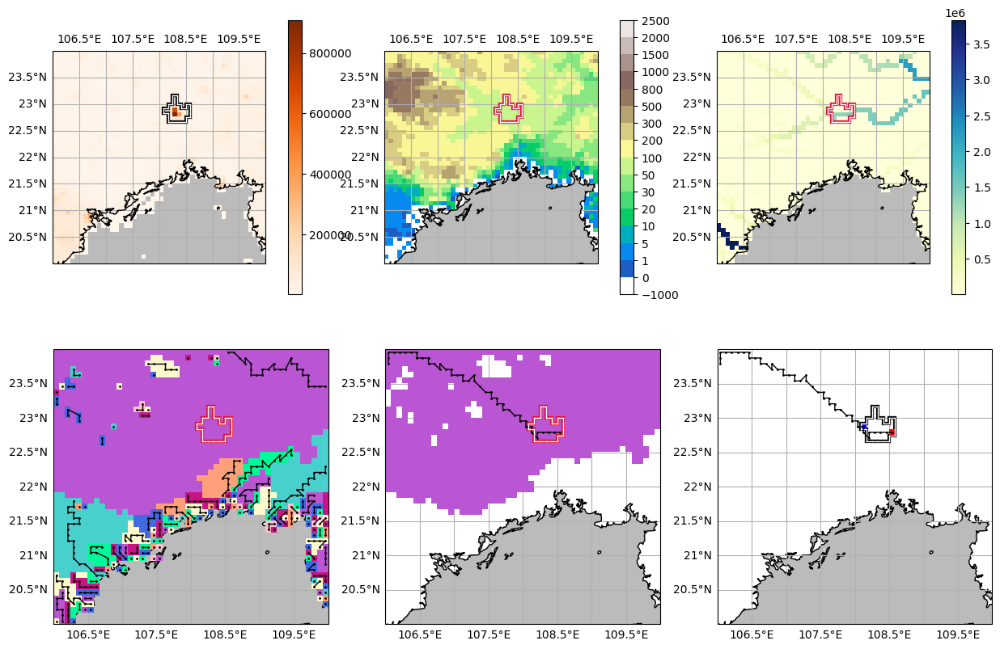

Kyiv (Kiev)


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


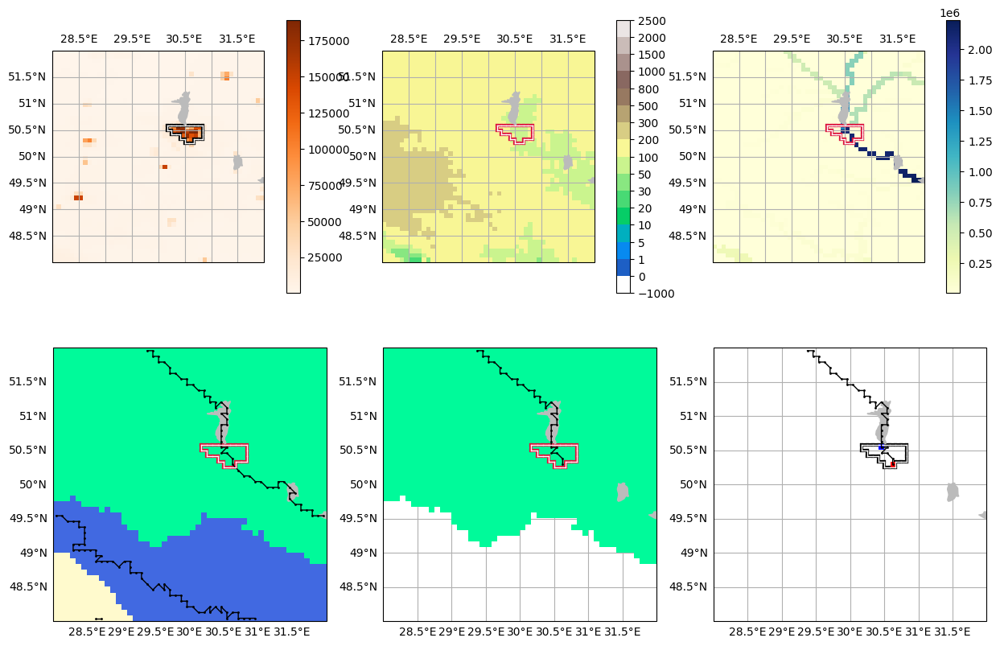

Campinas


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


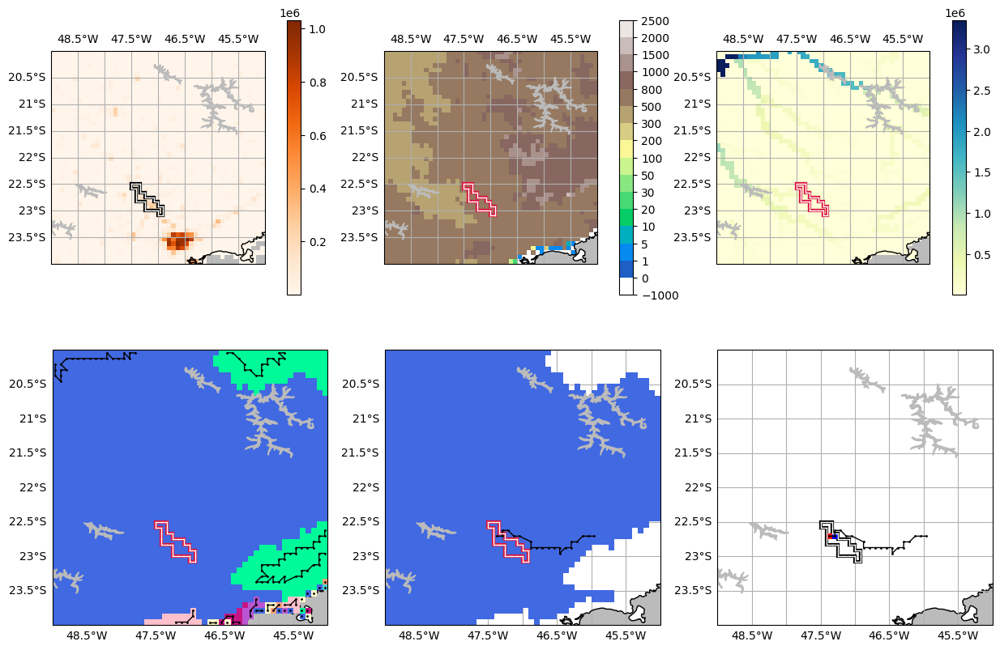

Ningbo


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


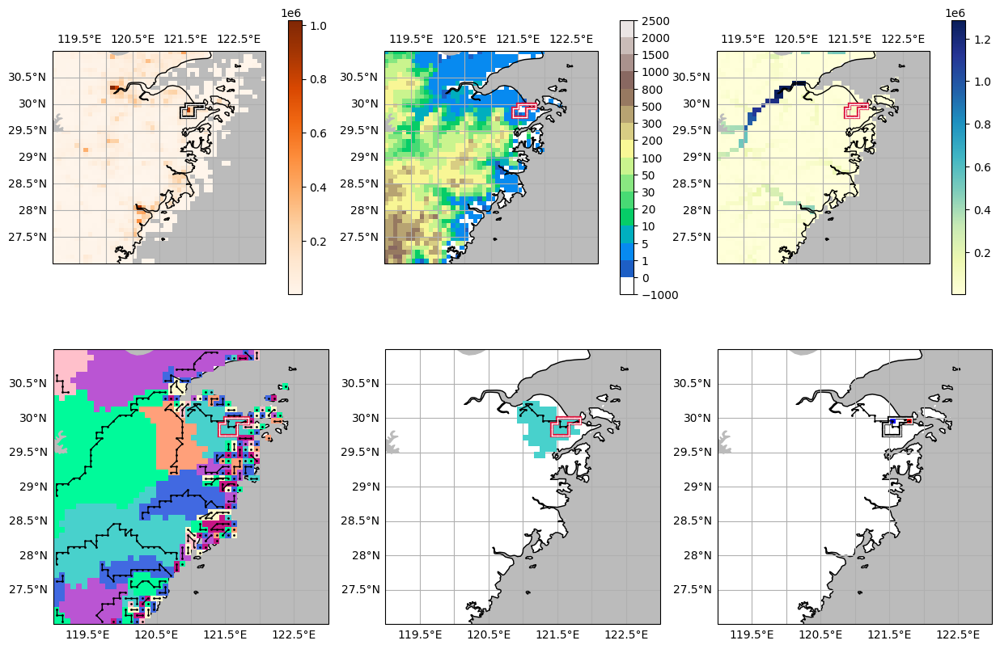

Surabaya


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


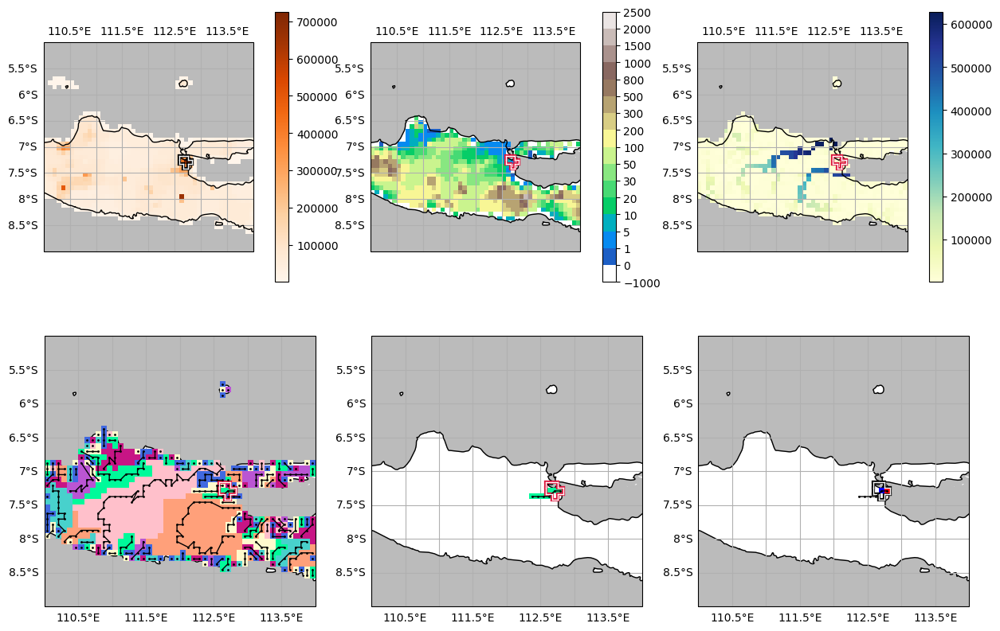

Puebla


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


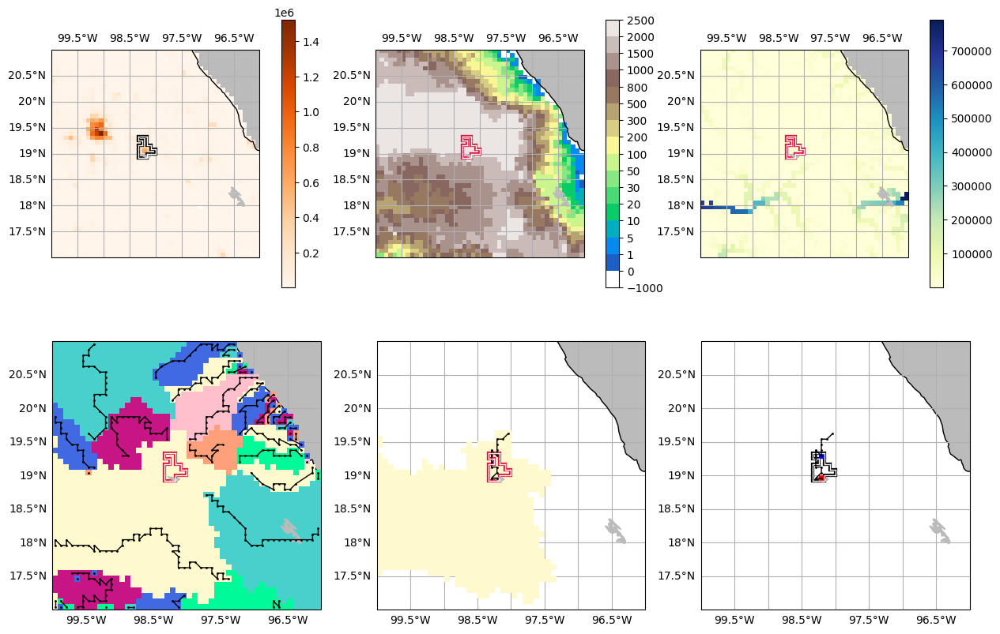

Wuxi, Jiangsu


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


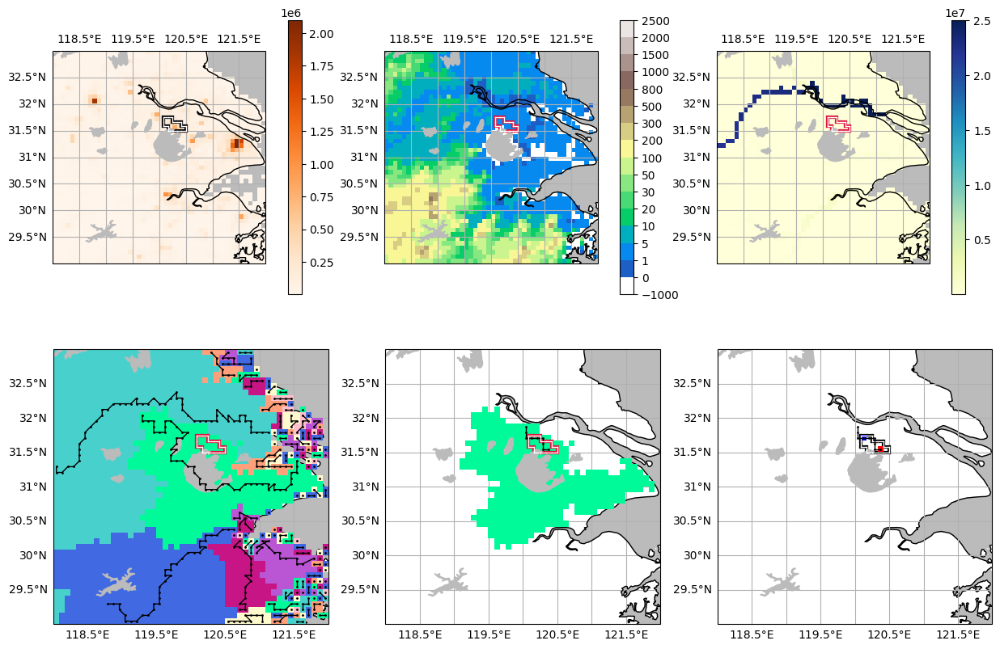

Shizuoka-Hamamatsu M.M.A.


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


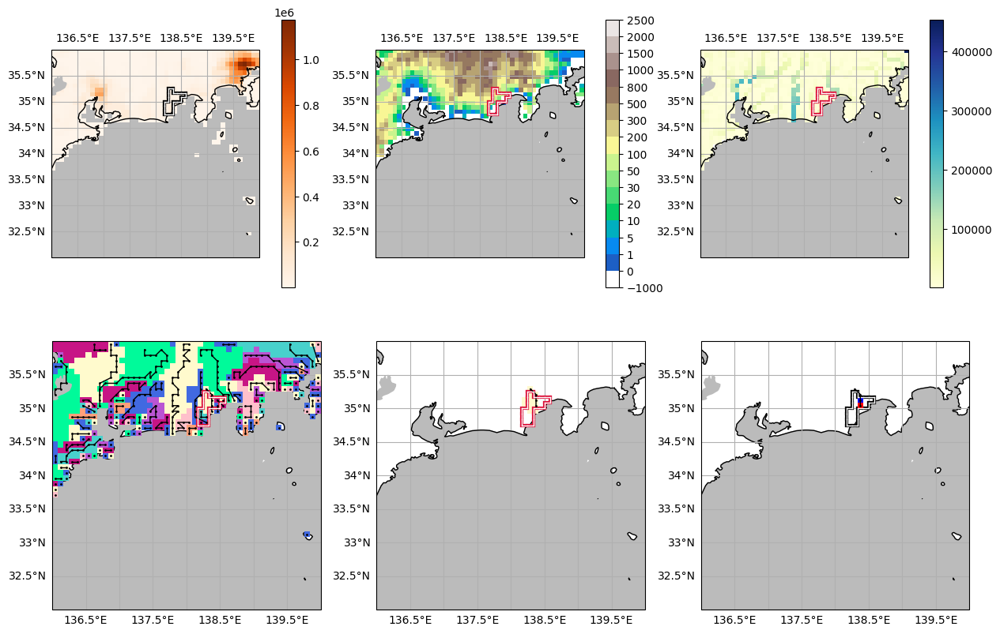

Faisalabad
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


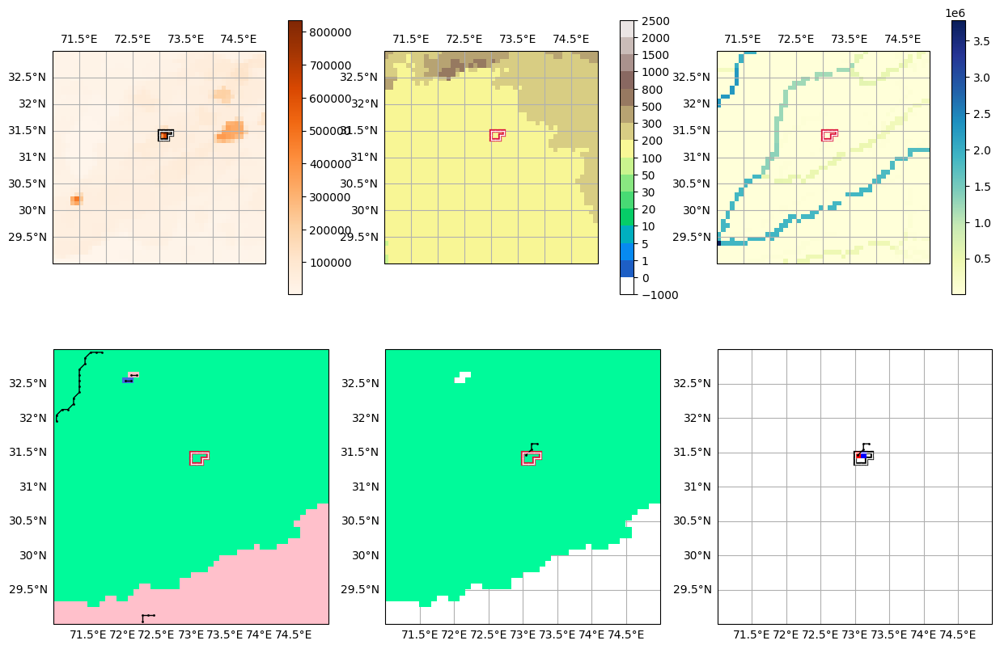

Izmir


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


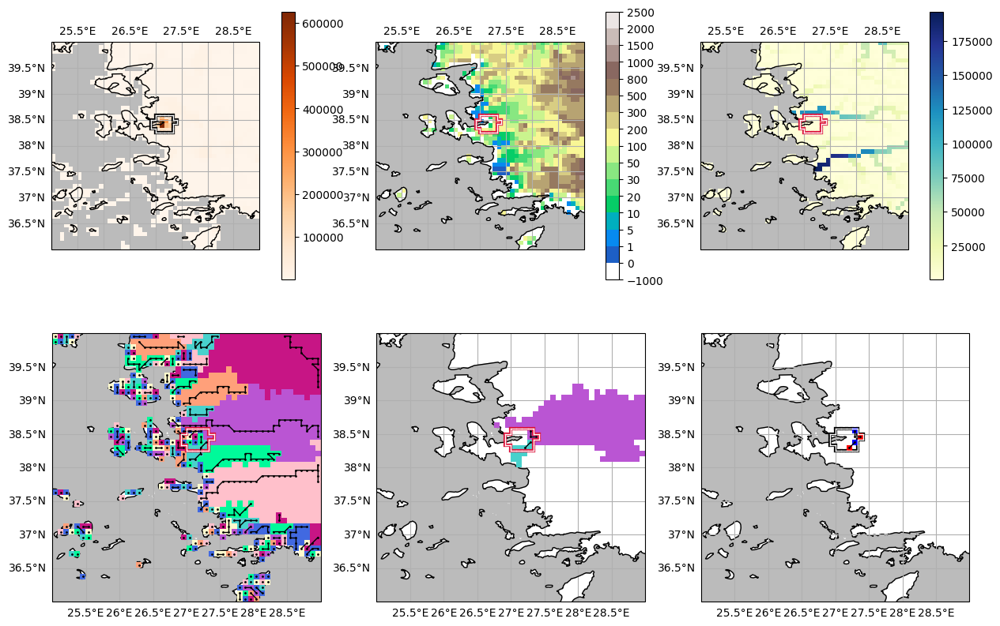

Zhongshan
river over innercity_grid does not exit within city
no purification, eplore_prf is activated


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


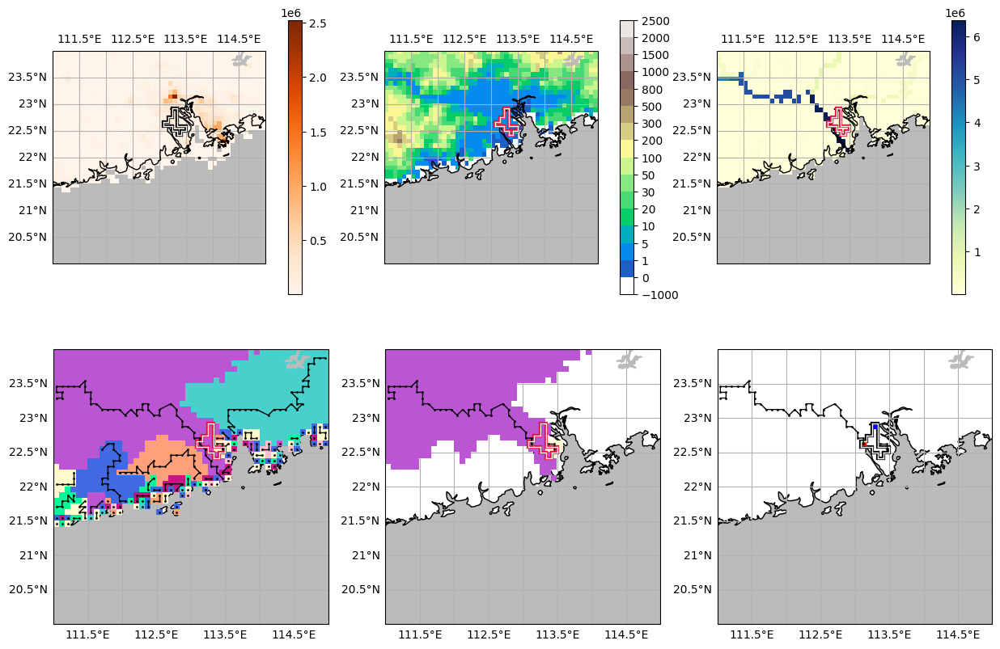

Wenzhou


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


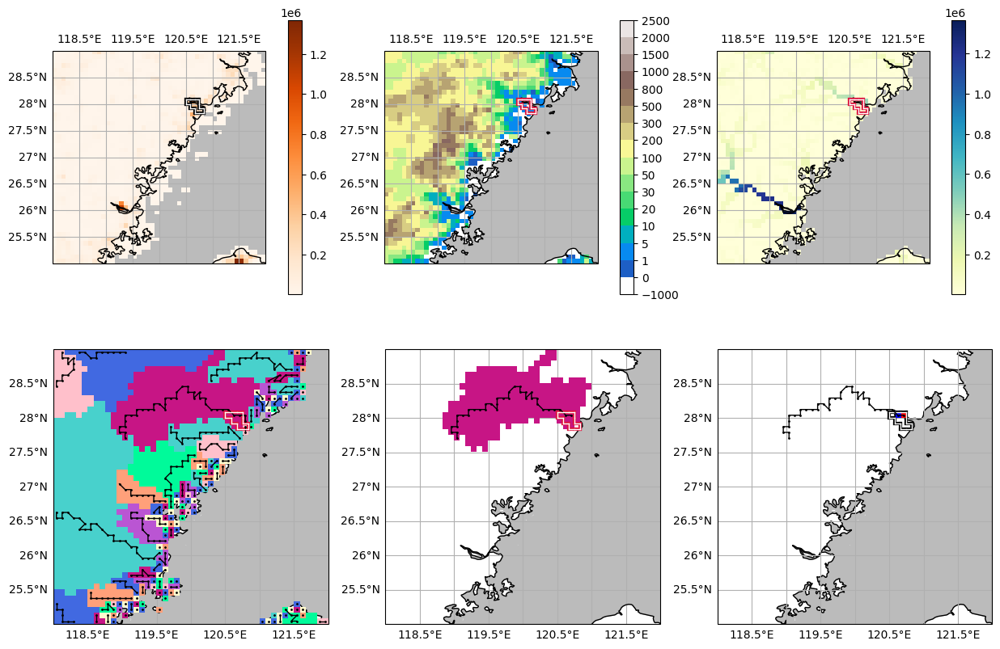

Mashhad


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


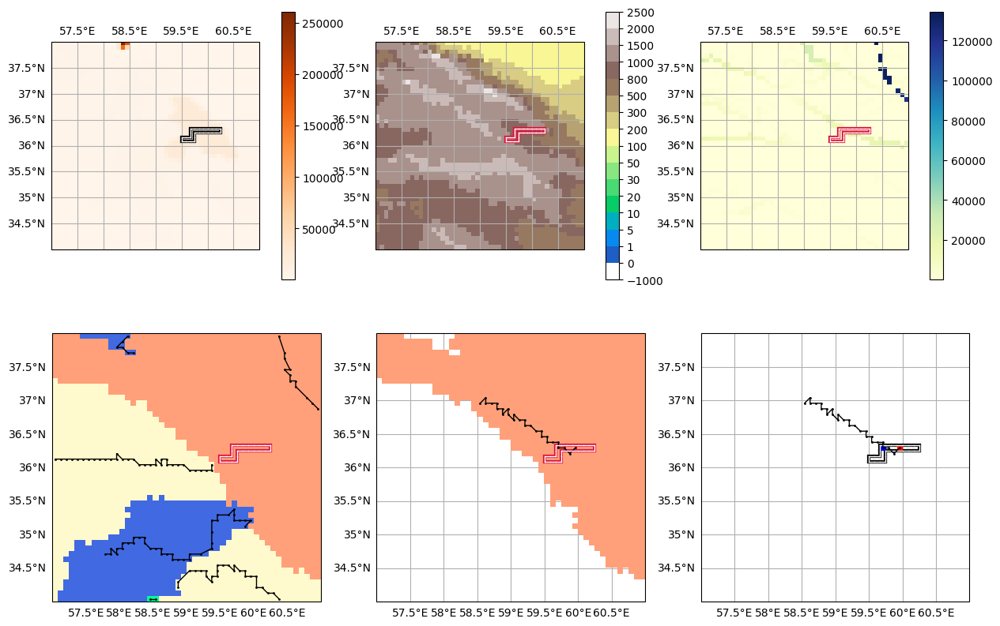

Minneapolis-St. Paul


/tmp/ipykernel_1306/3275049892.py:12: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  terrain = plt.cm.get_cmap('terrain')


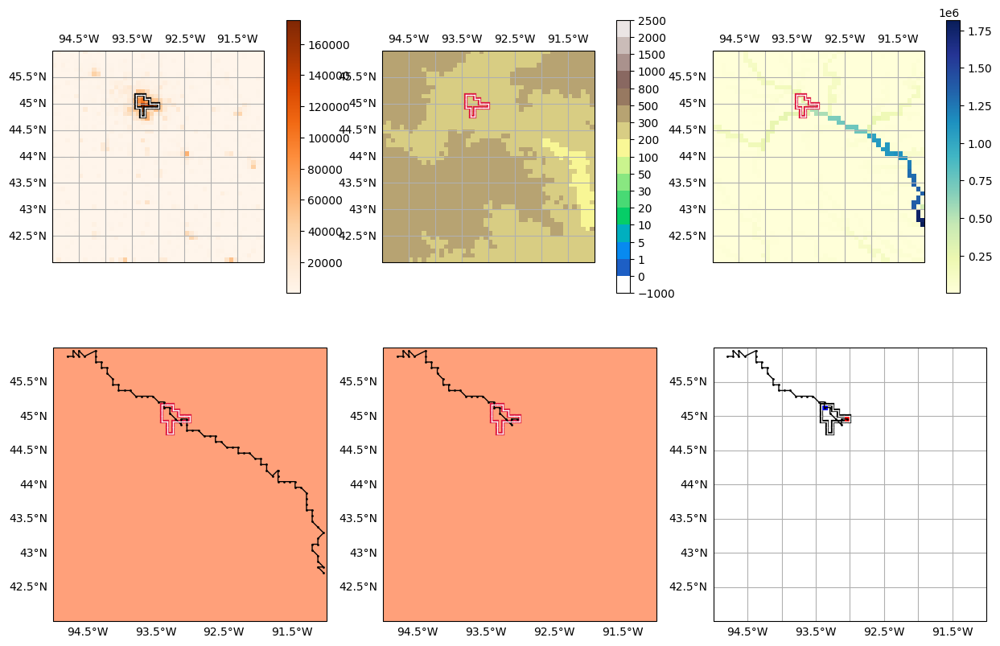

Taibei


FileNotFoundError: [Errno 2] No such file or directory: '/mnt/c/Users/tsimk/Downloads/dotfiles/h08/global_city/dat/vld_cty_//city_00000152.gl5'

In [16]:
for i in range(101, 201):
    snapshot(city_num=i)